# SEAMLESS PHOTOVOLTAIC POWER GENERATION FORECASTING

# Install

In [1]:
pip install dtw-python

Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install fastdtw

Note: you may need to restart the kernel to use updated packages.


In [3]:
pip install gmdh

Note: you may need to restart the kernel to use updated packages.


In [4]:
pip install gmdhpy

Note: you may need to restart the kernel to use updated packages.


# Import

In [5]:
import tarfile
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn import neighbors, datasets, preprocessing
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
import seaborn as sns
from dtw import *
from fastdtw import fastdtw
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
import gmdh
from gmdh import Combi
import gmdhpy
from statsmodels.tsa.api import AutoReg
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.model_selection import TimeSeriesSplit

Importing the dtw module. When using in academic works please cite:
  T. Giorgino. Computing and Visualizing Dynamic Time Warping Alignments in R: The dtw Package.
  J. Stat. Soft., doi:10.18637/jss.v031.i07.



# Get the Data And fill missing values

In [6]:
file="destination_folder/E4Cast-solar/GHI_smooth_20170701-20200630_T0+{}min.csv"
column_name="Sat_GHI_T0+{}"

We have 25 files. One for each time horizon of Satellite prediction. On every 15 minutes for 6 hours.
Each dataset contains exacltly the same values exeplte for the satellite prediction columns. We need to regroup them into one dataset.

First we download each files

In [7]:
list_df_sat=[]
for i in range(0,375,15):
    file_i=file.format(i)
    column_name_i=column_name.format(i)
    df_i=pd.read_csv(file_i,sep=',',header=0,parse_dates=['date'])
    #for each data frame we change the Satellite colomn to specify the prediction time
    df_i=df_i.rename(columns={"Sat_GHI":column_name_i})
    #setting date as the index before mergig the data frames
    df_i.set_index('date', inplace=True)
    #we use interpolate for the missing values
    df_i=df_i.interpolate()
    list_df_sat.append(df_i)

# Merging data frames

Then we merge the files, using the T0+0 files and adding each satelite value to it.

In [8]:
df=list_df_sat[0].copy()
for i in range(1,len(list_df_sat)):
    df=df.merge(list_df_sat[i][[column_name.format(i*15)]], left_index=True, right_index=True, how='outer')


# Missing values

Before starting the predictions we need to deal with the missing values

In [13]:
df[df['Sirta_GHI'].isna()].index.year.value_counts()

date
2018    175
2019    119
2020     24
2017     20
Name: count, dtype: int64

338 rows out of 44000 is not a lot, for now we can drop them.

We may comeback to this decision later and replace the values with other ones (from the day before or the past year)

In [14]:
df.dropna(subset=['Sirta_GHI'], inplace=True)

In [15]:
df.isnull().sum()

Sirta_GHI             0
Sat_GHI_T0+0          0
Clearsky_GHI          0
Arpege_GHI            0
SZA                   0
Kc_Sat_mean           0
Kc_Sat_std            0
Kc_obs                0
Wreg                  0
Sat_GHI_T0+15      1175
Sat_GHI_T0+30      2346
Sat_GHI_T0+45      3435
Sat_GHI_T0+60      4511
Sat_GHI_T0+75      5577
Sat_GHI_T0+90      6638
Sat_GHI_T0+105     7701
Sat_GHI_T0+120     8766
Sat_GHI_T0+135     9831
Sat_GHI_T0+150    10888
Sat_GHI_T0+165    11914
Sat_GHI_T0+180    12944
Sat_GHI_T0+195    14000
Sat_GHI_T0+210    15056
Sat_GHI_T0+225    16115
Sat_GHI_T0+240    17172
Sat_GHI_T0+255    18223
Sat_GHI_T0+270    19264
Sat_GHI_T0+285    20292
Sat_GHI_T0+300    21319
Sat_GHI_T0+315    22352
Sat_GHI_T0+330    23392
Sat_GHI_T0+345    24441
Sat_GHI_T0+360    25493
dtype: int64

Satellite prediction is based on satelittes images of the clouds. Unfortunatly it can not caculate anything during night time. This is why we still have a lot of missing values for each satelite prediction.

To avoid dropping the 6 first hours of each day away we will simply replace each missing values with zero. It may be a good idea to replace it with an other values such as the one from the day before but it may lead to wrong conclusion later.

In [16]:
df.fillna(0, inplace=True)

In [17]:
df.isnull().sum()

Sirta_GHI         0
Sat_GHI_T0+0      0
Clearsky_GHI      0
Arpege_GHI        0
SZA               0
Kc_Sat_mean       0
Kc_Sat_std        0
Kc_obs            0
Wreg              0
Sat_GHI_T0+15     0
Sat_GHI_T0+30     0
Sat_GHI_T0+45     0
Sat_GHI_T0+60     0
Sat_GHI_T0+75     0
Sat_GHI_T0+90     0
Sat_GHI_T0+105    0
Sat_GHI_T0+120    0
Sat_GHI_T0+135    0
Sat_GHI_T0+150    0
Sat_GHI_T0+165    0
Sat_GHI_T0+180    0
Sat_GHI_T0+195    0
Sat_GHI_T0+210    0
Sat_GHI_T0+225    0
Sat_GHI_T0+240    0
Sat_GHI_T0+255    0
Sat_GHI_T0+270    0
Sat_GHI_T0+285    0
Sat_GHI_T0+300    0
Sat_GHI_T0+315    0
Sat_GHI_T0+330    0
Sat_GHI_T0+345    0
Sat_GHI_T0+360    0
dtype: int64

No remaining missing values.

# Wreg binary columns

Wreg are weather regimes, there is four types, the number associated does not make sens in a linear regression for exemple because a Wreg=4 is not closer to 3 than 1.
We are separating it into 4 binary columns so the number does not impact the result.

In [18]:
df = pd.get_dummies(df, columns=['Wreg'], prefix='Wreg')

In [19]:
df.head().T

date,2017-07-01 05:11:00,2017-07-01 05:26:00,2017-07-01 05:41:00,2017-07-01 05:56:00,2017-07-01 06:11:00
Sirta_GHI,12.172667,16.694667,30.220667,46.928667,50.004667
Sat_GHI_T0+0,46.639333,46.641917,34.287182,52.639118,73.049175
Clearsky_GHI,119.292611,156.593875,195.732357,236.267183,277.824905
Arpege_GHI,11.261829,13.609398,18.504805,24.326697,30.14859
SZA,79.702292,77.410452,75.078445,72.711278,70.313885
Kc_Sat_mean,0.389356,0.235036,0.195269,0.267614,0.204141
Kc_Sat_std,0.10003,0.071296,0.036872,0.051194,0.053714
Kc_obs,0.10204,0.106611,0.154398,0.198625,0.179986
Sat_GHI_T0+15,0.0,60.436766,48.905194,37.655484,83.924422
Sat_GHI_T0+30,0.0,0.0,68.602462,64.199038,40.746849


# Sirta 24h before

We decided to had a new column 'Sirta_GHI_T0-1j' that give us information about the real GHI observed 24h before. We can use is to make day-head prediction

In [20]:
df['Sirta_GHI_T0-1j']=df['Sirta_GHI'].shift(1,freq='D')

In [21]:
df.isna().sum()

Sirta_GHI            0
Sat_GHI_T0+0         0
Clearsky_GHI         0
Arpege_GHI           0
SZA                  0
Kc_Sat_mean          0
Kc_Sat_std           0
Kc_obs               0
Sat_GHI_T0+15        0
Sat_GHI_T0+30        0
Sat_GHI_T0+45        0
Sat_GHI_T0+60        0
Sat_GHI_T0+75        0
Sat_GHI_T0+90        0
Sat_GHI_T0+105       0
Sat_GHI_T0+120       0
Sat_GHI_T0+135       0
Sat_GHI_T0+150       0
Sat_GHI_T0+165       0
Sat_GHI_T0+180       0
Sat_GHI_T0+195       0
Sat_GHI_T0+210       0
Sat_GHI_T0+225       0
Sat_GHI_T0+240       0
Sat_GHI_T0+255       0
Sat_GHI_T0+270       0
Sat_GHI_T0+285       0
Sat_GHI_T0+300       0
Sat_GHI_T0+315       0
Sat_GHI_T0+330       0
Sat_GHI_T0+345       0
Sat_GHI_T0+360       0
Wreg_1.0             0
Wreg_2.0             0
Wreg_3.0             0
Wreg_4.0             0
Sirta_GHI_T0-1j    768
dtype: int64

As some time periode are not reprented in the dataset we have 768 missing values. We can use ffill() to fill the missing values using the values from the day before.

In [22]:
df['Sirta_GHI_T0-1j']=df['Sirta_GHI_T0-1j'].ffill()

In [23]:
df.isna().sum()

Sirta_GHI           0
Sat_GHI_T0+0        0
Clearsky_GHI        0
Arpege_GHI          0
SZA                 0
Kc_Sat_mean         0
Kc_Sat_std          0
Kc_obs              0
Sat_GHI_T0+15       0
Sat_GHI_T0+30       0
Sat_GHI_T0+45       0
Sat_GHI_T0+60       0
Sat_GHI_T0+75       0
Sat_GHI_T0+90       0
Sat_GHI_T0+105      0
Sat_GHI_T0+120      0
Sat_GHI_T0+135      0
Sat_GHI_T0+150      0
Sat_GHI_T0+165      0
Sat_GHI_T0+180      0
Sat_GHI_T0+195      0
Sat_GHI_T0+210      0
Sat_GHI_T0+225      0
Sat_GHI_T0+240      0
Sat_GHI_T0+255      0
Sat_GHI_T0+270      0
Sat_GHI_T0+285      0
Sat_GHI_T0+300      0
Sat_GHI_T0+315      0
Sat_GHI_T0+330      0
Sat_GHI_T0+345      0
Sat_GHI_T0+360      0
Wreg_1.0            0
Wreg_2.0            0
Wreg_3.0            0
Wreg_4.0            0
Sirta_GHI_T0-1j    57
dtype: int64

57 missing values, this correpond well at the number of values by day.

In [24]:
df.fillna(0, inplace=True)

In [25]:
df.isna().sum()

Sirta_GHI          0
Sat_GHI_T0+0       0
Clearsky_GHI       0
Arpege_GHI         0
SZA                0
Kc_Sat_mean        0
Kc_Sat_std         0
Kc_obs             0
Sat_GHI_T0+15      0
Sat_GHI_T0+30      0
Sat_GHI_T0+45      0
Sat_GHI_T0+60      0
Sat_GHI_T0+75      0
Sat_GHI_T0+90      0
Sat_GHI_T0+105     0
Sat_GHI_T0+120     0
Sat_GHI_T0+135     0
Sat_GHI_T0+150     0
Sat_GHI_T0+165     0
Sat_GHI_T0+180     0
Sat_GHI_T0+195     0
Sat_GHI_T0+210     0
Sat_GHI_T0+225     0
Sat_GHI_T0+240     0
Sat_GHI_T0+255     0
Sat_GHI_T0+270     0
Sat_GHI_T0+285     0
Sat_GHI_T0+300     0
Sat_GHI_T0+315     0
Sat_GHI_T0+330     0
Sat_GHI_T0+345     0
Sat_GHI_T0+360     0
Wreg_1.0           0
Wreg_2.0           0
Wreg_3.0           0
Wreg_4.0           0
Sirta_GHI_T0-1j    0
dtype: int64

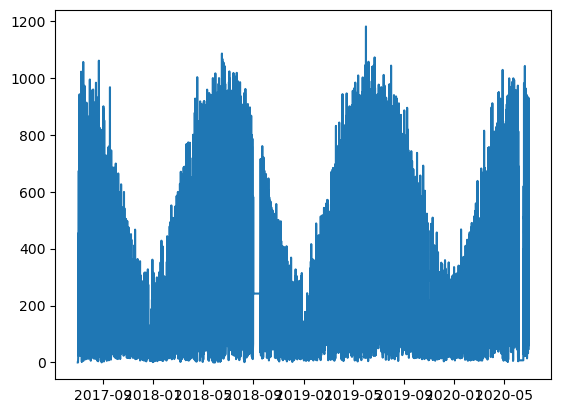

In [26]:
plt.plot(df.index, df['Sirta_GHI_T0-1j'], label='Sirta_GHI_T0-1j')

## Season and  Month

In [29]:
df['Year'] = df.index.year
df['Month'] = df.index.month
df['Season'] = (df.index.month%12+3)//3
mean_by_year_month = df.groupby(['Year', 'Month'])['Sirta_GHI'].mean()
mean_by_year_season = df.groupby(['Year', 'Season'])['Sirta_GHI'].mean()

<Figure size 1200x600 with 0 Axes>

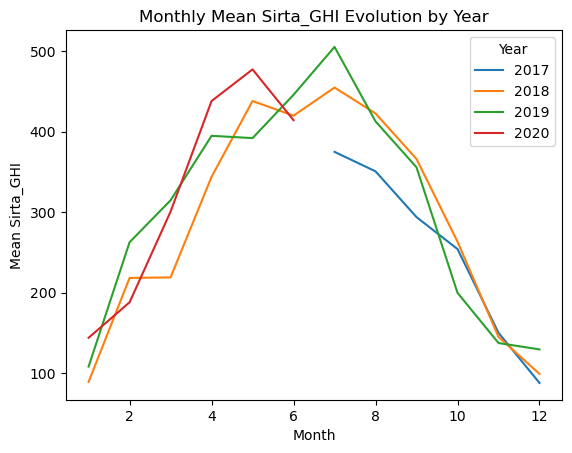

In [30]:
mean_by_year_month = df.groupby(['Year', 'Month'])['Sirta_GHI'].mean()
pivot_data = mean_by_year_month.unstack()
plt.figure(figsize=(12, 6))
pivot_data.T.plot(legend=True)
plt.title('Monthly Mean Sirta_GHI Evolution by Year')
plt.xlabel('Month')
plt.ylabel('Mean Sirta_GHI')
plt.show()

<Figure size 1200x600 with 0 Axes>

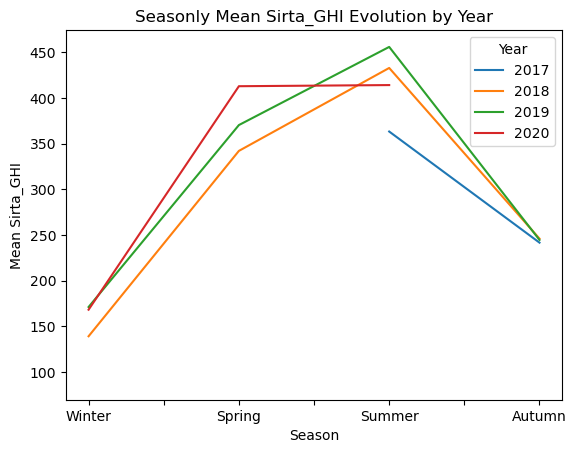

In [31]:
mean_by_year_season = df.groupby(['Year', 'Season'])['Sirta_GHI'].mean()
pivot_data = mean_by_year_season.unstack()
season_mapping = {1:'Winter', 2:'Spring', 3:'Summer', 4:'Autumn'}
pivot_data.columns = pivot_data.columns.map(season_mapping)
plt.figure(figsize=(12, 6))
pivot_data.T.plot(legend=True)
plt.title('Seasonly Mean Sirta_GHI Evolution by Year')
plt.xlabel('Season')
plt.ylabel('Mean Sirta_GHI')
plt.show()

In [32]:
df.drop('Year',axis=1,inplace=True)

For season we will do the same thing we did for Wreg so that the algorithm does not assume that Winter and Autumn are far away.

In [33]:
df=pd.get_dummies(df, columns=['Season'], prefix='Season')
df.rename(columns={'Season_1': 'Season_Winter', 'Season_2': 'Season_Spring', 'Season_3': 'Season_Summer', 'Season_4': 'Season_Autumn'}, inplace=True)

In [34]:
df.T

date,2017-07-01 05:11:00,2017-07-01 05:26:00,2017-07-01 05:41:00,2017-07-01 05:56:00,2017-07-01 06:11:00,2017-07-01 06:26:00,2017-07-01 06:41:00,2017-07-01 06:56:00,2017-07-01 07:11:00,2017-07-01 07:26:00,...,2020-06-30 16:56:00,2020-06-30 17:11:00,2020-06-30 17:26:00,2020-06-30 17:41:00,2020-06-30 17:56:00,2020-06-30 18:11:00,2020-06-30 18:26:00,2020-06-30 18:41:00,2020-06-30 18:56:00,2020-06-30 19:11:00
Sirta_GHI,12.172667,16.694667,30.220667,46.928667,50.004667,34.997333,41.199333,44.598,92.186,175.05,...,111.949333,119.014,99.492,85.366667,70.674,105.317333,193.562667,100.916667,67.522667,48.252667
Sat_GHI_T0+0,46.639333,46.641917,34.287182,52.639118,73.049175,62.177591,64.840267,83.421182,107.309084,143.616315,...,153.48438,149.26174,142.383254,117.362393,93.089357,110.366861,145.358405,142.315518,97.669254,51.93973
Clearsky_GHI,119.292611,156.593875,195.732357,236.267183,277.824905,320.073178,362.706751,405.439656,448.000751,490.131181,...,431.151339,388.75437,346.286857,304.028984,262.277318,221.350095,181.596414,143.412732,107.27399,73.796978
Arpege_GHI,11.261829,13.609398,18.504805,24.326697,30.14859,35.970482,36.296008,35.247443,34.198877,33.150312,...,290.609797,257.332435,224.055074,195.306949,168.205819,141.104689,114.003559,89.045628,64.623497,40.201366
SZA,79.702292,77.410452,75.078445,72.711278,70.313885,67.891181,65.448112,62.989726,60.521246,58.048164,...,63.296653,65.754232,68.195807,70.616356,73.010947,75.374674,77.702599,79.989712,82.230881,84.42083
Kc_Sat_mean,0.389356,0.235036,0.195269,0.267614,0.204141,0.177668,0.214748,0.258431,0.268668,0.367077,...,0.368583,0.365116,0.363959,0.352041,0.364558,0.554589,0.904981,0.860305,0.716394,0.754391
Kc_Sat_std,0.10003,0.071296,0.036872,0.051194,0.053714,0.030814,0.034115,0.045817,0.035159,0.075426,...,0.045472,0.030054,0.03622,0.032519,0.035629,0.115206,0.113562,0.135666,0.096471,0.166124
Kc_obs,0.10204,0.106611,0.154398,0.198625,0.179986,0.109342,0.113589,0.109999,0.205772,0.357149,...,0.259652,0.306142,0.287311,0.280785,0.269463,0.475795,1.065895,0.70368,0.629441,0.653857
Sat_GHI_T0+15,0.0,60.436766,48.905194,37.655484,83.924422,64.853683,66.698877,79.173514,110.696204,159.032418,...,139.514968,135.614082,129.599289,118.150472,93.904655,105.263515,116.327328,112.521938,83.699112,51.668222
Sat_GHI_T0+30,0.0,0.0,68.602462,64.199038,40.746849,81.115239,64.032298,76.976899,123.61917,174.290443,...,143.146325,130.025181,116.683907,109.846159,98.986113,117.650883,116.233687,80.869152,55.316036,36.821135


We will not do the same for the month because we would loose to much information about the correlations between following months.

# Data info

Now we have all of the data we need, let's look at it more closely.

In [35]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Sirta_GHI,44539.0,323.375591,253.637674,-3.400000e-02,105.623667,255.550667,496.623333,1180.468000
Sat_GHI_T0+0,44539.0,309.087118,236.210944,5.210791e+00,106.707728,244.188805,472.150037,950.905602
Clearsky_GHI,44539.0,461.136420,247.727558,4.096680e+01,255.283408,426.517783,667.999067,945.175782
Arpege_GHI,44539.0,319.327716,253.172452,1.035075e-01,95.463566,257.857805,508.696243,927.282119
SZA,44539.0,60.273481,15.921959,2.528530e+01,48.140464,63.334046,73.180437,86.189278
Kc_Sat_mean,44539.0,0.652954,0.290575,9.000000e-02,0.391059,0.720143,0.932360,1.200000
Kc_Sat_std,44539.0,0.073646,0.062161,1.387779e-17,0.025395,0.052835,0.104316,0.490061
Kc_obs,44539.0,0.668118,0.328968,-5.831726e-04,0.366867,0.709375,0.981526,2.158090
Sat_GHI_T0+15,44539.0,306.645529,239.544173,0.000000e+00,103.217725,242.710514,472.312473,1057.130501
Sat_GHI_T0+30,44539.0,303.658439,242.656866,0.000000e+00,98.380918,241.395536,470.849316,1065.052469


# S2-New Inputs

## Using Season and Month info

In [37]:
from utiles import *
from graph import *

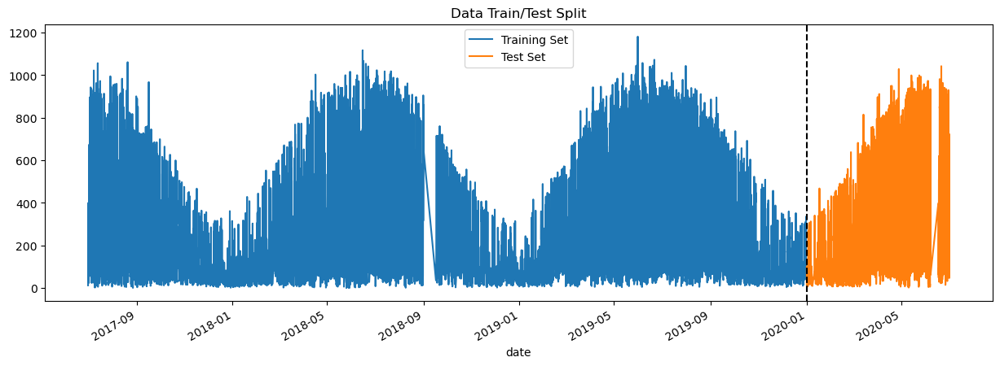

In [38]:
df_train_sm = df.loc[df.index<'01-01-2020'][columns_selection([360],dates=True)]
df_test_sm = df.loc[df.index >= '01-01-2020'][columns_selection([360],dates=True)]
fig, ax = plt.subplots(figsize=(15, 5))
df_train_sm['Sirta_GHI'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
df_test_sm['Sirta_GHI'].plot(ax=ax, label='Test Set')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

In [39]:
df_train_sm.columns

Index(['Sirta_GHI', 'Clearsky_GHI', 'Arpege_GHI', 'SZA', 'Wreg_1.0',
       'Wreg_2.0', 'Wreg_3.0', 'Wreg_4.0', 'Sirta_GHI_T0-1j', 'Month',
       'Season_Winter', 'Season_Spring', 'Season_Summer', 'Season_Autumn',
       'Sat_GHI_T0+360'],
      dtype='object')

RandomForestRegressor()
MSE: 14050.005786254169
MAE: 80.4221717776965
R-squared: 0.7986506395090897
Distance DTW: 345944.83228633506


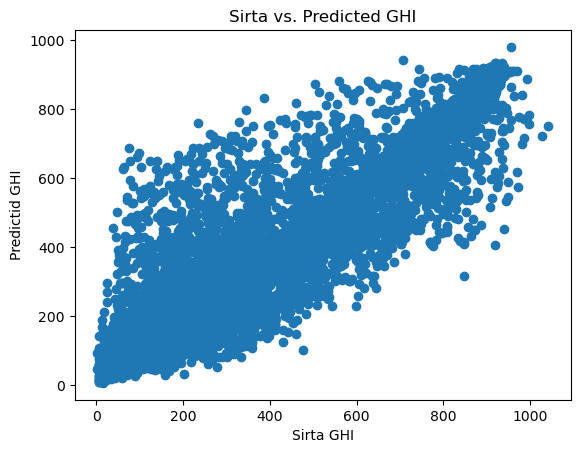

In [35]:
rfm=RandomForestRegressor()
data_rfm=model_fit_prediction(df_train_sm,df_test_sm,rfm)
evaluate_algo(rfm,data_rfm[3],data_rfm[4])
scatter_test_pred(data_rfm[3],data_rfm[4])

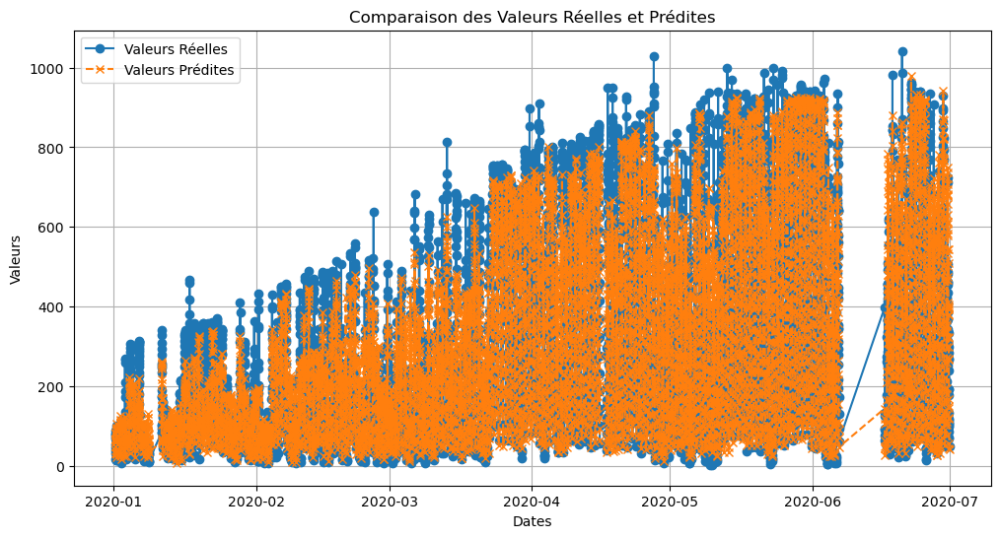

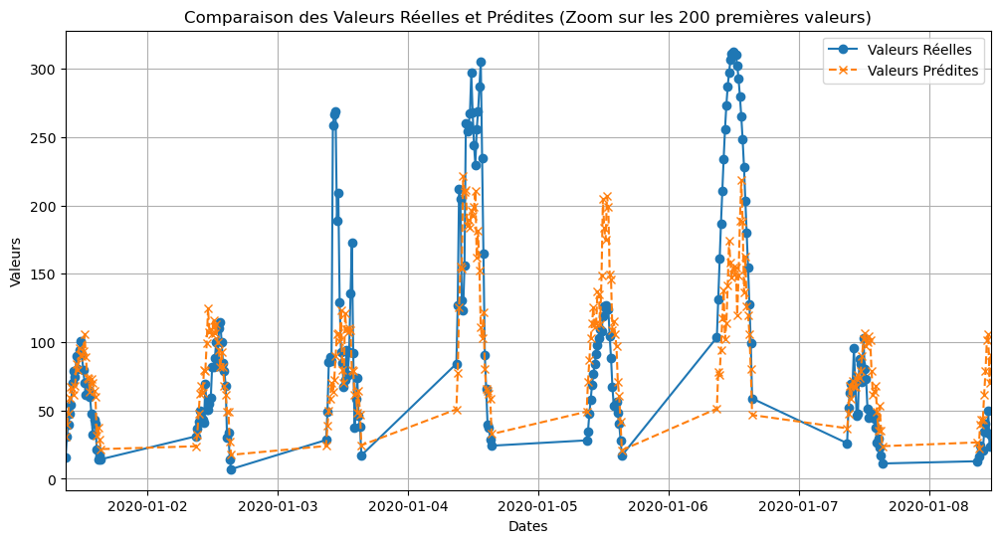

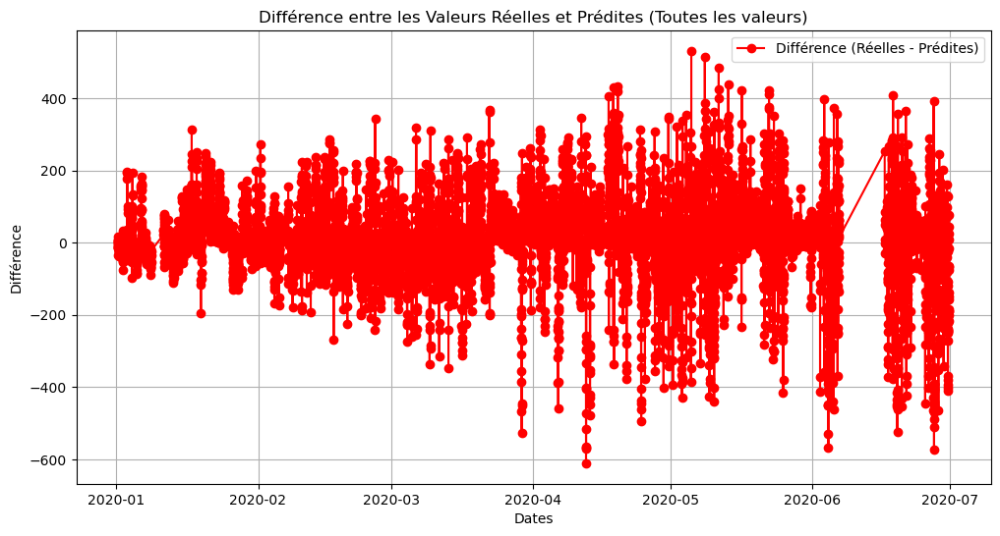

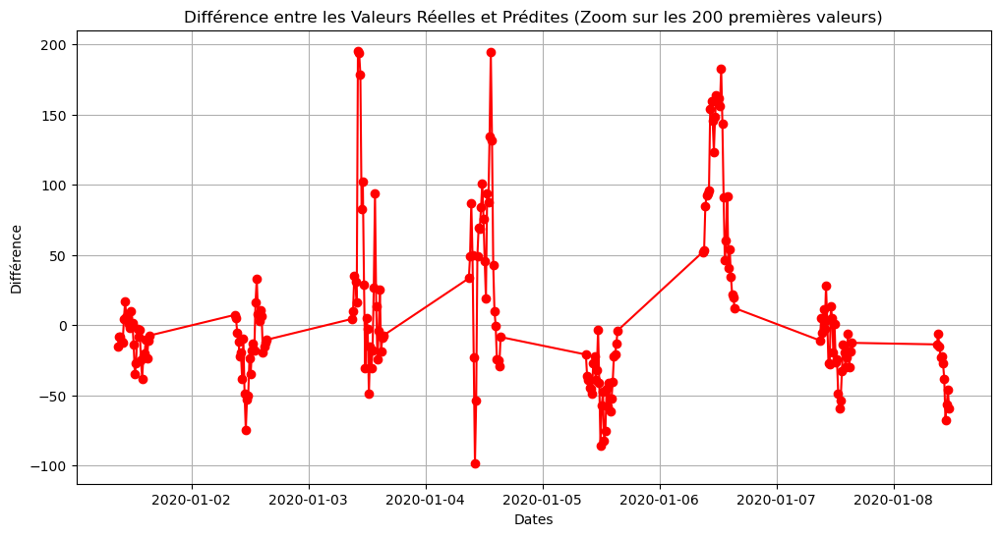

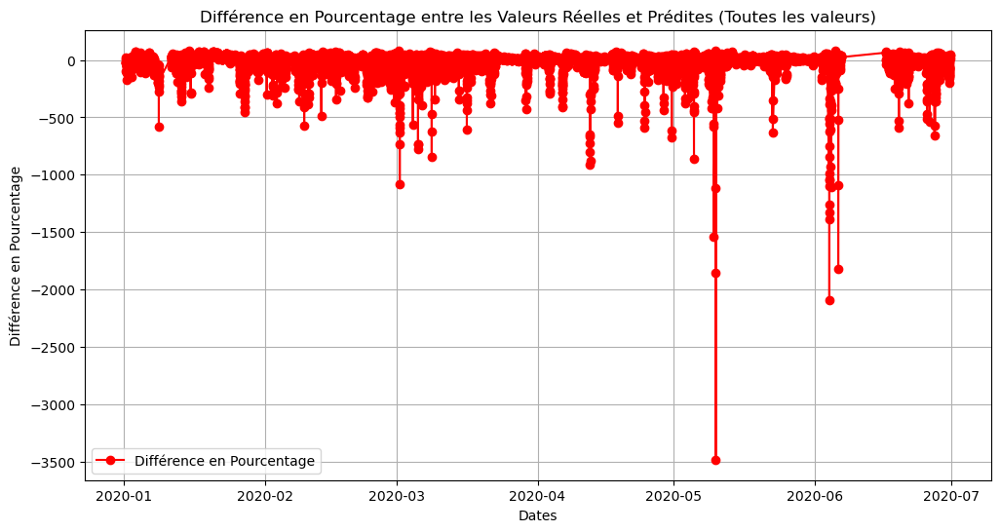

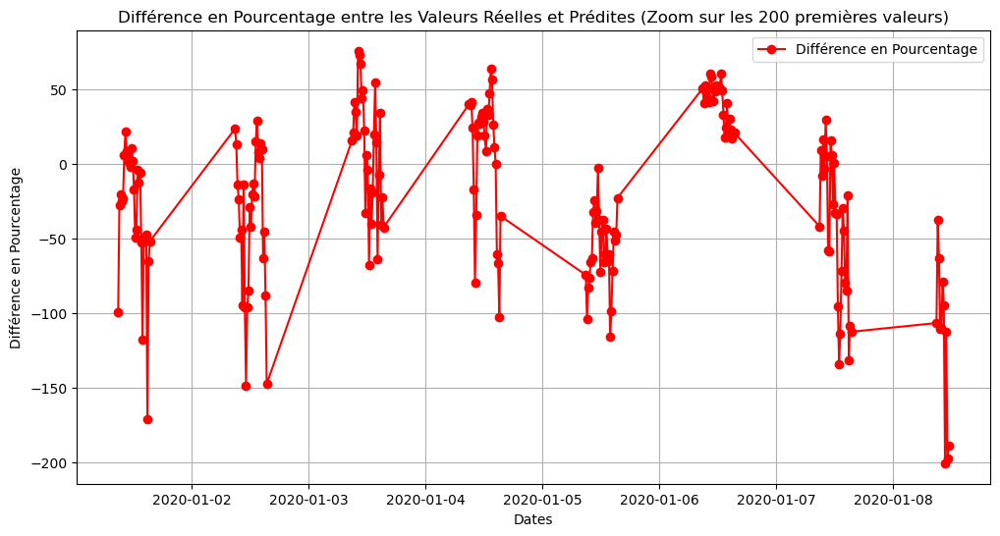

In [36]:
all_test_pred_graph(data_rfm[3],data_rfm[4])

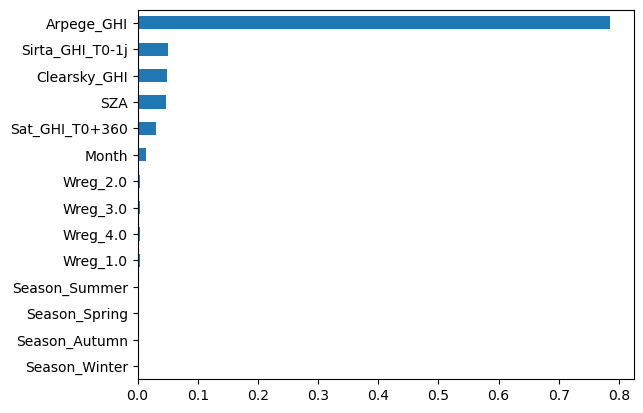

In [37]:
features_importance(data_rfm[5], data_rfm[0])

The first RFM prediction was

MSE: 14186.071668701841

MAE: 80.39576056845442

R-squared: 0.7967006916704721

Distance DTW: 362329.56846821733

We can see a small improvment on the different measurment parameter. We can see on the feature importance graph that the Season were not used and the month was used barely used for the prediction. I tried to do the prediction without the month but the season is still useless. Also, once again the model underestimate the target value.

MSE: 13689.884984753406
MAE: 86.85631060548357
R-squared: 0.803811498101233
Distance DTW: 436416.8912932773


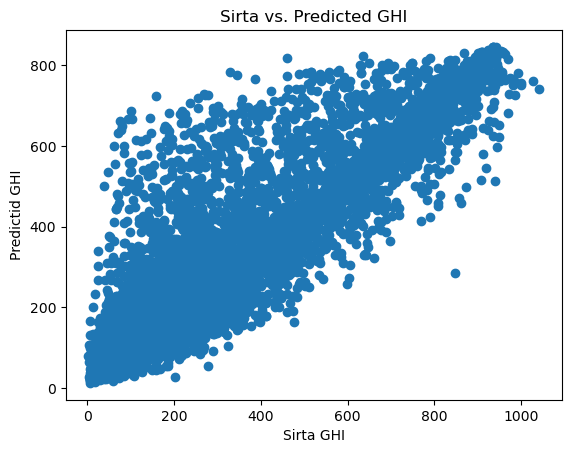

In [73]:
GMDH=Combi()
data_gmdh=model_fit_prediction(df_train_sm,df_test_sm, GMDH)
evaluate_algo(GMDH,data_gmdh[3],data_gmdh[4])
scatter_test_pred(data_gmdh[3],pd.Series(data_gmdh[4]))

MSE: 13586.4925262984

MAE: 86.23534528329814

R-squared: 0.8052932060596643

Distance DTW: 435168.03816080984

The results are almost the same with a lot more calculation time.

In [40]:
df=df.drop(['Season_Winter', 'Season_Spring', 'Season_Summer', 'Season_Autumn'],axis=1)

## Using Season and Month means

We are putting in input the mean values of the real GHI. The means have been calculated from all our variables. This may be an issu as some month (may and juin) have only been calculated for two years. So both of this values made the mean used after to predict themselfs. For this data to be more reliable we would need more data)

In [41]:
df['Hour'] = df.index.hour
df['Minute'] = df.index.minute

In [47]:
df['Season'] = (df.index.month % 12 + 3) // 3
df['Monthly_Mean_Sirta_GHI'] = df.groupby(['Month','Hour','Minute'])['Sirta_GHI'].transform('mean')
df['Seasonly_Mean_Sirta_GHI'] = df.groupby(['Season','Hour','Minute'])['Sirta_GHI'].transform('mean')
df.drop('Season',axis=1,inplace=True)

In [ ]:
df_train_mean = df.loc[df.index<'01-01-2020'][columns_selection([360],date_means=True)]
df_test_mean = df.loc[df.index >= '01-01-2020'][columns_selection([360],date_means=True)]
fig, ax = plt.subplots(figsize=(15, 5))
df_train_mean['Sirta_GHI'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
df_test_mean['Sirta_GHI'].plot(ax=ax, label='Test Set')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

### RFM

RandomForestRegressor()
MSE: 13869.313659946318
MAE: 79.73594987787791
R-squared: 0.8012401220069135
Distance DTW: 342913.07704166294


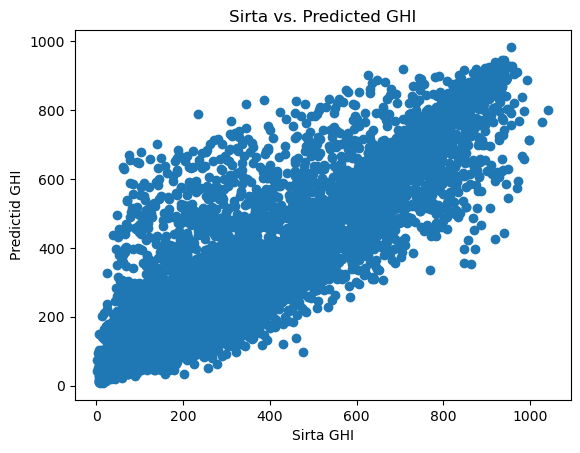

In [55]:
rfm=RandomForestRegressor()
data_rfm=model_fit_prediction(df_train_mean,df_test_mean,rfm)
evaluate_algo(rfm,data_rfm[3],data_rfm[4])
scatter_test_pred(data_rfm[3],data_rfm[4])

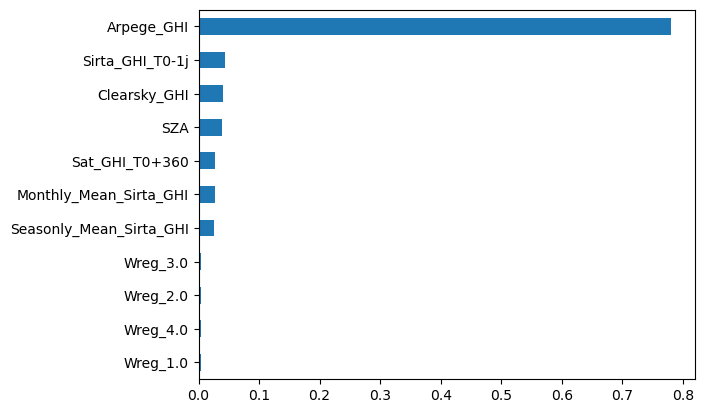

In [56]:
features_importance(data_rfm[5], data_rfm[0])

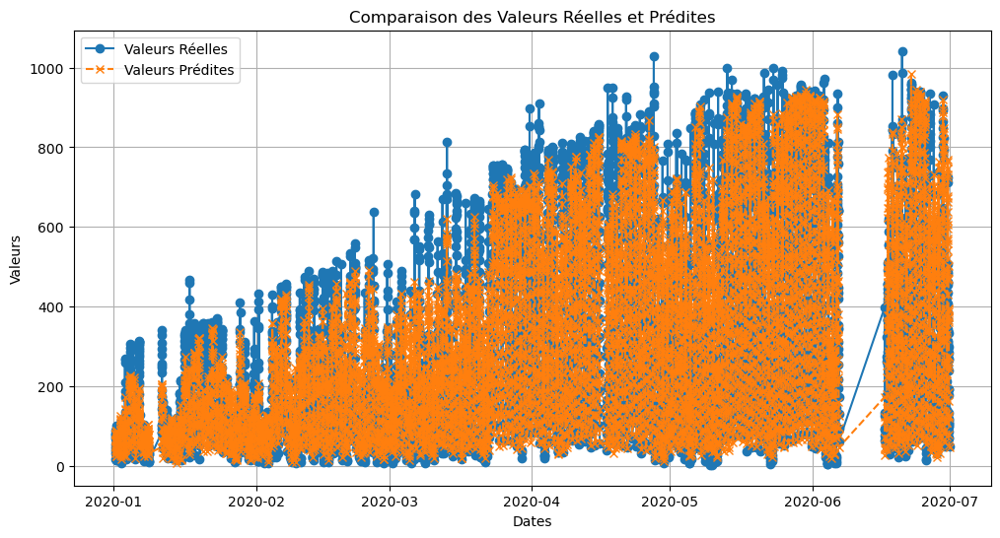

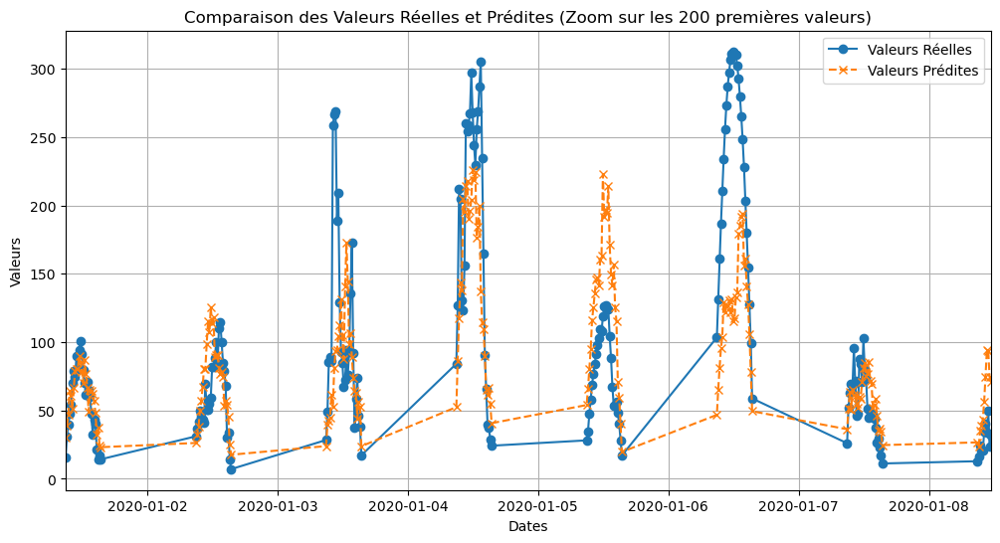

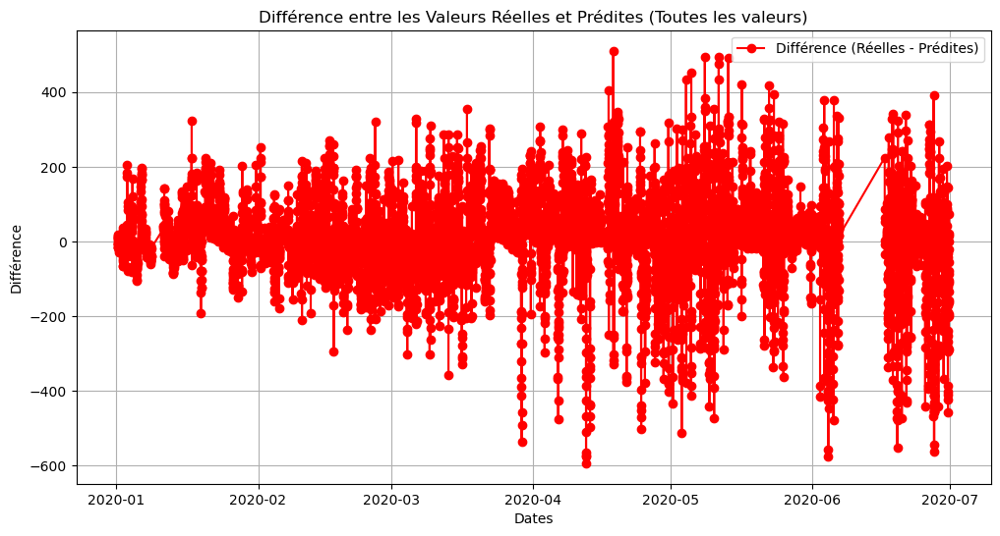

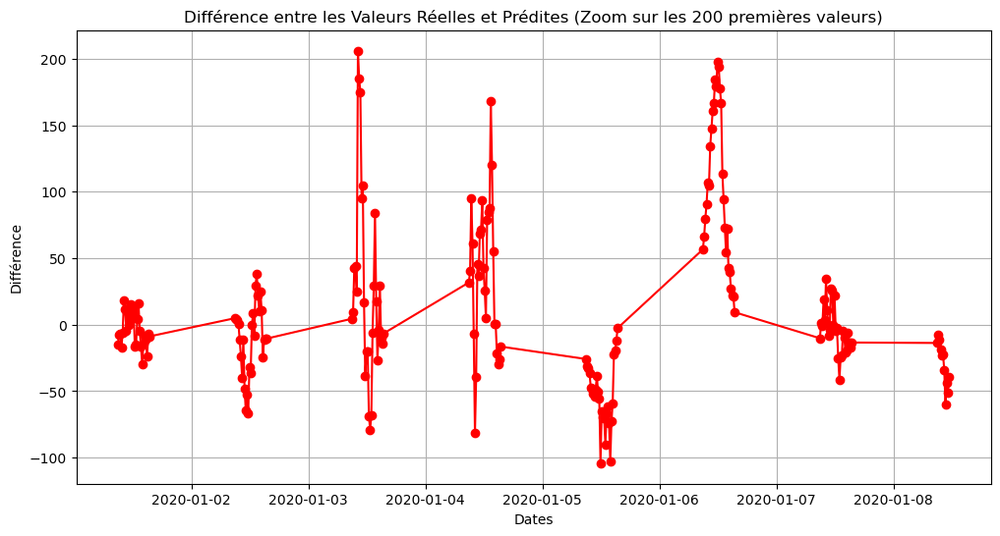

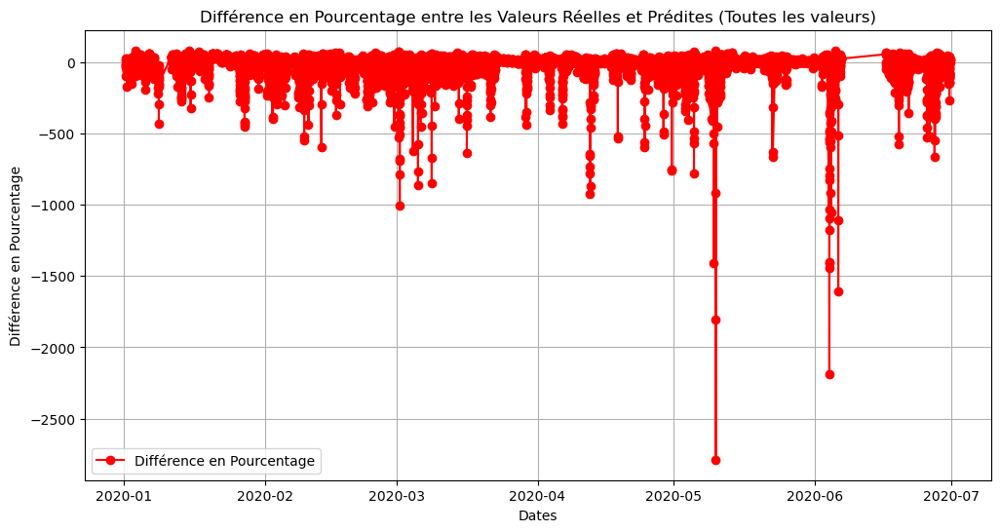

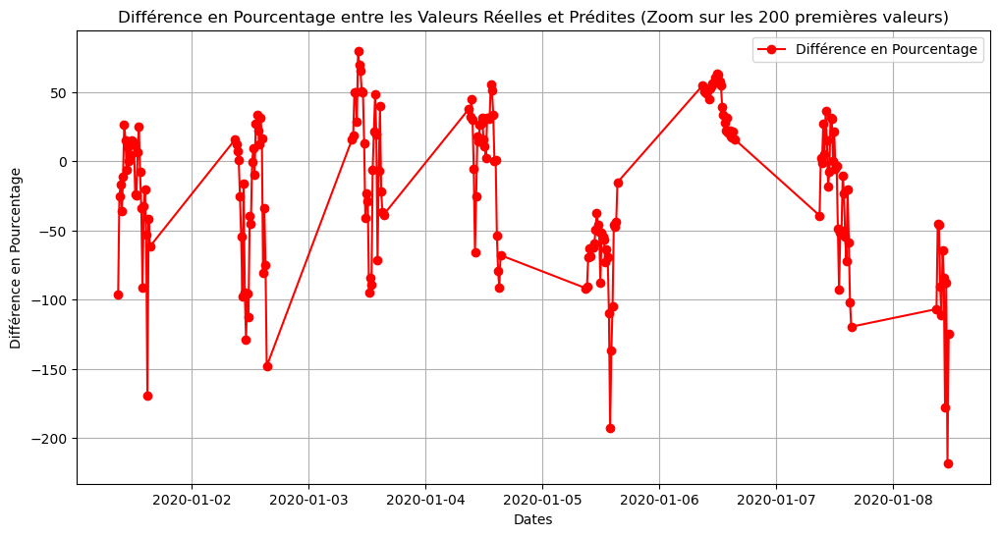

In [57]:
all_test_pred_graph(data_rfm[3],data_rfm[4])

Knowing the month without his mean got us this result:

MSE: 14050.005786254169

MAE: 80.4221717776965

R-squared: 0.7986506395090897

Distance DTW: 345944.83228633506


With the mean we obtain:
    
MSE: 13846.775303216325

MAE: 79.76244274690605

R-squared: 0.8015631171560358

Distance DTW: 342972.7266442415

We can see on the featuring graph that the month means was used as much as the month itself which is not much. The scores are also really close from one an other. It is clear that the mean does not provide usefull information to the RandomForest model.

### SVM

SVR(C=1000.0, kernel='linear')
MSE: 13431.55601549425
MAE: 72.21690514573524
R-squared: 0.8075135871642491
Distance DTW: 301419.5631787533


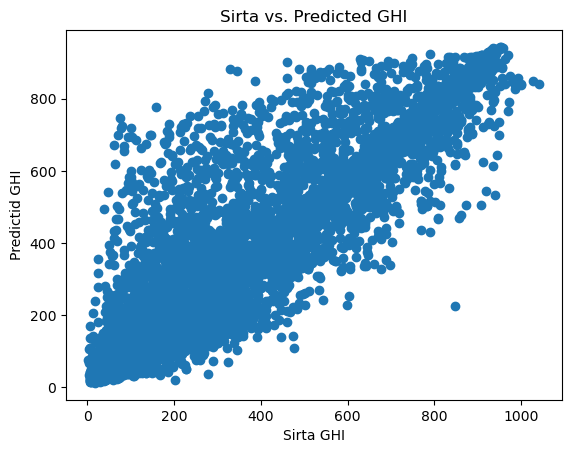

In [67]:
svr_lr=SVR(kernel= 'linear', C= 1e3)
data_svr_lr=model_fit_prediction(df_train_mean,df_test_mean,svr_lr)
evaluate_algo(svr_lr,data_svr_lr[3],data_svr_lr[4])
scatter_test_pred(data_svr_lr[3],data_svr_lr[4])

The result without the means was:

SVR(C=1000.0, kernel='linear')

MSE: 13415.363989108888

MAE: 72.24330137681034

R-squared: 0.8077456336279549

Distance DTW: 314032.10018379876

Conclusion: the result is the same.

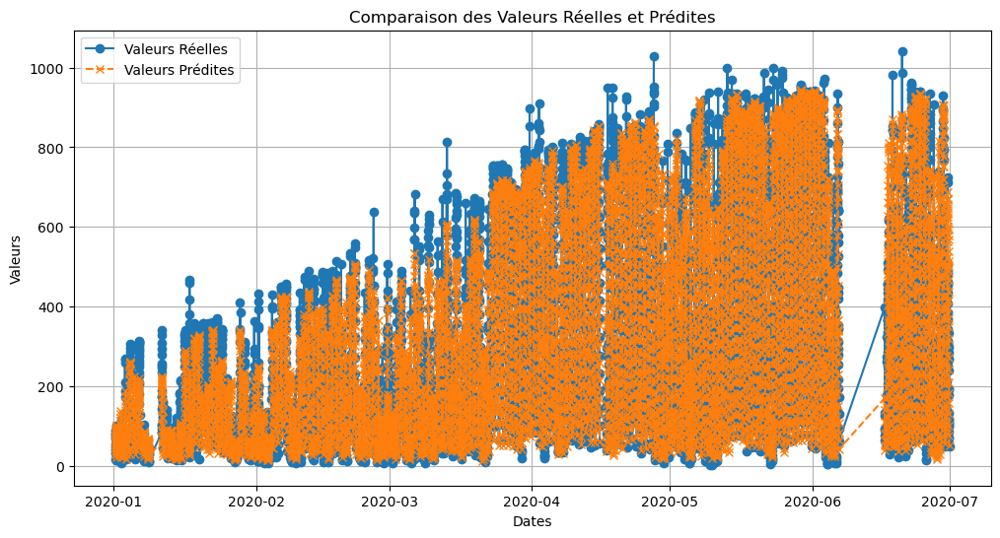

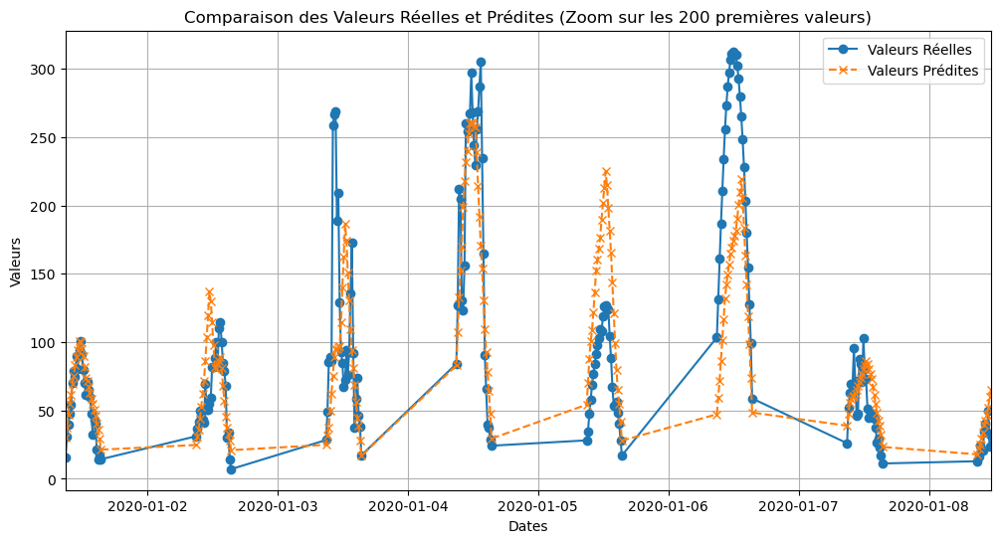

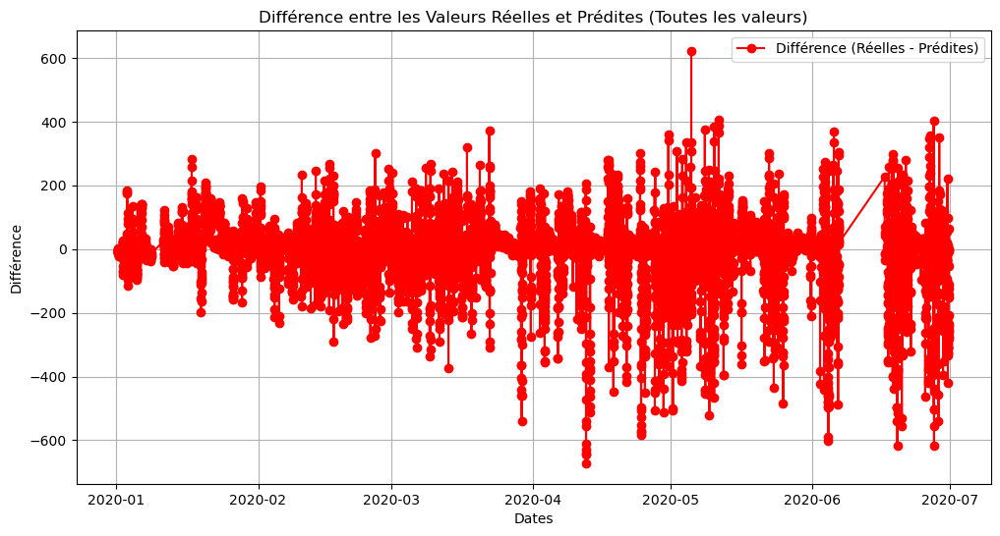

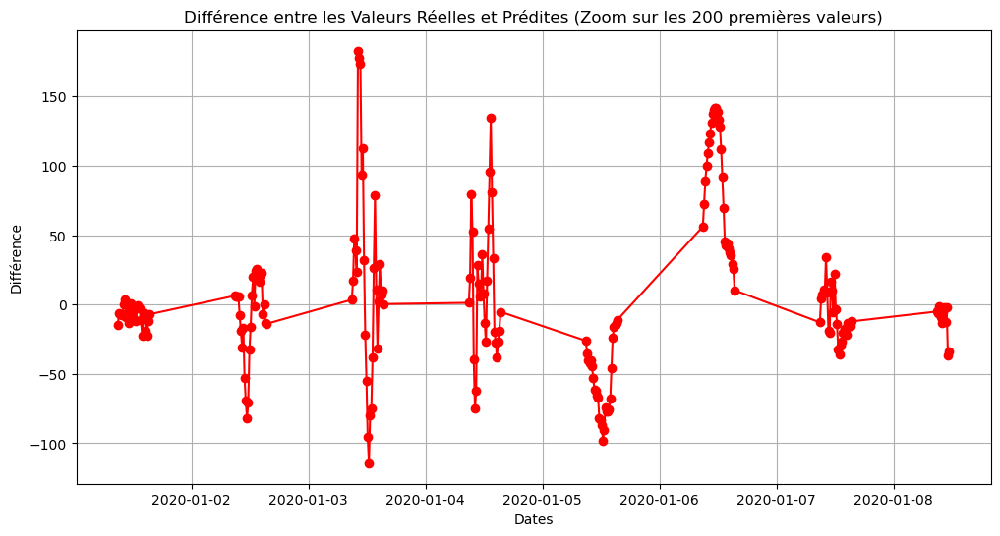

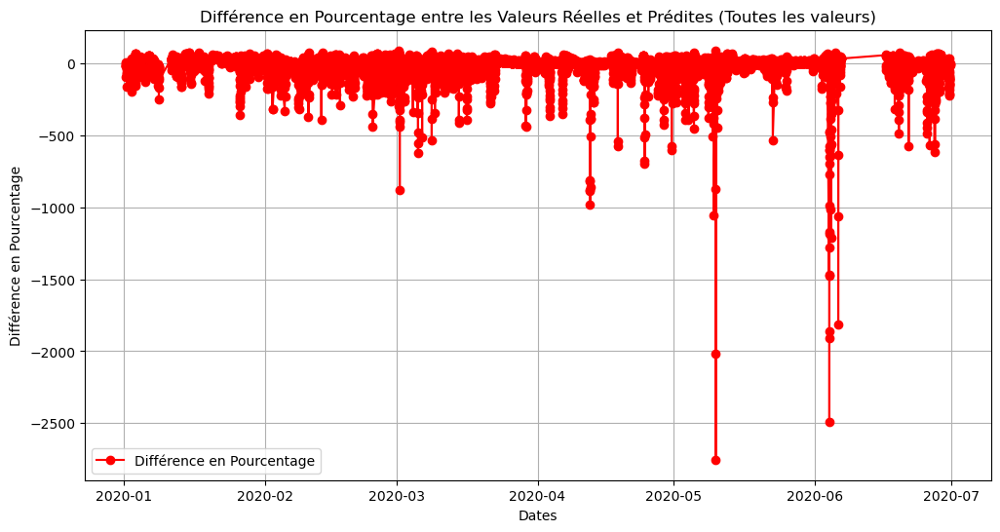

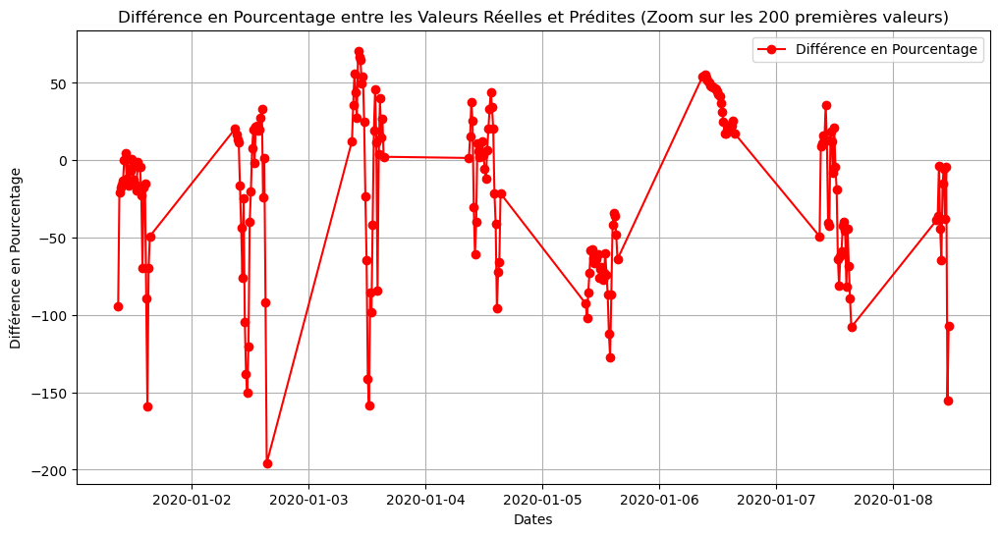

In [71]:
all_test_pred_graph(data_svr_lr[3],data_svr_lr[4])

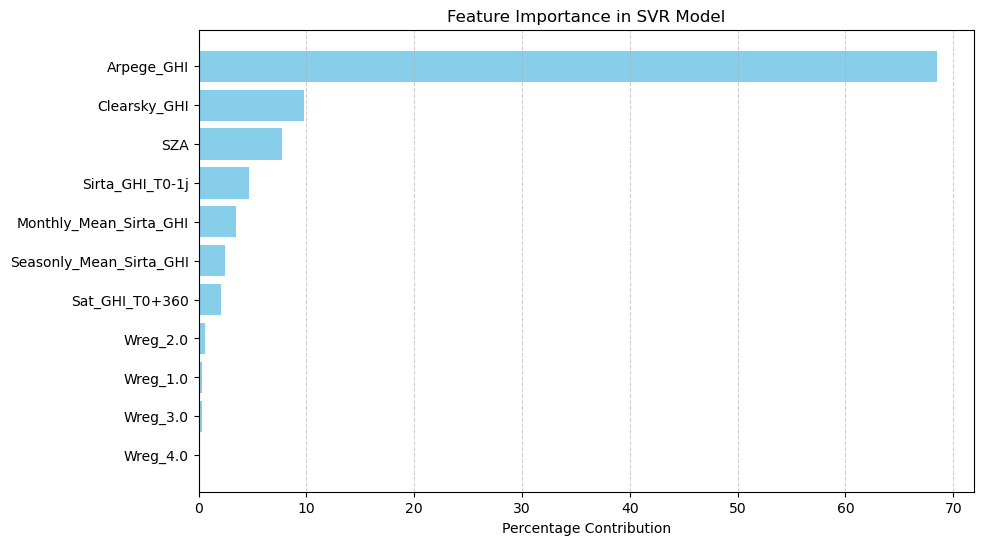

In [69]:
features_importance_svr_lr(data_svr_lr[5],data_svr_lr[0])

Hypthesis, it can make sens that the means from the saison and the month are not efficient. The column Arpege and Sirta T0+360 may already provide us better information about the current "weather type".

# Variation from the mean as target value.

In this section instead of predicting the GHI we will try to predict the variation from of GHI from the month mean. So we will have informations about if the GHI would be higher or lower for this time of the year.

## First step: create the variation column

In [58]:
df['Var_month']=df['Monthly_Mean_Sirta_GHI']-df['Sirta_GHI']

In [59]:
df.T

date,2017-07-01 05:11:00,2017-07-01 05:26:00,2017-07-01 05:41:00,2017-07-01 05:56:00,2017-07-01 06:11:00,2017-07-01 06:26:00,2017-07-01 06:41:00,2017-07-01 06:56:00,2017-07-01 07:11:00,2017-07-01 07:26:00,...,2020-06-30 16:56:00,2020-06-30 17:11:00,2020-06-30 17:26:00,2020-06-30 17:41:00,2020-06-30 17:56:00,2020-06-30 18:11:00,2020-06-30 18:26:00,2020-06-30 18:41:00,2020-06-30 18:56:00,2020-06-30 19:11:00
Sirta_GHI,12.172667,16.694667,30.220667,46.928667,50.004667,34.997333,41.199333,44.598,92.186,175.05,...,111.949333,119.014,99.492,85.366667,70.674,105.317333,193.562667,100.916667,67.522667,48.252667
Sat_GHI_T0+0,46.639333,46.641917,34.287182,52.639118,73.049175,62.177591,64.840267,83.421182,107.309084,143.616315,...,153.48438,149.26174,142.383254,117.362393,93.089357,110.366861,145.358405,142.315518,97.669254,51.93973
Clearsky_GHI,119.292611,156.593875,195.732357,236.267183,277.824905,320.073178,362.706751,405.439656,448.000751,490.131181,...,431.151339,388.75437,346.286857,304.028984,262.277318,221.350095,181.596414,143.412732,107.27399,73.796978
Arpege_GHI,11.261829,13.609398,18.504805,24.326697,30.14859,35.970482,36.296008,35.247443,34.198877,33.150312,...,290.609797,257.332435,224.055074,195.306949,168.205819,141.104689,114.003559,89.045628,64.623497,40.201366
SZA,79.702292,77.410452,75.078445,72.711278,70.313885,67.891181,65.448112,62.989726,60.521246,58.048164,...,63.296653,65.754232,68.195807,70.616356,73.010947,75.374674,77.702599,79.989712,82.230881,84.42083
Kc_Sat_mean,0.389356,0.235036,0.195269,0.267614,0.204141,0.177668,0.214748,0.258431,0.268668,0.367077,...,0.368583,0.365116,0.363959,0.352041,0.364558,0.554589,0.904981,0.860305,0.716394,0.754391
Kc_Sat_std,0.10003,0.071296,0.036872,0.051194,0.053714,0.030814,0.034115,0.045817,0.035159,0.075426,...,0.045472,0.030054,0.03622,0.032519,0.035629,0.115206,0.113562,0.135666,0.096471,0.166124
Kc_obs,0.10204,0.106611,0.154398,0.198625,0.179986,0.109342,0.113589,0.109999,0.205772,0.357149,...,0.259652,0.306142,0.287311,0.280785,0.269463,0.475795,1.065895,0.70368,0.629441,0.653857
Sat_GHI_T0+15,0.0,60.436766,48.905194,37.655484,83.924422,64.853683,66.698877,79.173514,110.696204,159.032418,...,139.514968,135.614082,129.599289,118.150472,93.904655,105.263515,116.327328,112.521938,83.699112,51.668222
Sat_GHI_T0+30,0.0,0.0,68.602462,64.199038,40.746849,81.115239,64.032298,76.976899,123.61917,174.290443,...,143.146325,130.025181,116.683907,109.846159,98.986113,117.650883,116.233687,80.869152,55.316036,36.821135


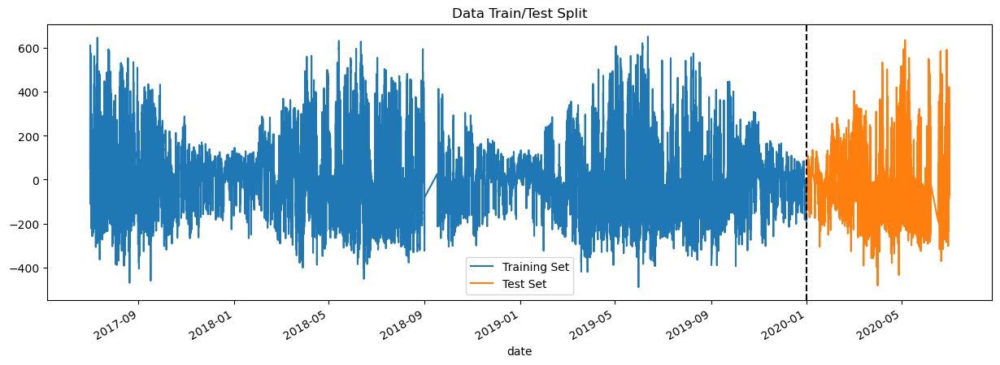

In [60]:
df_train_mean = df.loc[df.index<'01-01-2020'][columns_selection([360],date_means=True,var=True)].drop('Sirta_GHI',axis=1)
df_test_mean = df.loc[df.index >= '01-01-2020'][columns_selection([360],date_means=True,var=True)].drop('Sirta_GHI',axis=1)
fig, ax = plt.subplots(figsize=(15, 5))
df_train_mean['Var_month'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
df_test_mean['Var_month'].plot(ax=ax, label='Test Set')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

### Linear Regression

LinearRegression()
MSE: 13417.356335614337
MAE: 84.26776667522002
R-squared: 0.5090489104264947
Distance DTW: 437087.5079382265


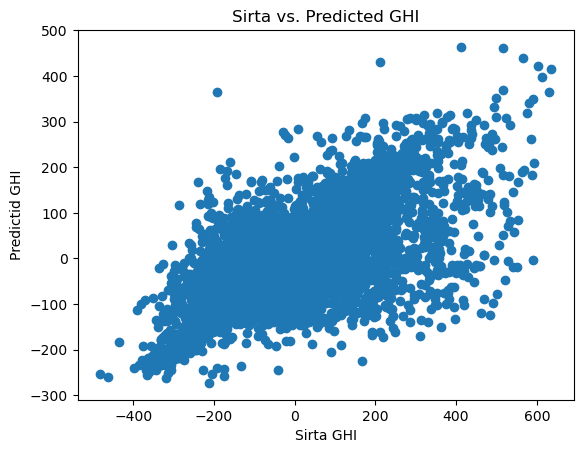

In [174]:
lr=LinearRegression()
data_lr=model_fit_prediction(df_train_mean,df_test_mean,lr,'Var_month')
evaluate_algo(lr,data_lr[3],data_lr[4])
scatter_test_pred(data_lr[3],data_lr[4])

C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

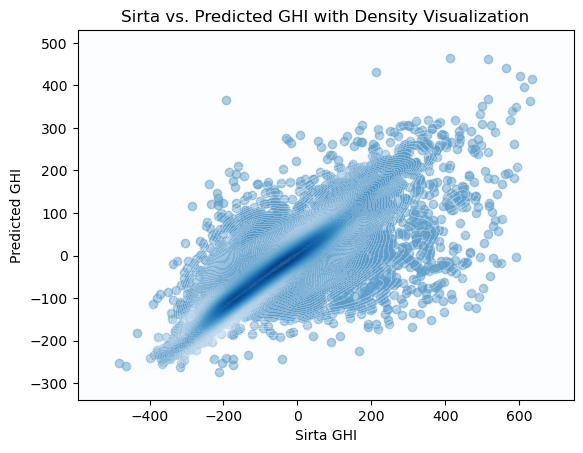

In [175]:
scatter_test_pred_density(data_lr[3],data_lr[4])

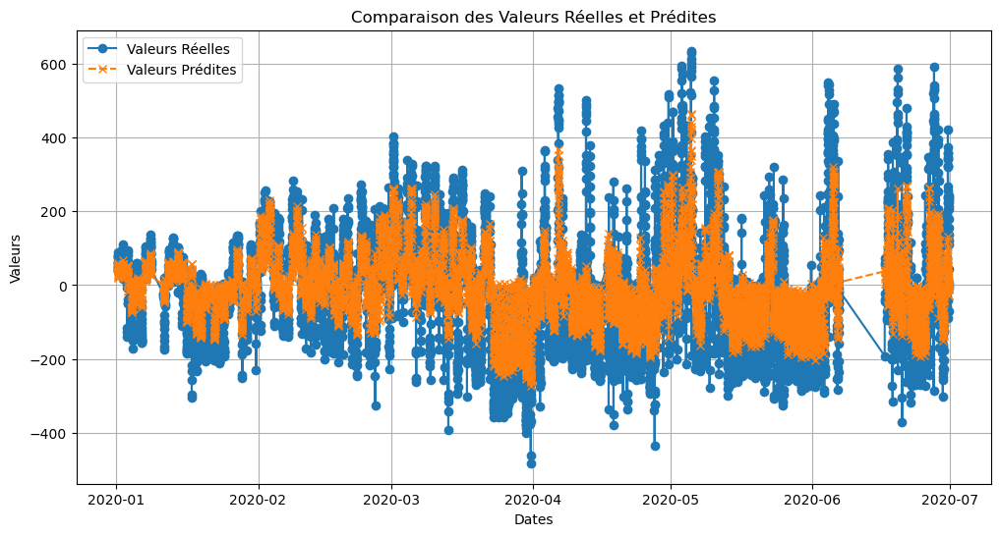

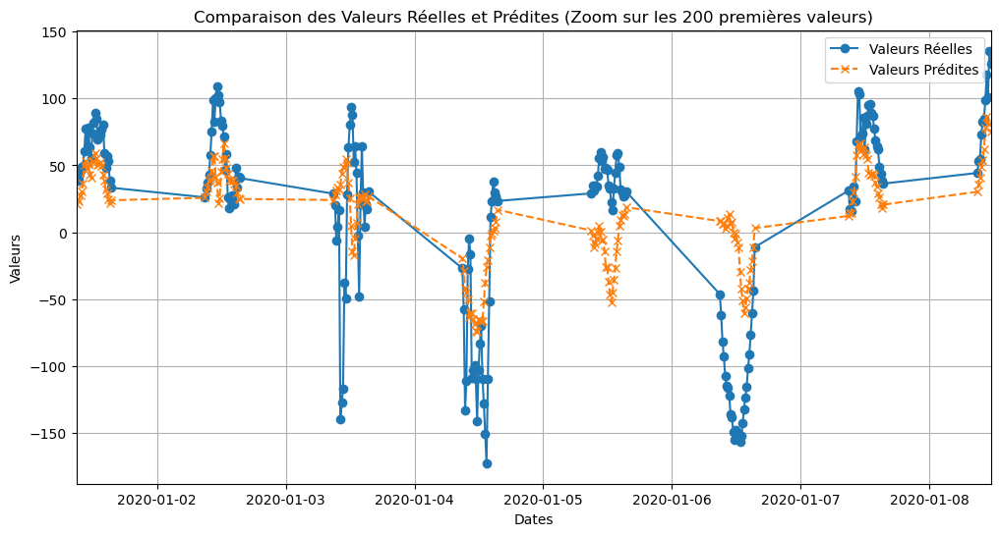

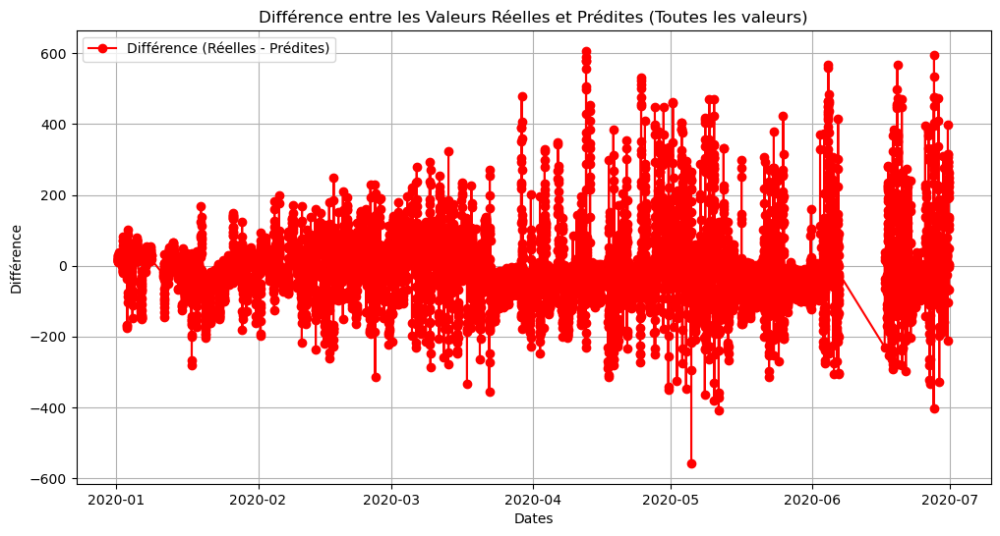

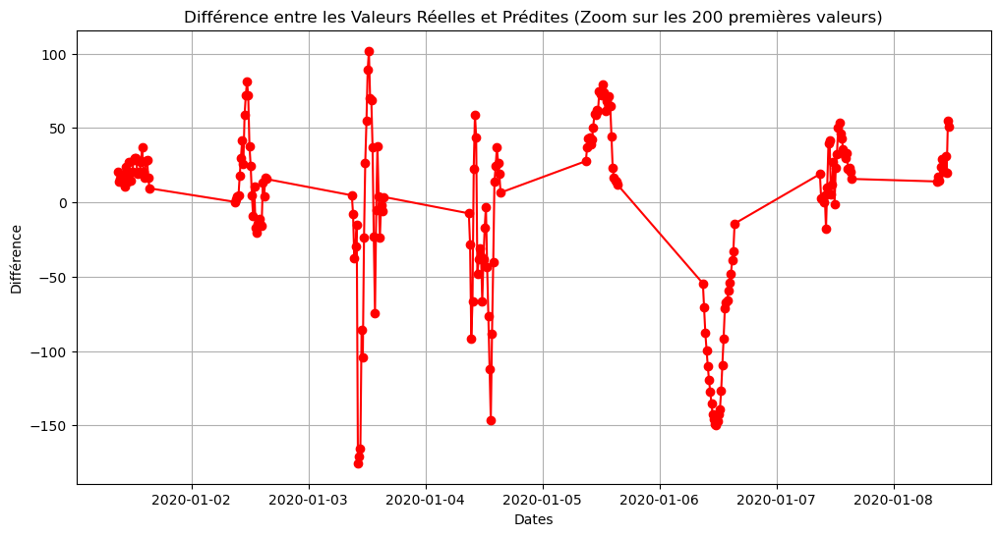

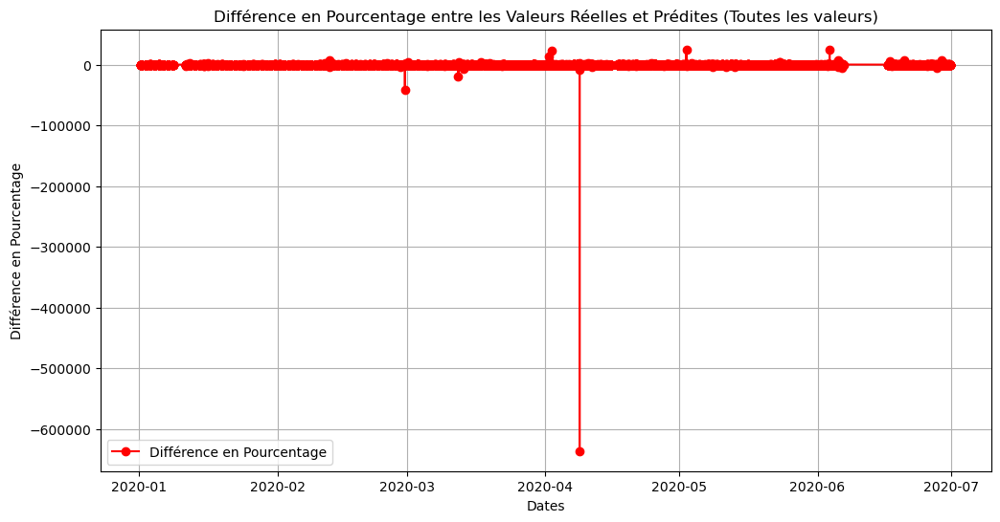

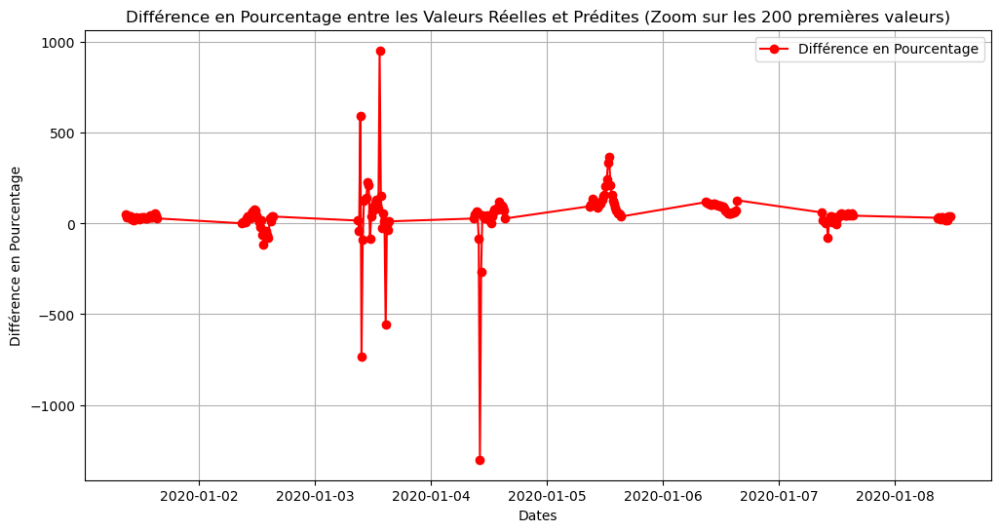

In [176]:
all_test_pred_graph(data_lr[3],data_lr[4])

#### Evaluation of GHI prediction using variation prediction

In [191]:
data_lr_GHI_3=Var_to_GHI(data_lr[3],df,'Monthly_Mean_Sirta_GHI')
data_lr_GHI_4=Var_to_GHI(data_lr[4],df,'Monthly_Mean_Sirta_GHI')

LinearRegression()
MSE: 13417.356335614342
MAE: 84.26776667522002
R-squared: 0.7825848801296389
Distance DTW: 458643.89867050195


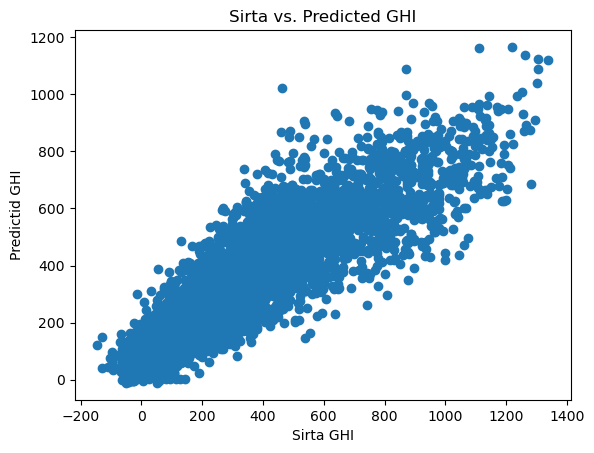

In [192]:
evaluate_algo(lr,data_lr_GHI_3,data_lr_GHI_4)
scatter_test_pred(data_lr_GHI_3,data_lr_GHI_4)

C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

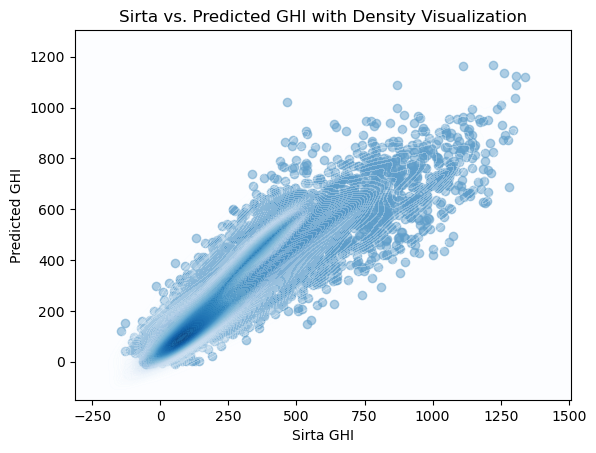

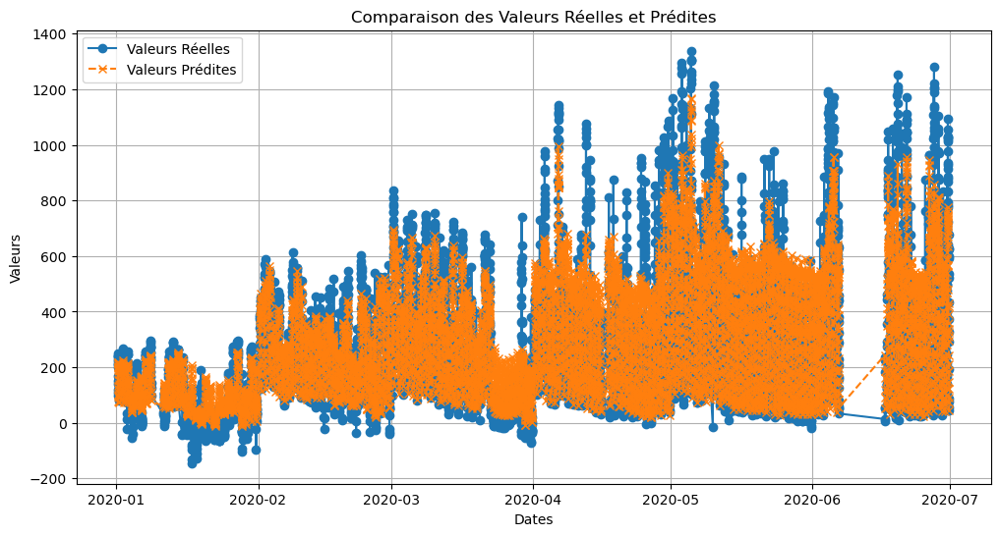

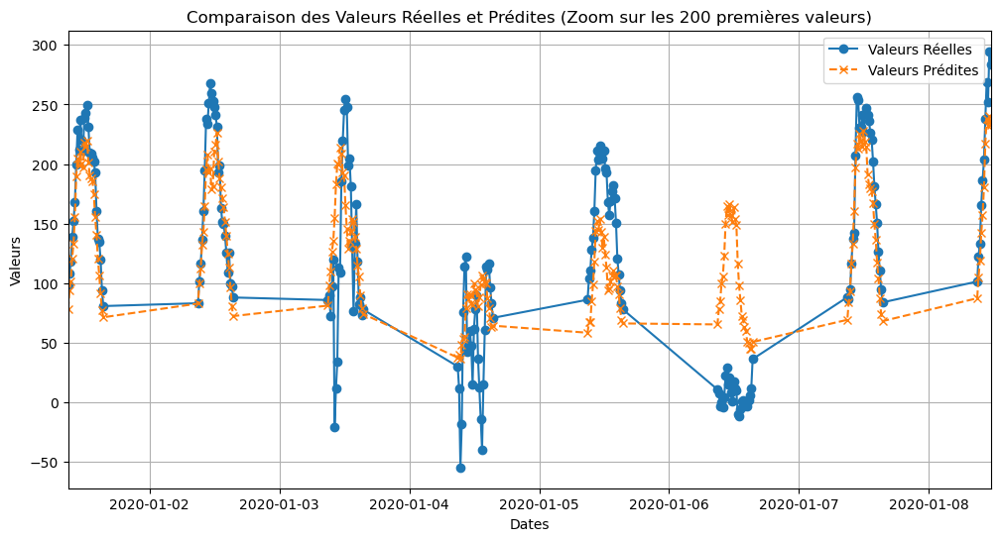

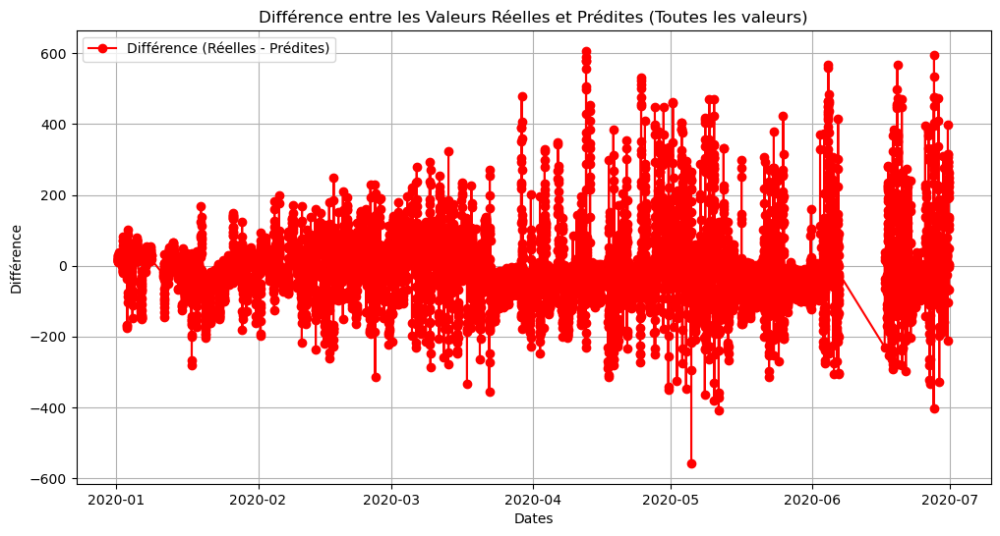

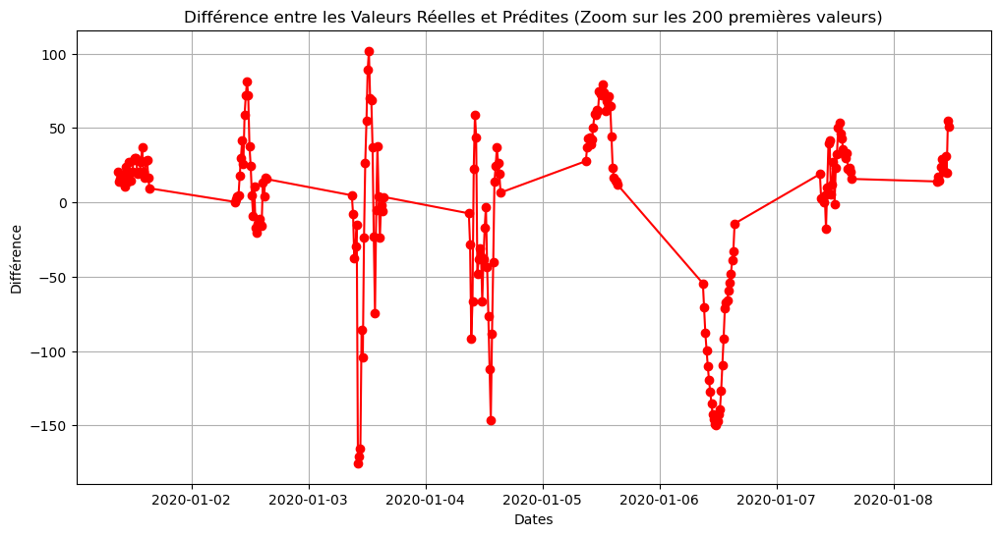

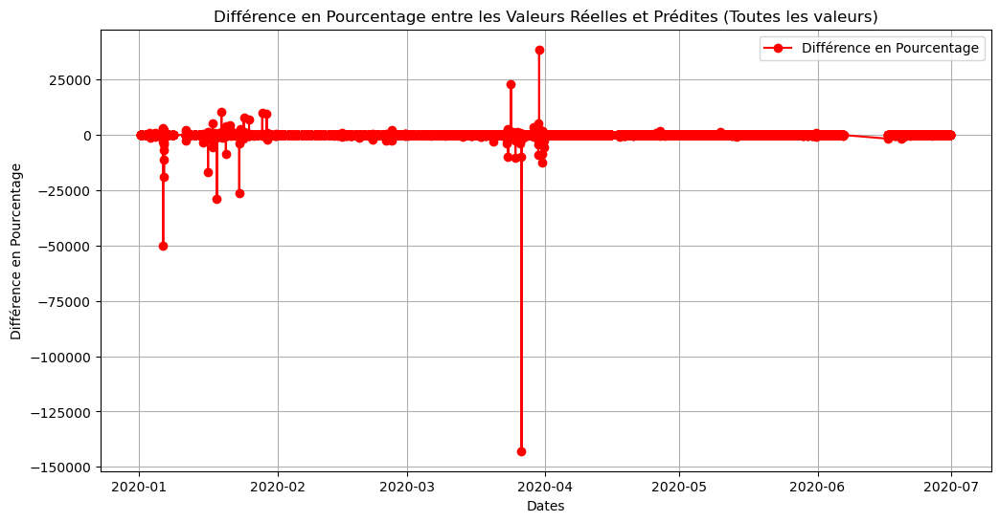

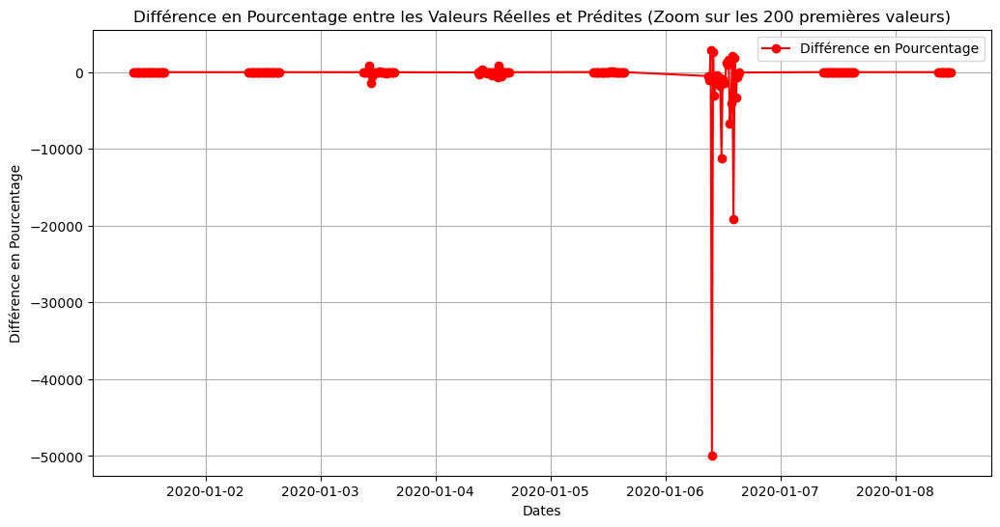

In [193]:
scatter_test_pred_density(data_lr_GHI_3,data_lr_GHI_4)
all_test_pred_graph(data_lr_GHI_3,data_lr_GHI_4)

### RFM

RandomForestRegressor()
MSE: 14001.96495460898
MAE: 81.3269535780259
R-squared: 0.48765764442071335
Distance DTW: 393333.90448340226


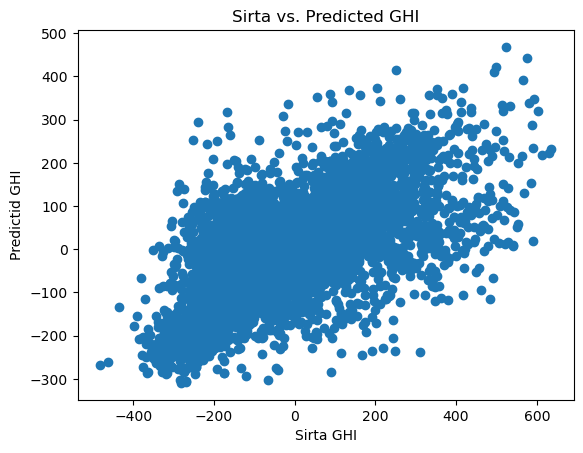

In [45]:
rfm=RandomForestRegressor()
data_rfm=model_fit_prediction(df_train_mean,df_test_mean,rfm,'Var_month')
evaluate_algo(rfm,data_rfm[3],data_rfm[4])
scatter_test_pred(data_rfm[3],data_rfm[4])

C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

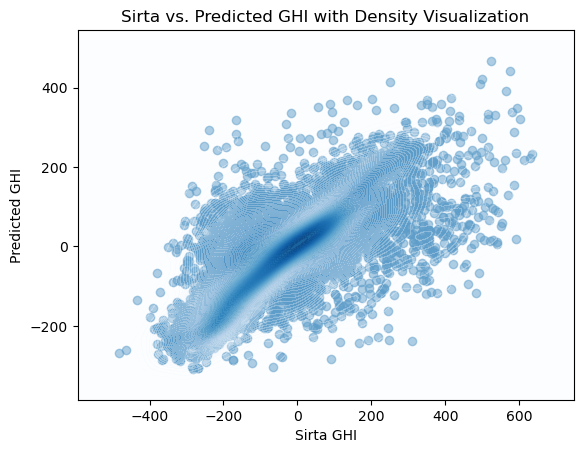

In [46]:
scatter_test_pred_density(data_rfm[3],data_rfm[4])

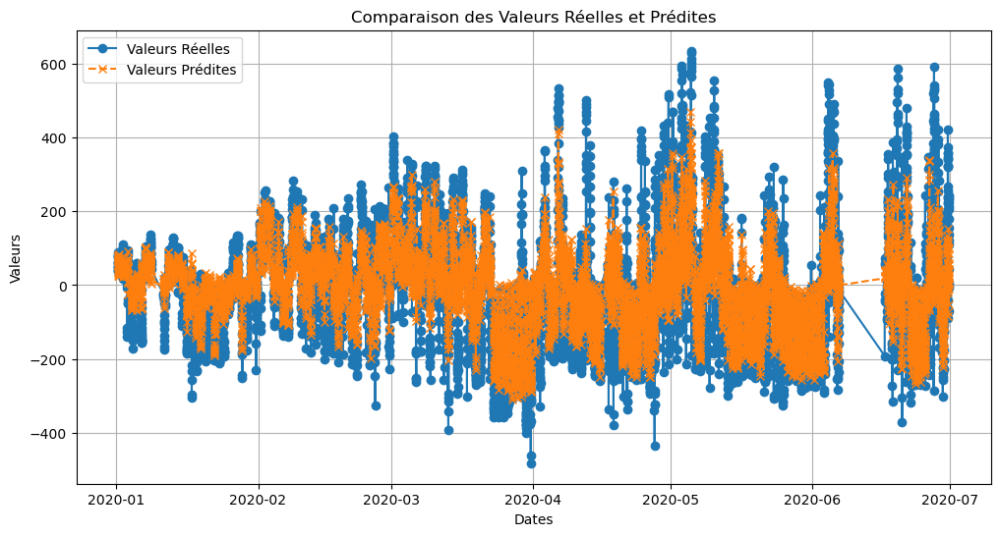

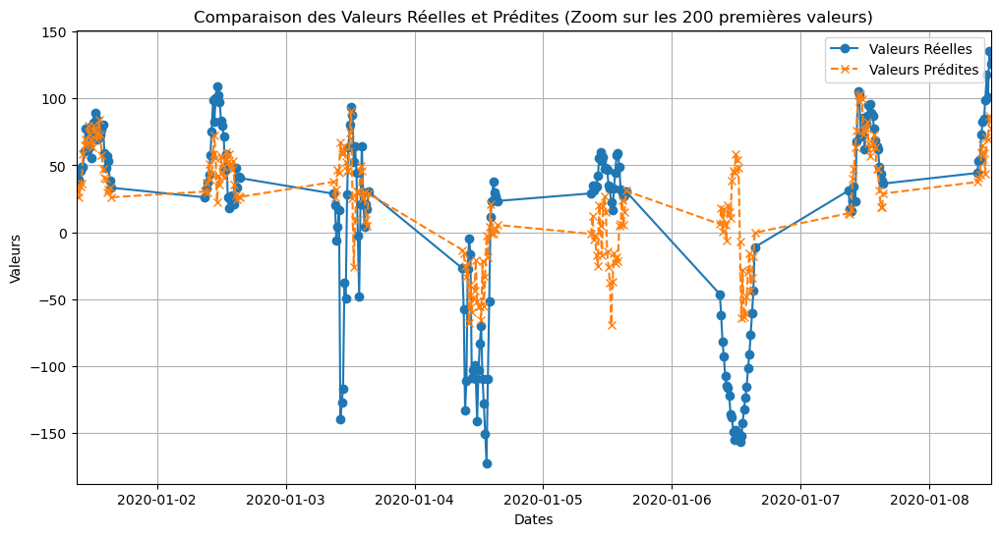

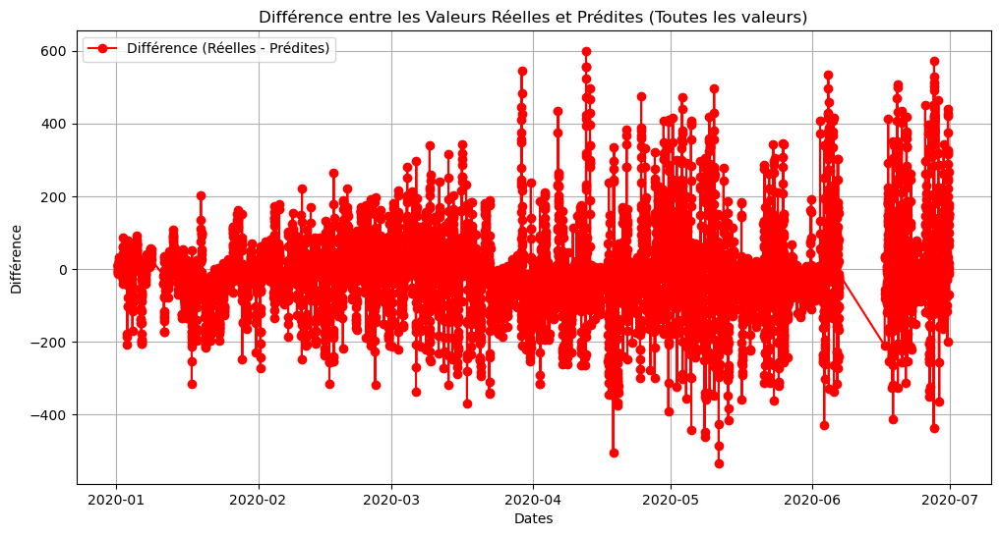

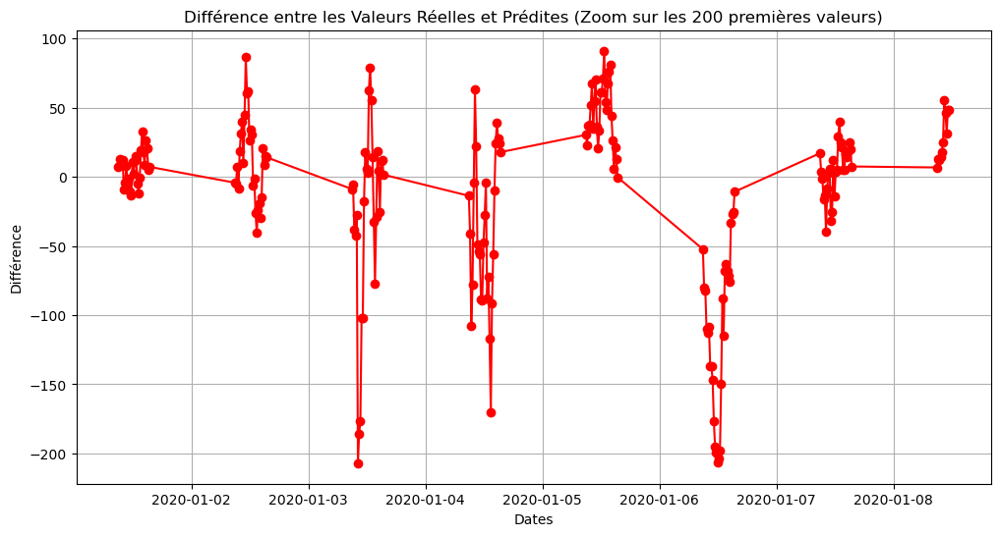

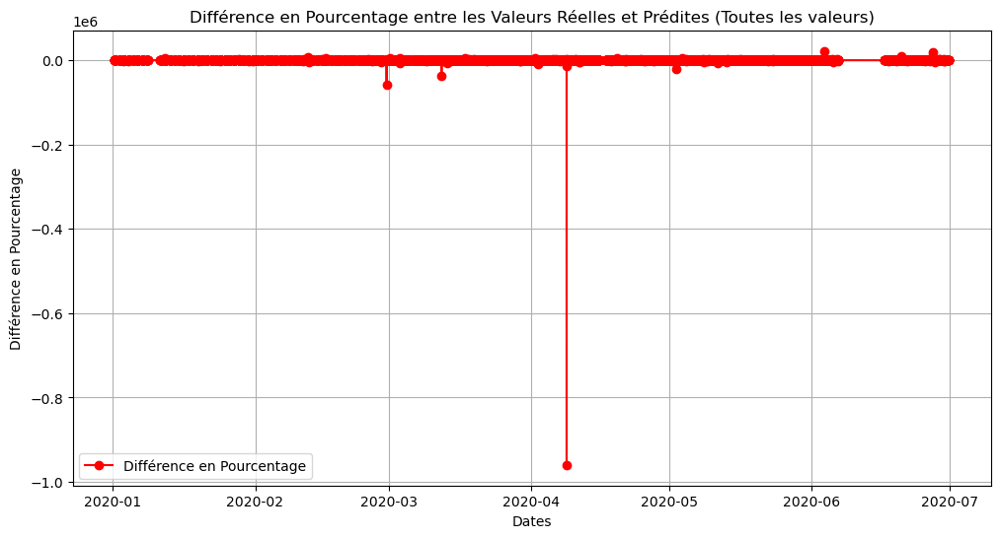

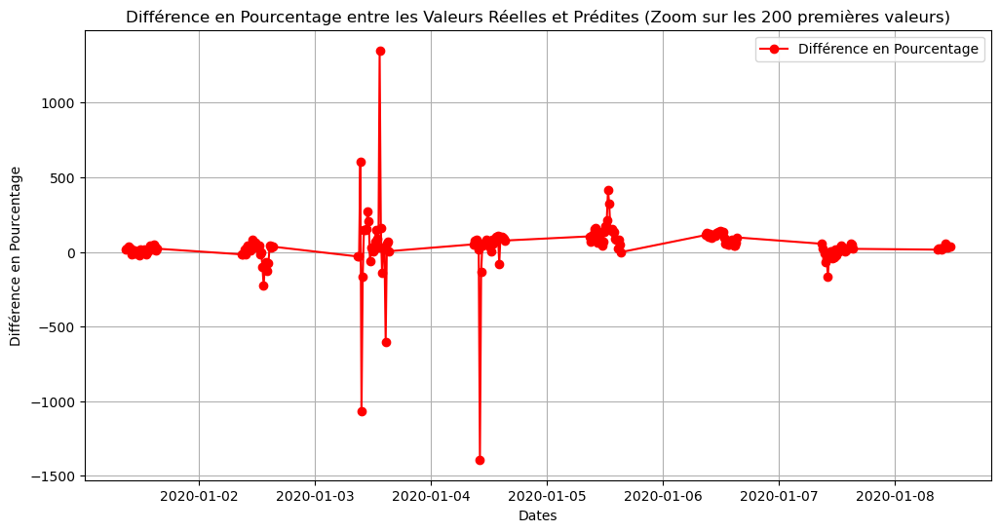

In [47]:
all_test_pred_graph(data_rfm[3],data_rfm[4])

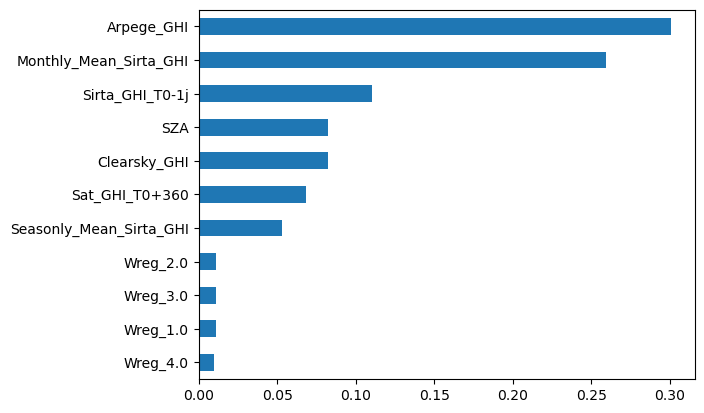

In [48]:
features_importance(data_rfm[5], data_rfm[0])

#### Evaluation of GHI prediction using variation prediction

RandomForestRegressor()
MSE: 14001.96495460898
MAE: 81.3269535780259
R-squared: 0.7731118699630541
Distance DTW: 394756.29385718046


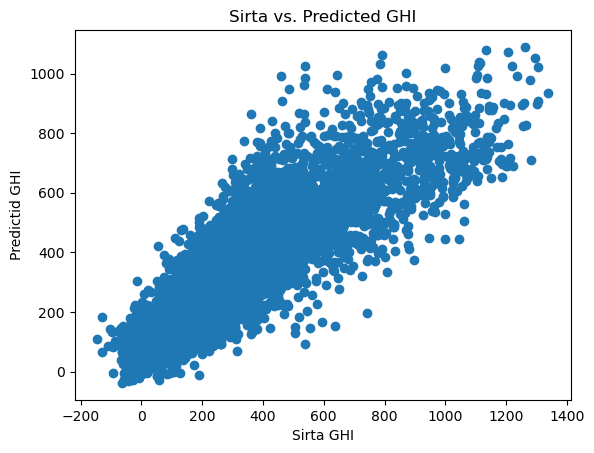

C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

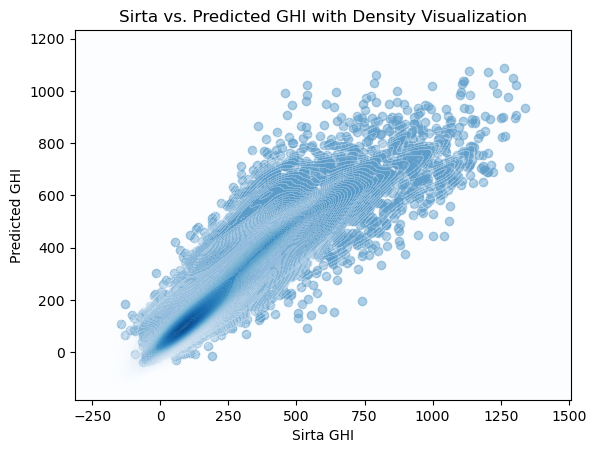

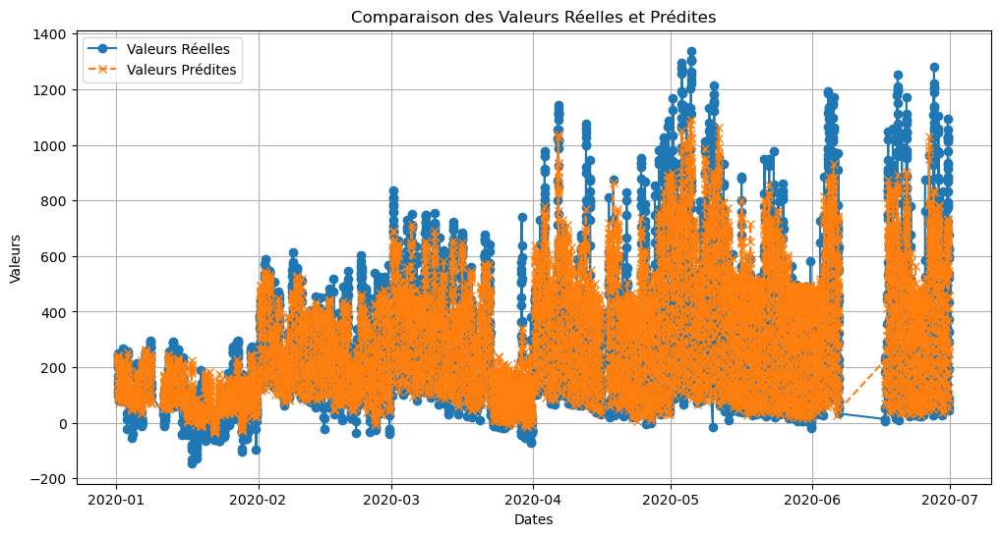

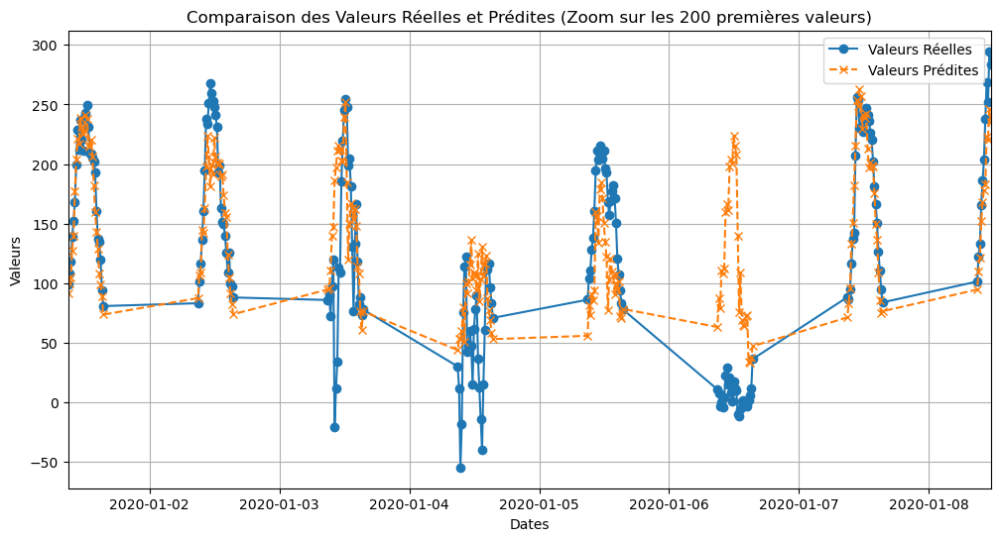

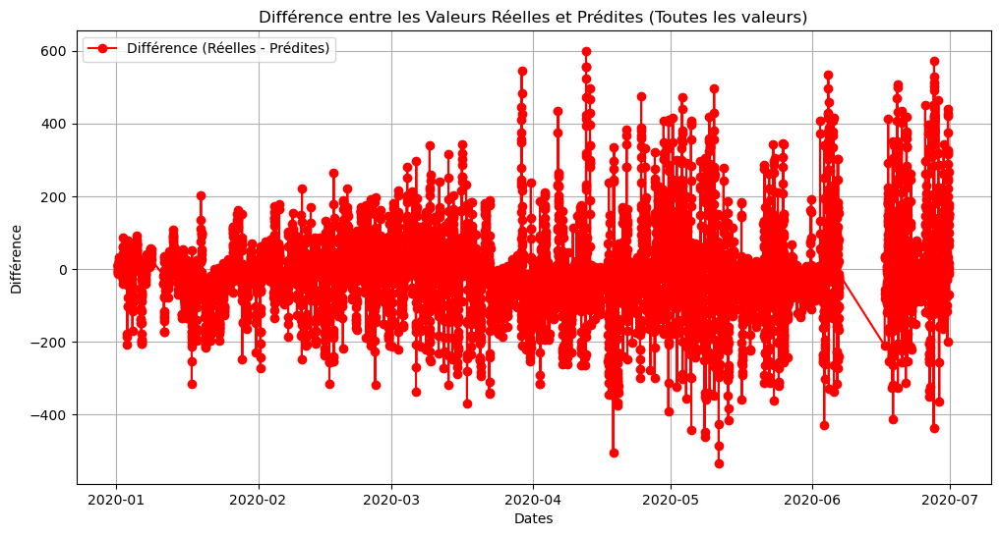

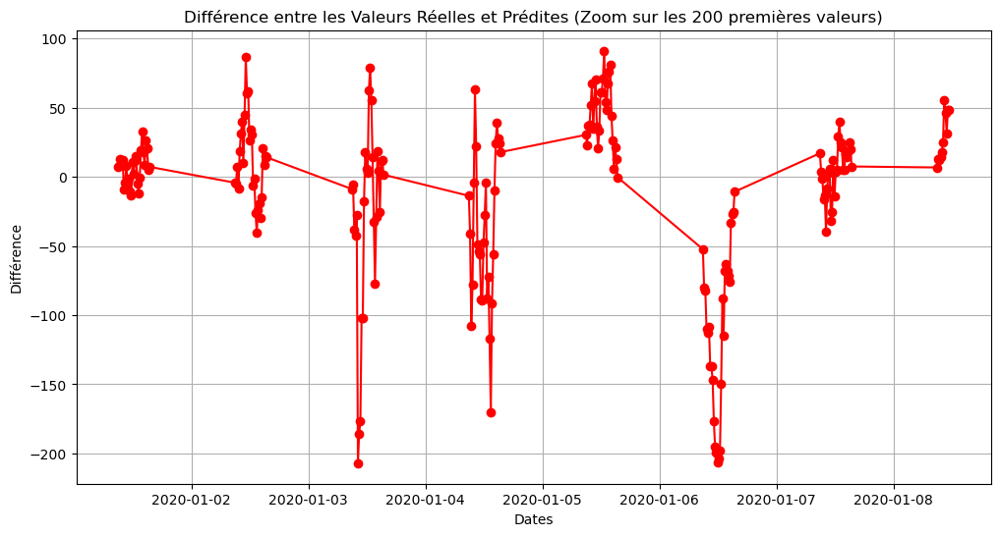

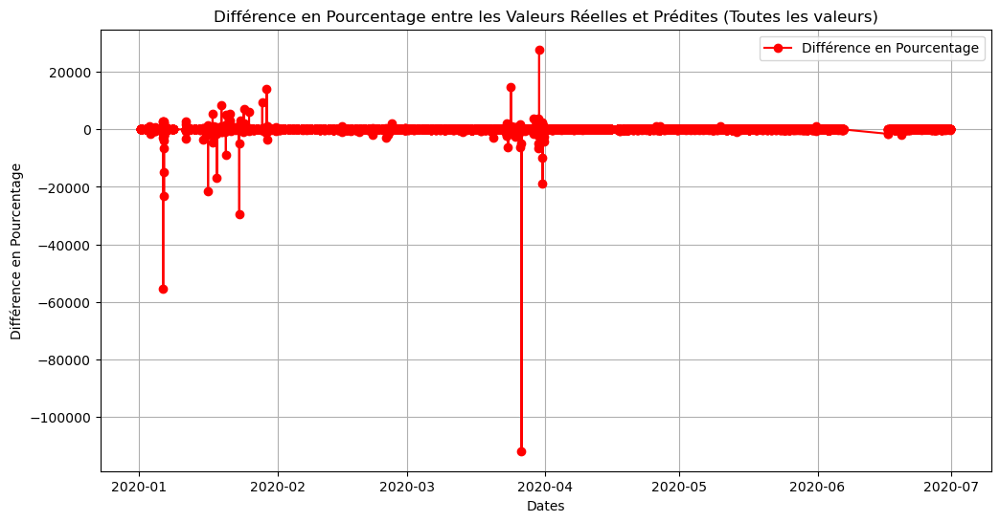

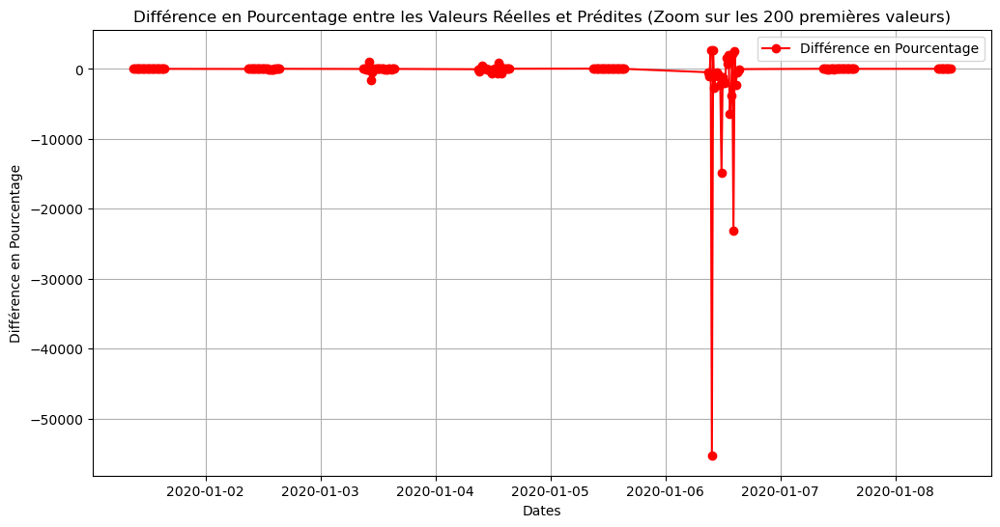

In [50]:
data_rfm_GHI_3=Var_to_GHI(data_rfm[3],df,'Monthly_Mean_Sirta_GHI')
data_rfm_GHI_4=Var_to_GHI(data_rfm[4],df,'Monthly_Mean_Sirta_GHI')
evaluate_algo(rfm,data_rfm_GHI_3,data_rfm_GHI_4)
scatter_test_pred(data_rfm_GHI_3,data_rfm_GHI_4)
scatter_test_pred_density(data_rfm_GHI_3,data_rfm_GHI_4)
all_test_pred_graph(data_rfm_GHI_3,data_rfm_GHI_4)

### SVM

SVR(C=1000.0, kernel='linear')
MSE: 13431.552741340809
MAE: 72.2168701405543
R-squared: 0.5085294533378476
Distance DTW: 362462.46942839515


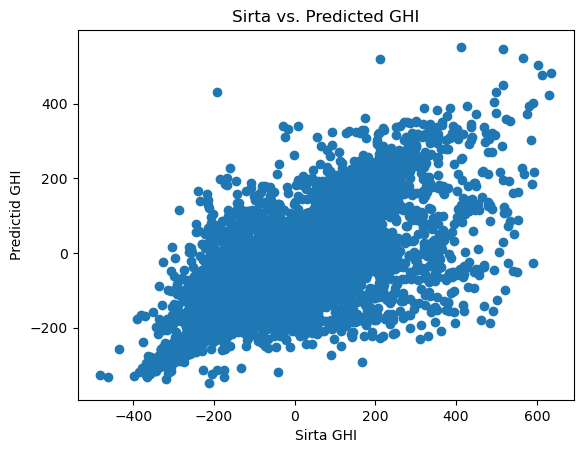

In [62]:
svr_lr=SVR(kernel= 'linear', C= 1e3)
data_svr_lr=model_fit_prediction(df_train_mean,df_test_mean,svr_lr,'Var_month')
evaluate_algo(svr_lr,data_svr_lr[3],data_svr_lr[4])
scatter_test_pred(data_svr_lr[3],data_svr_lr[4])

C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

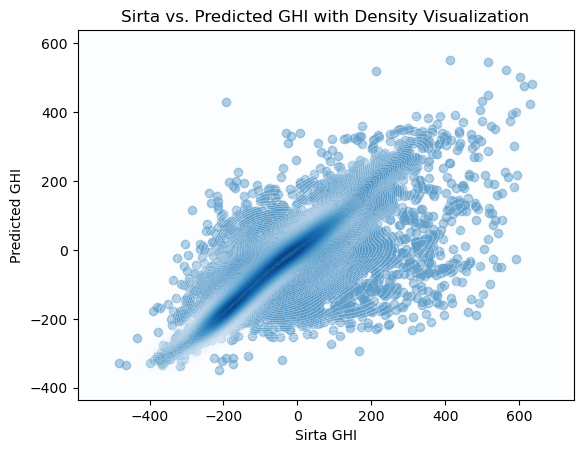

In [63]:
scatter_test_pred_density(data_svr_lr[3],data_svr_lr[4])

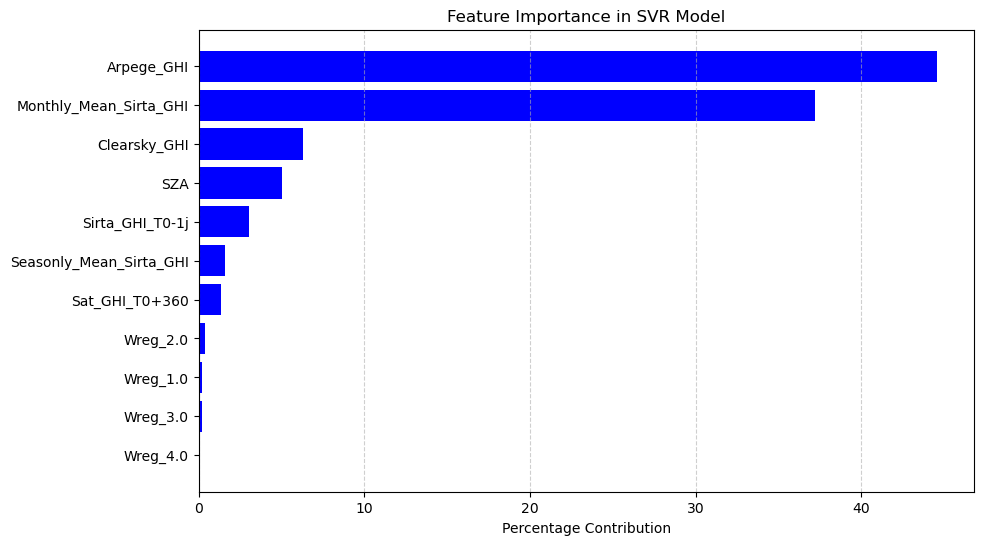

In [64]:
features_importance_svr_lr(data_svr_lr[5],data_svr_lr[0])

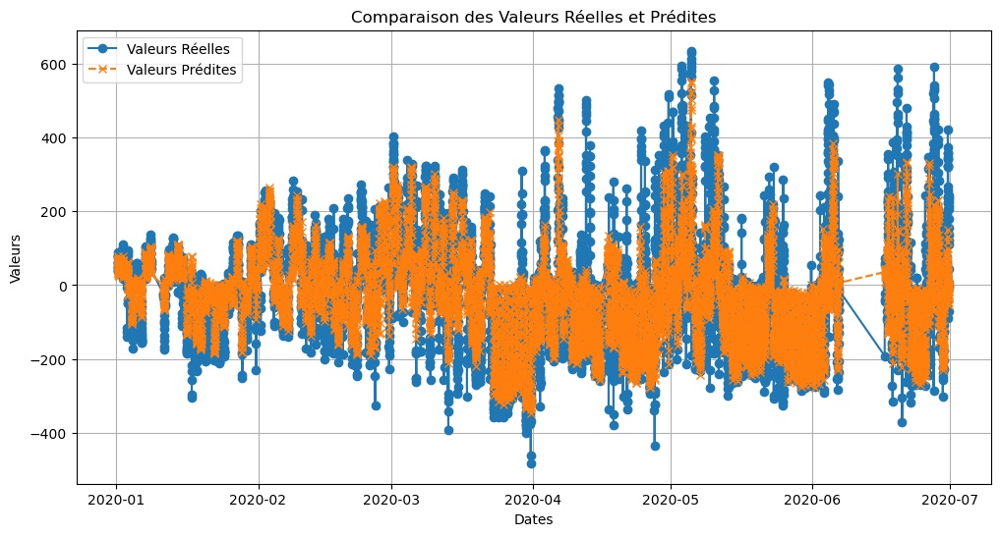

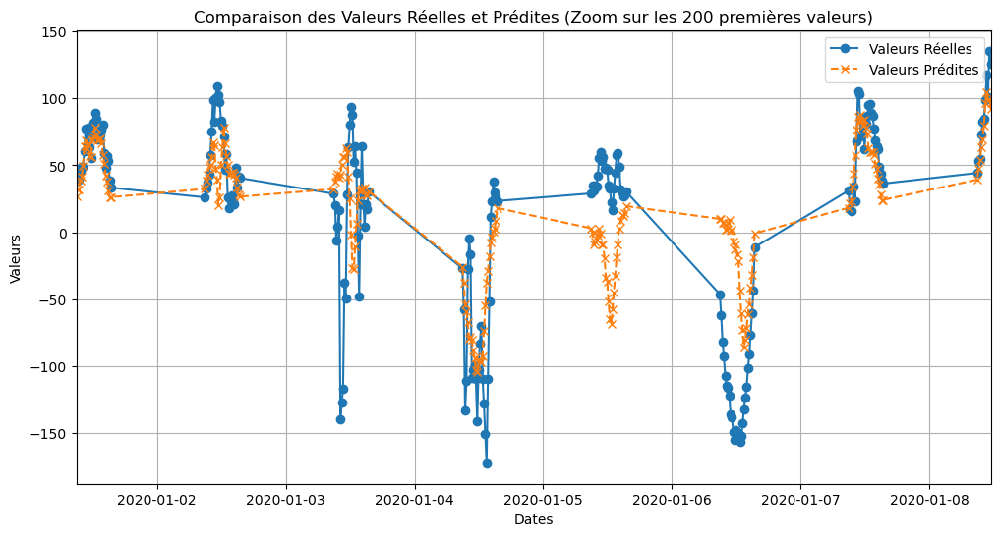

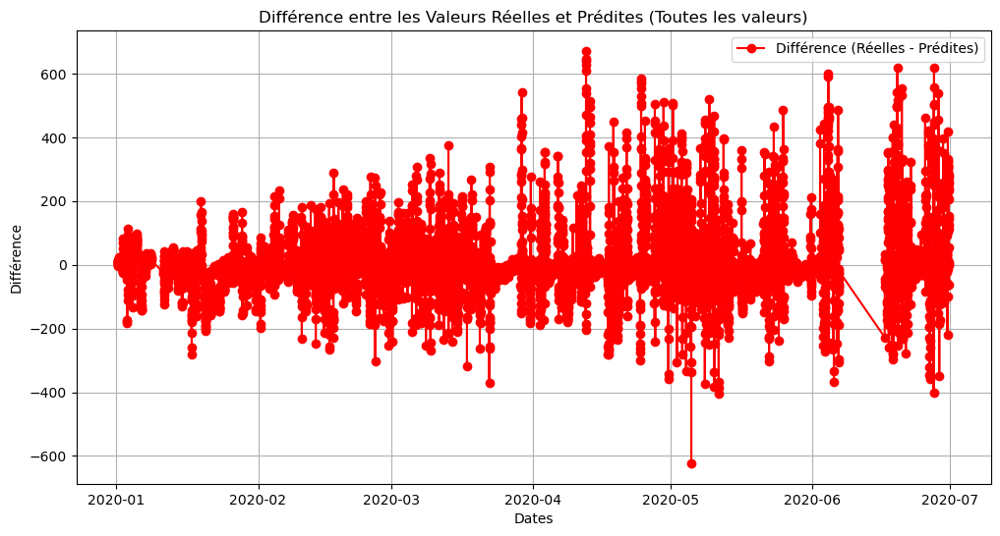

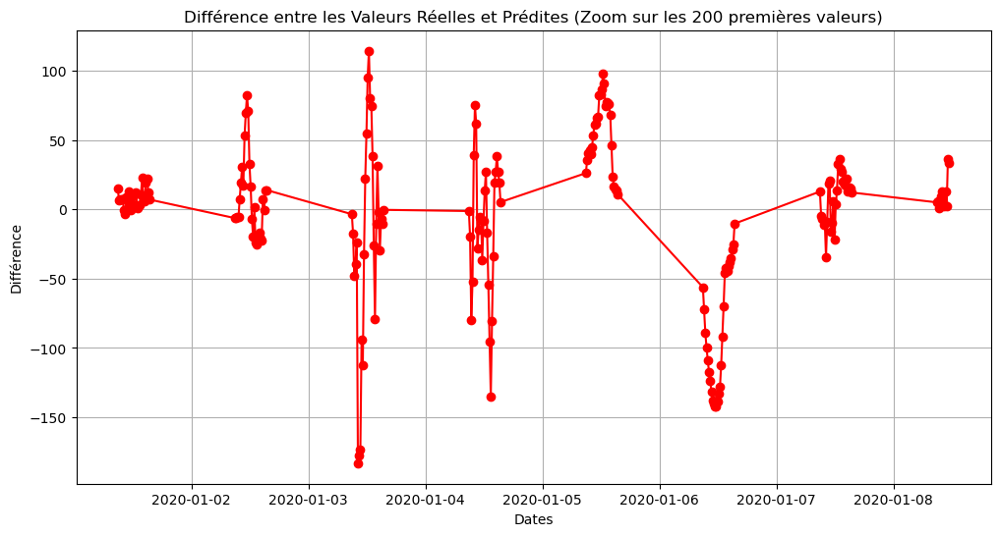

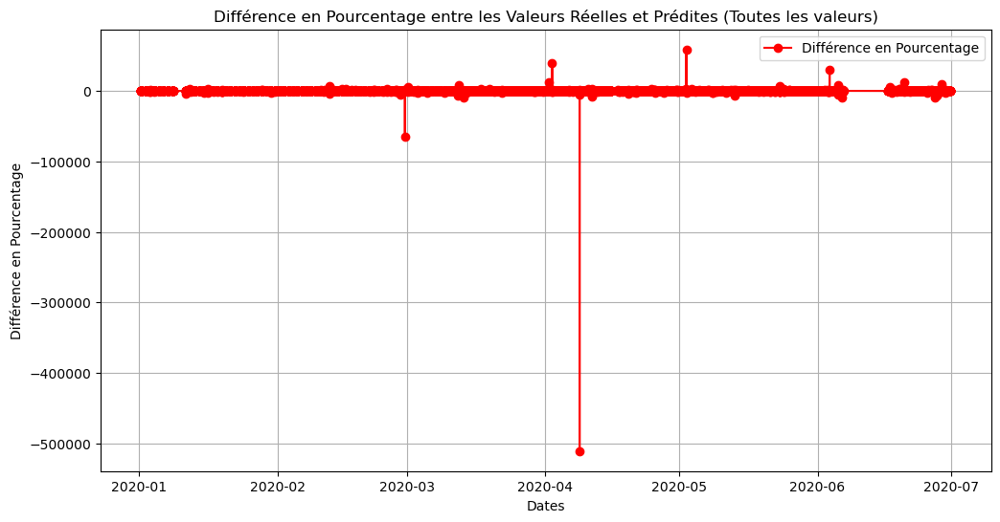

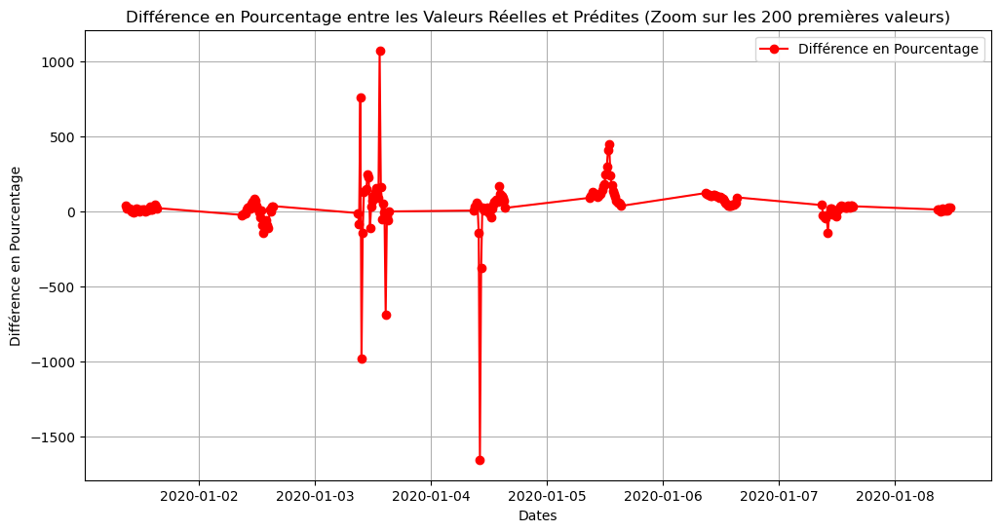

In [65]:
all_test_pred_graph(data_svr_lr[3],data_svr_lr[4])

#### Evaluation of GHI prediction using variation prediction

RandomForestRegressor()
MSE: 13431.552741340807
MAE: 72.21687014055428
R-squared: 0.7823548412773089
Distance DTW: 331110.75500788447


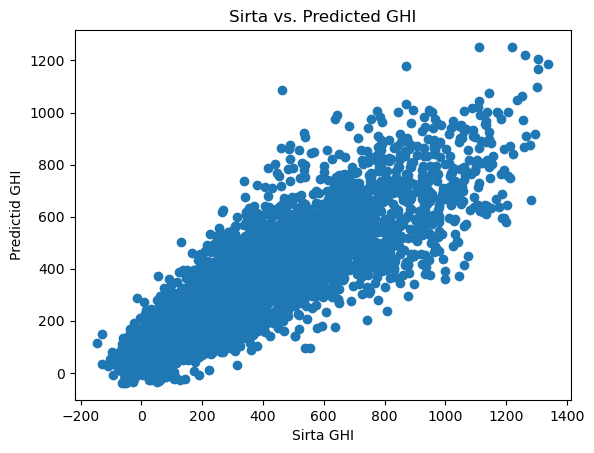

C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

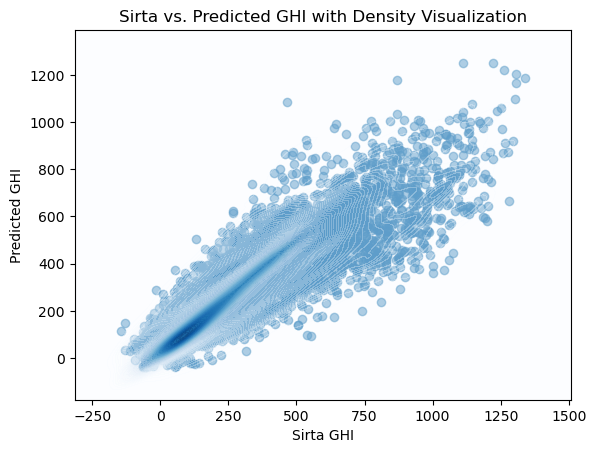

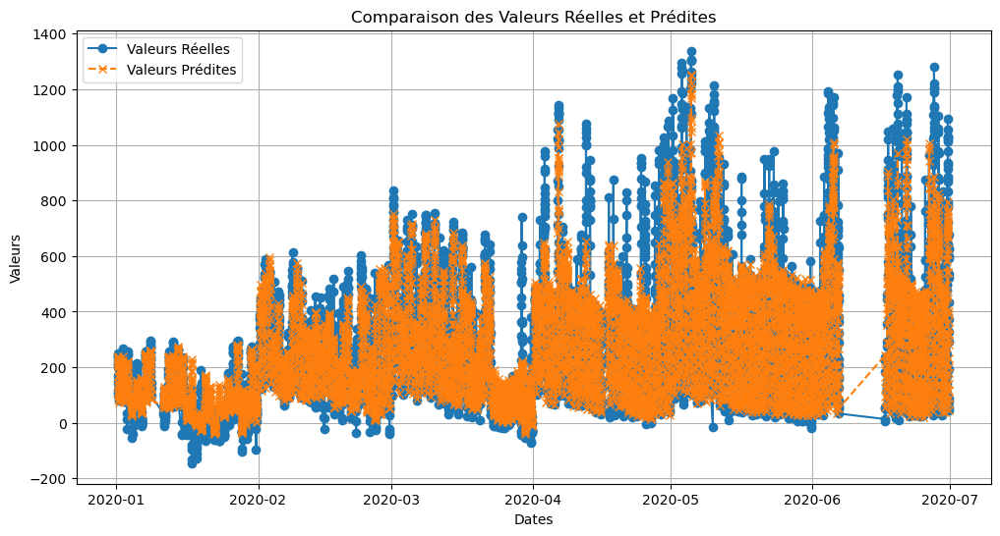

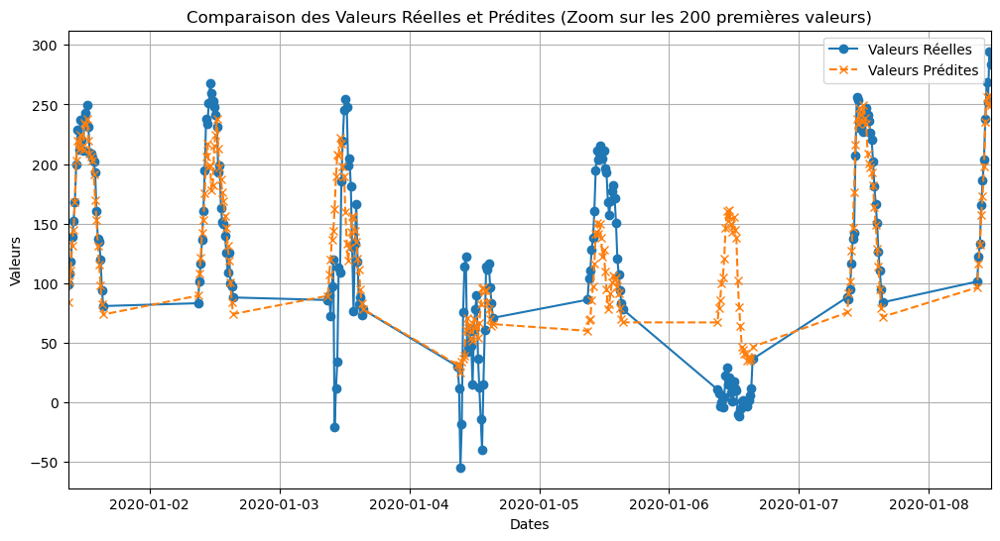

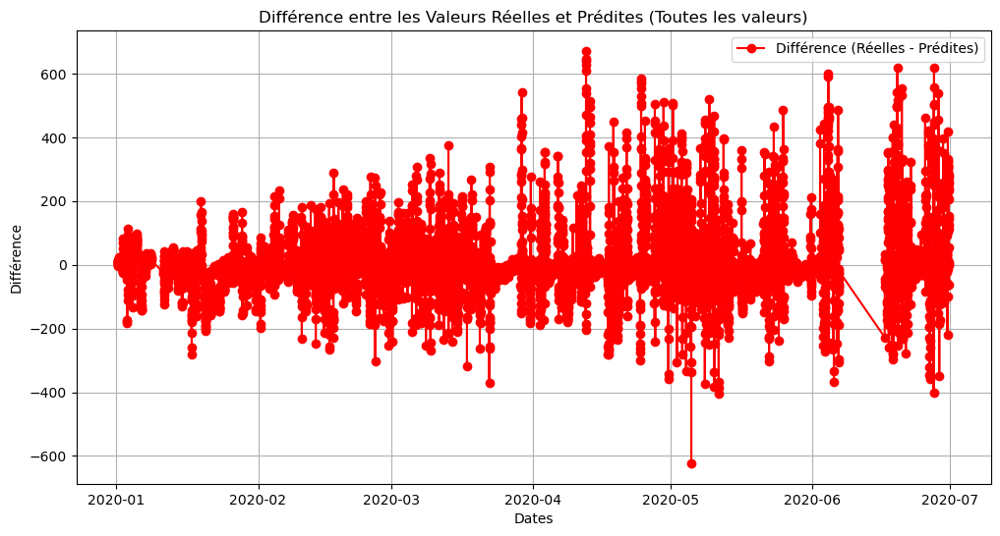

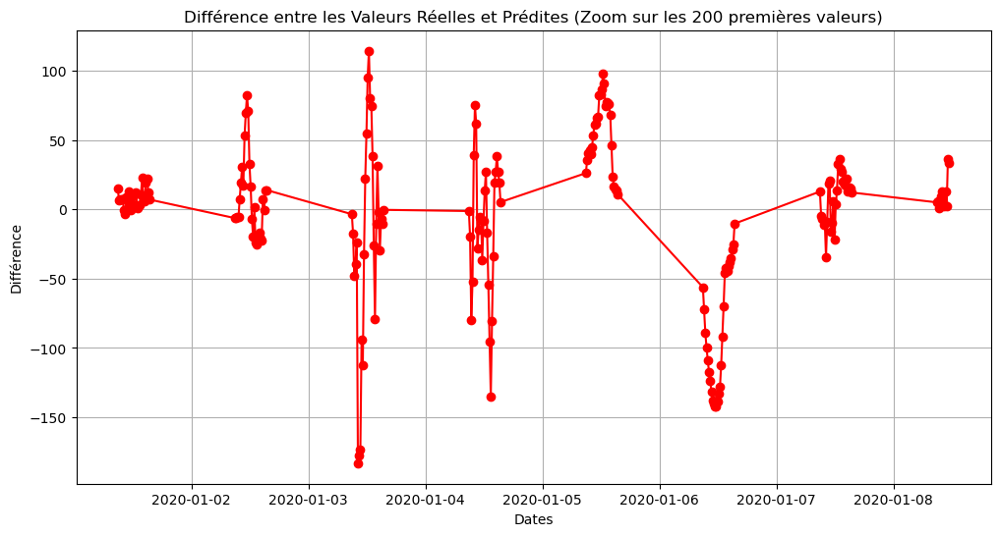

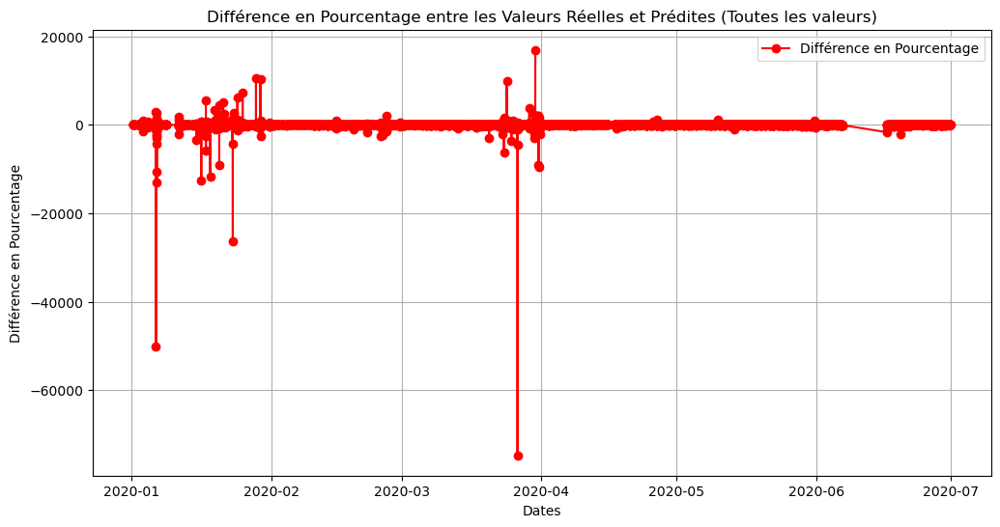

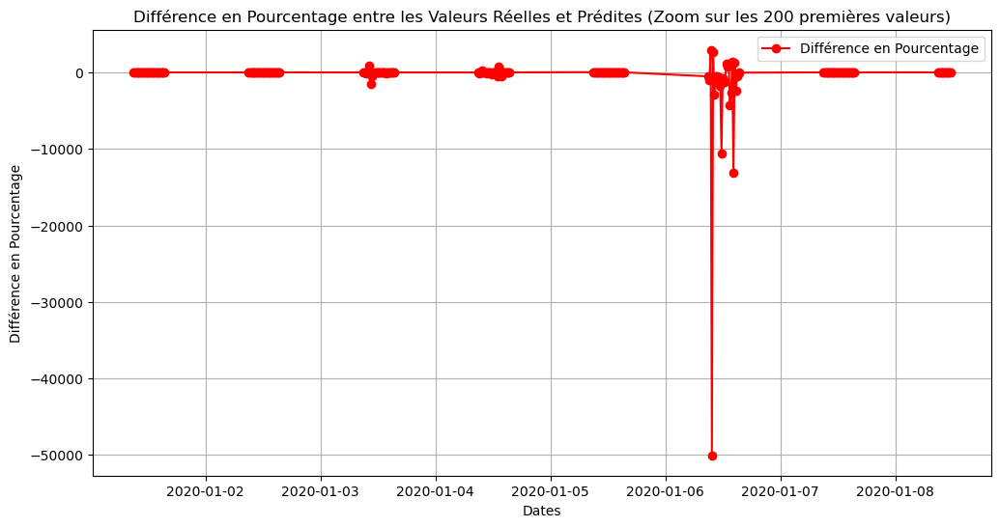

In [66]:
data_svr_lr_GHI_3=Var_to_GHI(data_svr_lr[3],df,'Monthly_Mean_Sirta_GHI')
data_svr_lr_GHI_4=Var_to_GHI(data_svr_lr[4],df,'Monthly_Mean_Sirta_GHI')
evaluate_algo(rfm,data_svr_lr_GHI_3,data_svr_lr_GHI_4)
scatter_test_pred(data_svr_lr_GHI_3,data_svr_lr_GHI_4)
scatter_test_pred_density(data_svr_lr_GHI_3,data_svr_lr_GHI_4)
all_test_pred_graph(data_svr_lr_GHI_3,data_svr_lr_GHI_4)

## Test val out of ordinary

I observed that some values have way bigger error than other. So I am looking for out of the ordinary values that could explain this phenomen.

In [67]:
diff=abs(data_svr_lr[4] - data_svr_lr[3])

In [68]:
df[df.index==diff.idxmax()]

,Sirta_GHI,Sat_GHI_T0+0,Clearsky_GHI,Arpege_GHI,SZA,Kc_Sat_mean,Kc_Sat_std,Kc_obs,Sat_GHI_T0+15,Sat_GHI_T0+30,...,Wreg_2.0,Wreg_3.0,Wreg_4.0,Sirta_GHI_T0-1j,Month,Hour,Minute,Monthly_Mean_Sirta_GHI,Seasonly_Mean_Sirta_GHI,Var_month
date,,,,,,,,,,,,,,,,,,,,,
2020-04-12 13:26:00,75.818,87.748118,749.545852,712.737423,44.380315,0.130842,0.101532,0.101152,67.459127,67.459127,...,False,False,False,790.482,4,13,26,559.675828,537.029741,483.857828


<Axes: xlabel='date'>

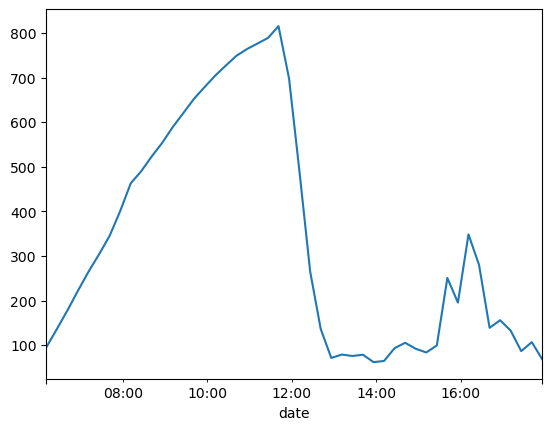

In [70]:
df[df.index.date == pd.to_datetime('2020-04-12').date()]['Sirta_GHI'].plot()

This big error is explain on 2020-04-12 with an unexpectide decrease of the GHI during the afternoon.

## Missing rows

Each day has a different number of register points depending of the month (more registration are made in summer). The idea is to add more points each day to have the exacte same number of datapoint everyday each at the same time.
This step was necessary to simplify the calculations of seasonal and month mean by hour of the day

In [72]:
df_cop=df.copy()
df_save=df.copy()

In [73]:
date_range=pd.date_range(start='2017-07-01 05:11:00',end='2020-06-30 19:11:00', freq='15T')
date_range=date_range[(date_range.hour >= 5) & (date_range.hour <= 19) & ((date_range.hour != 19) | (date_range.minute <= 11))]

In [75]:
df_cop=df_cop.reindex(date_range)
missing_val=df_cop[df_cop.isnull().any(axis=1)]
missing_val

,Sirta_GHI,Sat_GHI_T0+0,Clearsky_GHI,Arpege_GHI,SZA,Kc_Sat_mean,Kc_Sat_std,Kc_obs,Sat_GHI_T0+15,Sat_GHI_T0+30,...,Wreg_2.0,Wreg_3.0,Wreg_4.0,Sirta_GHI_T0-1j,Month,Hour,Minute,Monthly_Mean_Sirta_GHI,Seasonly_Mean_Sirta_GHI,Var_month
2017-07-17 15:11:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-07-17 15:26:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-07-17 15:41:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-07-17 15:56:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-07-19 05:11:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-06-26 06:26:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-06-26 06:41:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-06-26 06:56:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-06-26 07:11:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


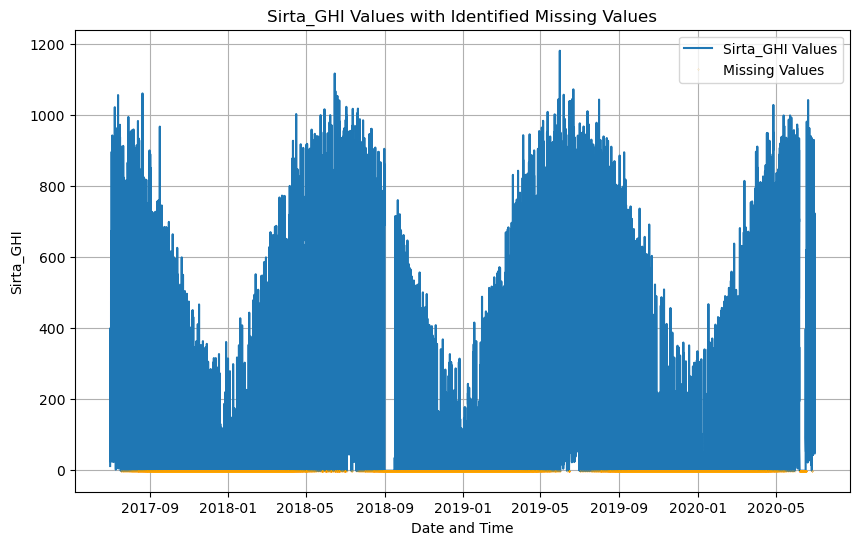

In [133]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))

# Plot the values of Sirta_GHI
# Replace NaN values with -1 in your DataFrame
df_cop['Sirta_GHI'].fillna(-1, inplace=True)

plt.plot(df_cop.index, df_cop['Sirta_GHI'], markersize=4, label='Sirta_GHI Values')

# Identify missing values and plot them with orange points
valeurs_manquantes = df_cop[df_cop['Sirta_GHI'] == -1].index

plt.plot(valeurs_manquantes, df_cop['Sirta_GHI'][valeurs_manquantes], 'o', color='orange', markersize=0.1, label='Missing Values')

# Customize the plot
plt.title('Sirta_GHI Values with Identified Missing Values')
plt.xlabel('Date and Time')
plt.ylabel('Sirta_GHI')
plt.legend()
plt.grid(True)

# Show the plot
plt.show()


In [117]:
df_cop['Sirta_GHI'].replace(-1, 'nan', inplace=True)

In [149]:
df_cop.isna().sum()

Sirta_GHI                  17979
Sat_GHI_T0+0               17979
Clearsky_GHI               17979
Arpege_GHI                 17979
SZA                        17979
Kc_Sat_mean                17979
Kc_Sat_std                 17979
Kc_obs                     17979
Sat_GHI_T0+15              17979
Sat_GHI_T0+30              17979
Sat_GHI_T0+45              17979
Sat_GHI_T0+60              17979
Sat_GHI_T0+75              17979
Sat_GHI_T0+90              17979
Sat_GHI_T0+105             17979
Sat_GHI_T0+120             17979
Sat_GHI_T0+135             17979
Sat_GHI_T0+150             17979
Sat_GHI_T0+165             17979
Sat_GHI_T0+180             17979
Sat_GHI_T0+195             17979
Sat_GHI_T0+210             17979
Sat_GHI_T0+225             17979
Sat_GHI_T0+240             17979
Sat_GHI_T0+255             17979
Sat_GHI_T0+270             17979
Sat_GHI_T0+285             17979
Sat_GHI_T0+300             17979
Sat_GHI_T0+315             17979
Sat_GHI_T0+330             17979
Sat_GHI_T0

In [165]:
missing_values_per_hour_per_month=df_cop['Sirta_GHI'].isna().groupby([df_cop.index.month,df_cop.index.hour]).sum()
missing_values_per_hour_per_month[1]

5     372
6     372
7     372
8     267
9       8
10      8
11      8
12      8
13      8
14      8
15     95
16    364
17    372
18    372
19     93
Name: Sirta_GHI, dtype: int64

In [103]:
df_cop['Season'] = (df_cop.index.month % 12 + 3) // 3
df_filtered = df_cop[df_cop.index.year != 2020]
df_cop['Monthly_Mean_Sirta_GHI'] = df_filtered.groupby(['Month', 'Hour', 'Minute'])['Sirta_GHI'].transform('mean')
df_cop['Seasonly_Mean_Sirta_GHI'] = df_filtered.groupby(['Season', 'Hour', 'Minute'])['Sirta_GHI'].transform('mean')
df_cop['Monthly_Mean_Sirta_GHI'] = df_cop['Monthly_Mean_Sirta_GHI'].fillna(df_cop['Monthly_Mean_Sirta_GHI'].shift(20805))
df_cop['Seasonly_Mean_Sirta_GHI'] = df_cop['Seasonly_Mean_Sirta_GHI'].fillna(df_cop['Seasonly_Mean_Sirta_GHI'].shift(20805))
df_cop.drop('Season',axis=1,inplace=True)

In [105]:
df_cop.dropna()

,Sirta_GHI,Sat_GHI_T0+0,Clearsky_GHI,Arpege_GHI,SZA,Kc_Sat_mean,Kc_Sat_std,Kc_obs,Sat_GHI_T0+15,Sat_GHI_T0+30,...,Wreg_1.0,Wreg_2.0,Wreg_3.0,Wreg_4.0,Sirta_GHI_T0-1j,Month,Hour,Minute,Monthly_Mean_Sirta_GHI,Seasonly_Mean_Sirta_GHI
2017-07-01 05:11:00,12.172667,46.639333,119.292611,11.261829,79.702292,0.389356,0.100030,0.102040,0.000000,0.000000,...,False,True,False,False,0.000000,7.0,5.0,11.0,61.377902,73.260059
2017-07-01 05:26:00,16.694667,46.641917,156.593875,13.609398,77.410452,0.235036,0.071296,0.106611,60.436766,0.000000,...,False,True,False,False,0.000000,7.0,5.0,26.0,81.923198,91.354754
2017-07-01 05:41:00,30.220667,34.287182,195.732357,18.504805,75.078445,0.195269,0.036872,0.154398,48.905194,68.602462,...,False,True,False,False,0.000000,7.0,5.0,41.0,110.753384,109.724050
2017-07-01 05:56:00,46.928667,52.639118,236.267183,24.326697,72.711278,0.267614,0.051194,0.198625,37.655484,64.199038,...,False,True,False,False,0.000000,7.0,5.0,56.0,138.794949,126.735470
2017-07-01 06:11:00,50.004667,73.049175,277.824905,30.148590,70.313885,0.204141,0.053714,0.179986,83.924422,40.746849,...,False,True,False,False,0.000000,7.0,6.0,11.0,169.145928,148.109850
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-06-30 18:11:00,105.317333,110.366861,221.350095,141.104689,75.374674,0.554589,0.115206,0.475795,105.263515,117.650883,...,False,True,False,False,220.952000,6.0,18.0,11.0,146.005211,122.183520
2020-06-30 18:26:00,193.562667,145.358405,181.596414,114.003559,77.702599,0.904981,0.113562,1.065895,116.327328,116.233687,...,False,True,False,False,182.198667,6.0,18.0,26.0,113.608932,100.203170
2020-06-30 18:41:00,100.916667,142.315518,143.412732,89.045628,79.989712,0.860305,0.135666,0.703680,112.521938,80.869152,...,False,True,False,False,104.061333,6.0,18.0,41.0,85.822961,80.447861
2020-06-30 18:56:00,67.522667,97.669254,107.273990,64.623497,82.230881,0.716394,0.096471,0.629441,83.699112,55.316036,...,False,True,False,False,67.941333,6.0,18.0,56.0,60.250480,63.480280


In [72]:
df=df.join(df_cop['Monthly_Mean_Sirta_GHI'])
df=df.join(df_cop['Seasonly_Mean_Sirta_GHI'])

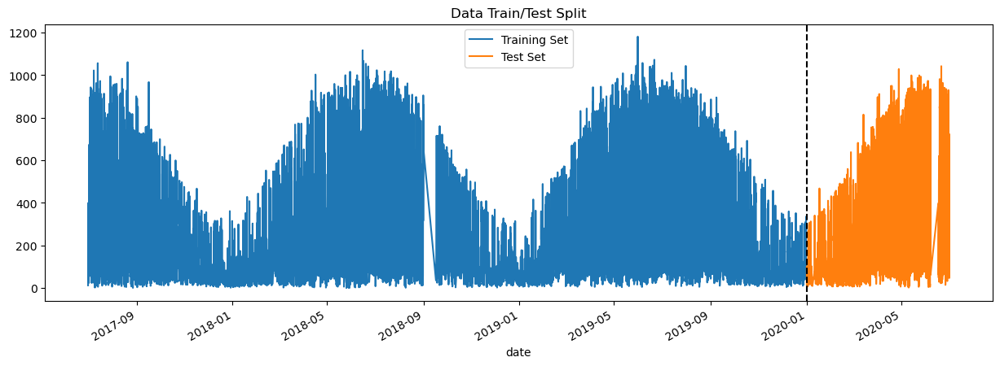

In [74]:
df_train_mean = df.loc[df.index<'01-01-2020'][columns_selection([360],date_means=True)]
df_test_mean = df.loc[df.index >= '01-01-2020'][columns_selection([360],date_means=True)]
fig, ax = plt.subplots(figsize=(15, 5))
df_train_mean['Sirta_GHI'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
df_test_mean['Sirta_GHI'].plot(ax=ax, label='Test Set')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

### RFM

RandomForestRegressor()
MSE: 14865.243641567236
MAE: 89.76493761899663
R-squared: 0.7869675396362155
Distance DTW: 500297.5984943015


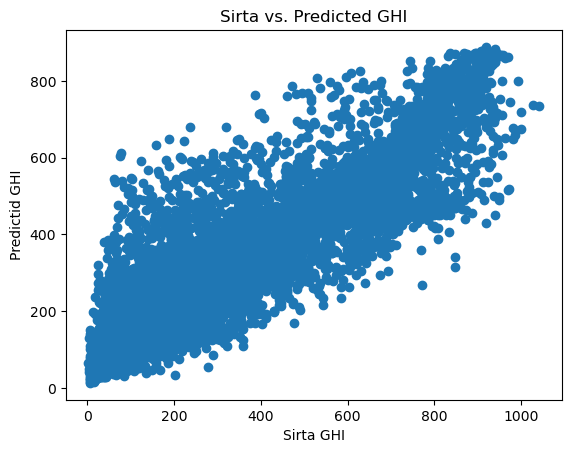

In [75]:
rfm=RandomForestRegressor()
data_rfm=model_fit_prediction(df_train_mean,df_test_mean,rfm)
evaluate_algo(rfm,data_rfm[3],data_rfm[4])
scatter_test_pred(data_rfm[3],data_rfm[4])

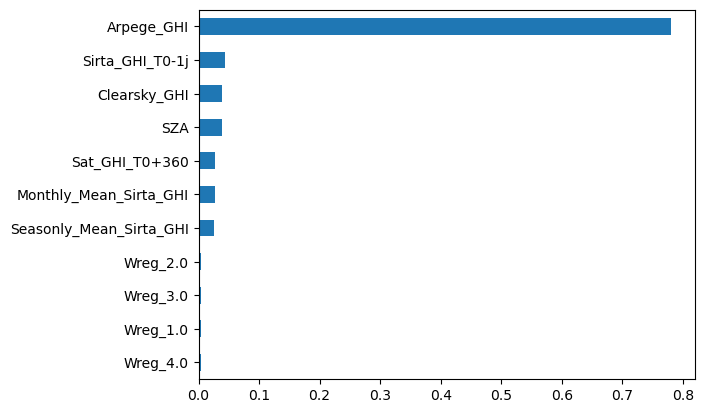

In [76]:
features_importance(data_rfm[5], data_rfm[0])

We can see that the means are not more used than before.

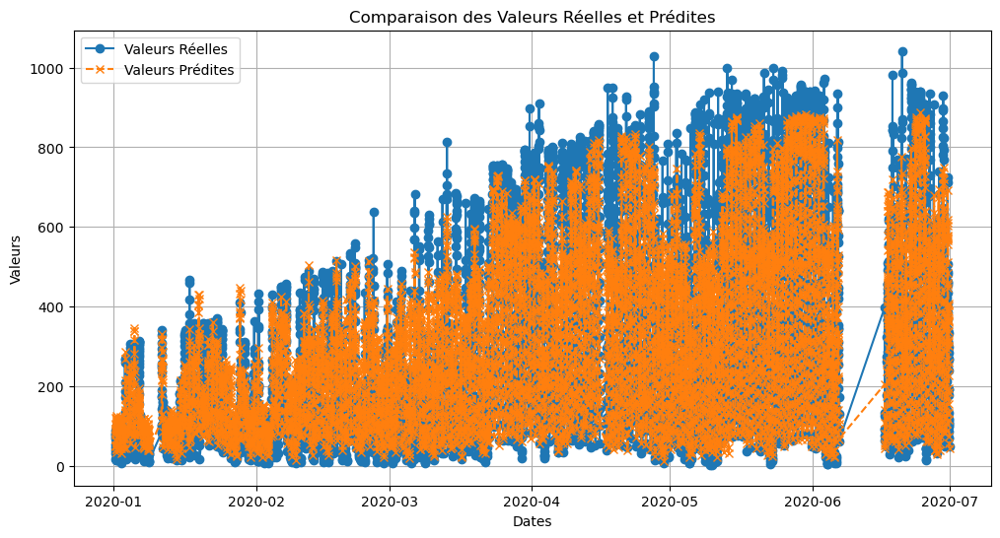

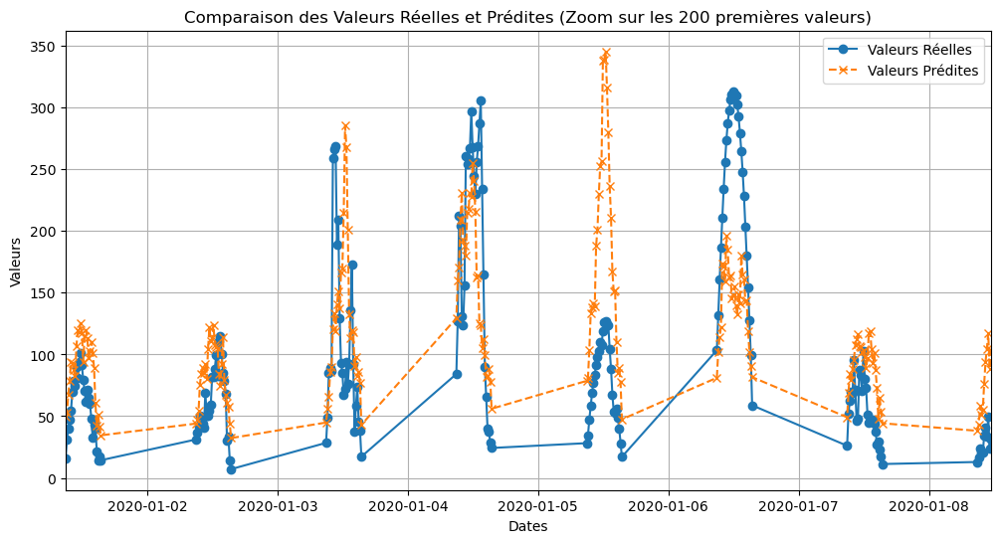

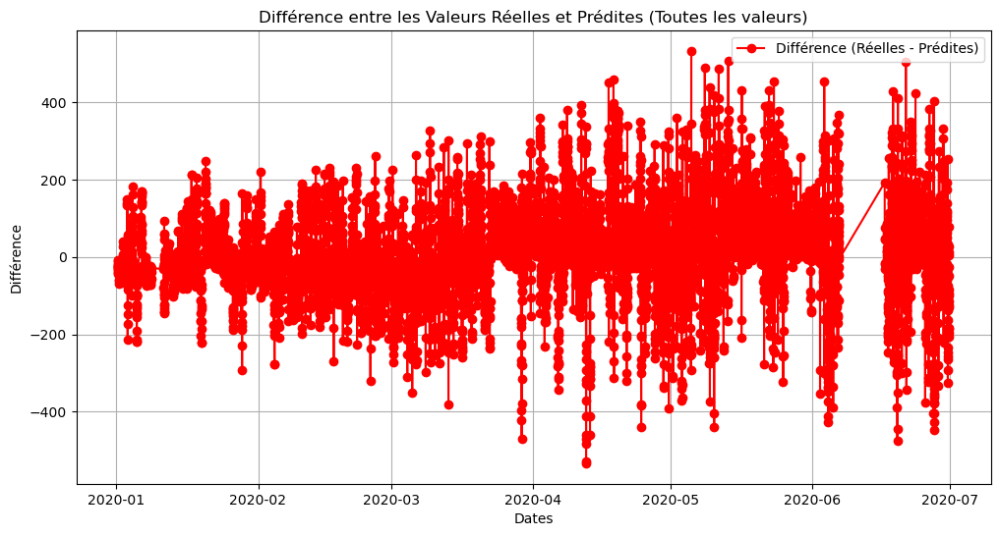

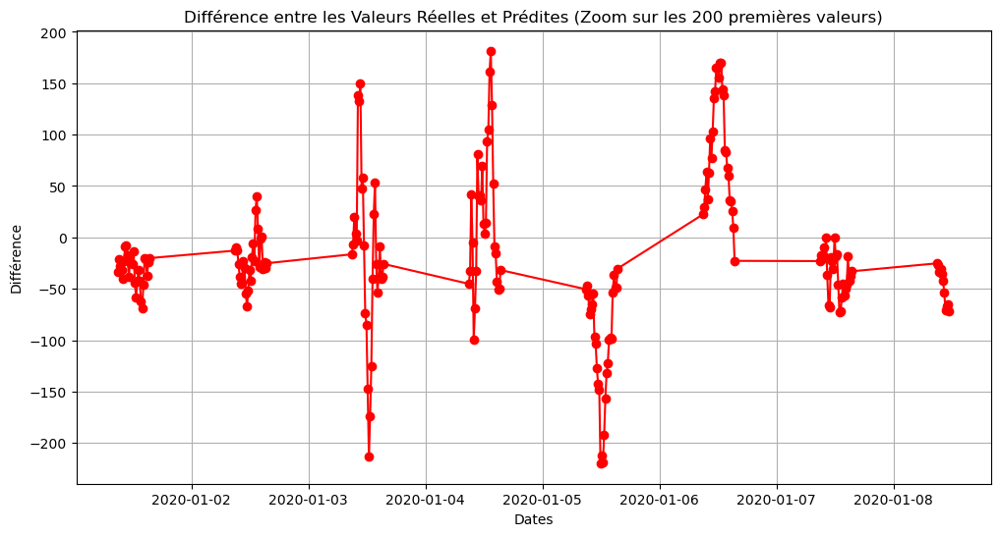

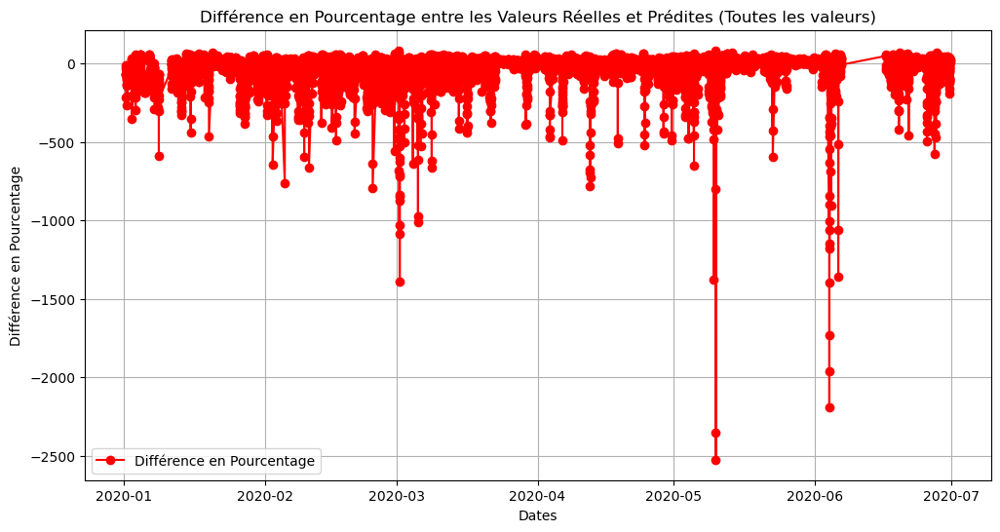

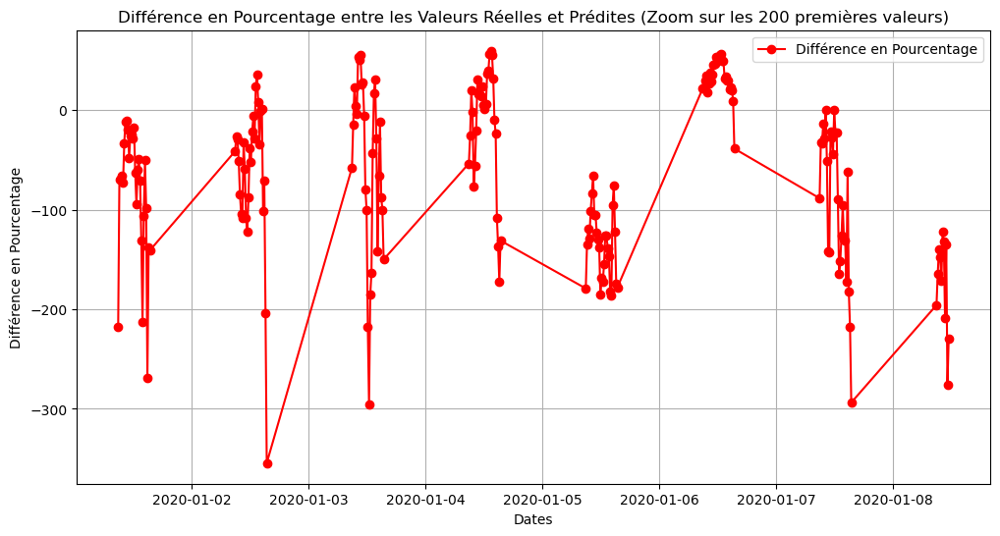

In [77]:
all_test_pred_graph(data_rfm[3],data_rfm[4])

# Add statistics about Arpege

In this part we will add different data statistics variables and then see if they are usefull in our prediction.

## Monthly and Seasonly mean of Sirta

In [38]:
df=add_columns_stats(df,['Sirta_GHI'],['mean'])

In [ ]:
df_train_mean = df.loc[df.index<'01-01-2020'][columns_selection([360],date_means=True)]
df_test_mean = df.loc[df.index >= '01-01-2020'][columns_selection([360],date_means=True)]
fig, ax = plt.subplots(figsize=(15, 5))
df_train_mean['Sirta_GHI'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
df_test_mean['Sirta_GHI'].plot(ax=ax, label='Test Set')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

### RFM

RandomForestRegressor()
MSE: 15324.789598133155
MAE: 91.59990293886116
R-squared: 0.780381828151224
Distance DTW: 530880.8738851319


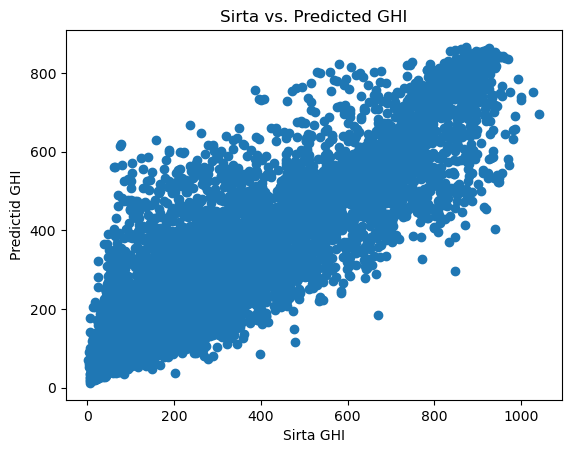

In [40]:
rfm=RandomForestRegressor()
data_rfm=model_fit_prediction(df_train_mean,df_test_mean,rfm)
evaluate_algo(rfm,data_rfm[3],data_rfm[4])
scatter_test_pred(data_rfm[3],data_rfm[4])

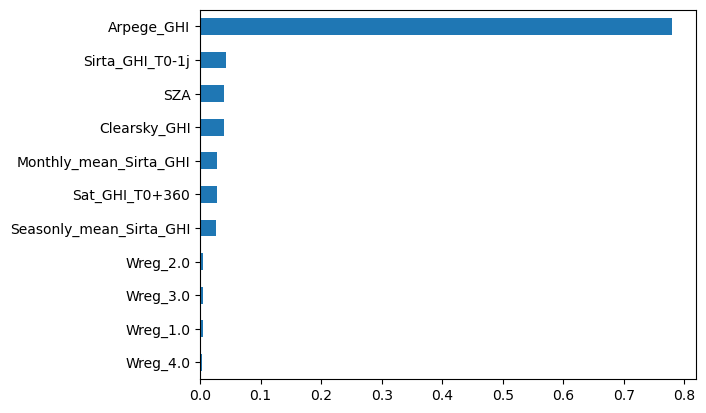

In [41]:
features_importance(data_rfm[5], data_rfm[0])

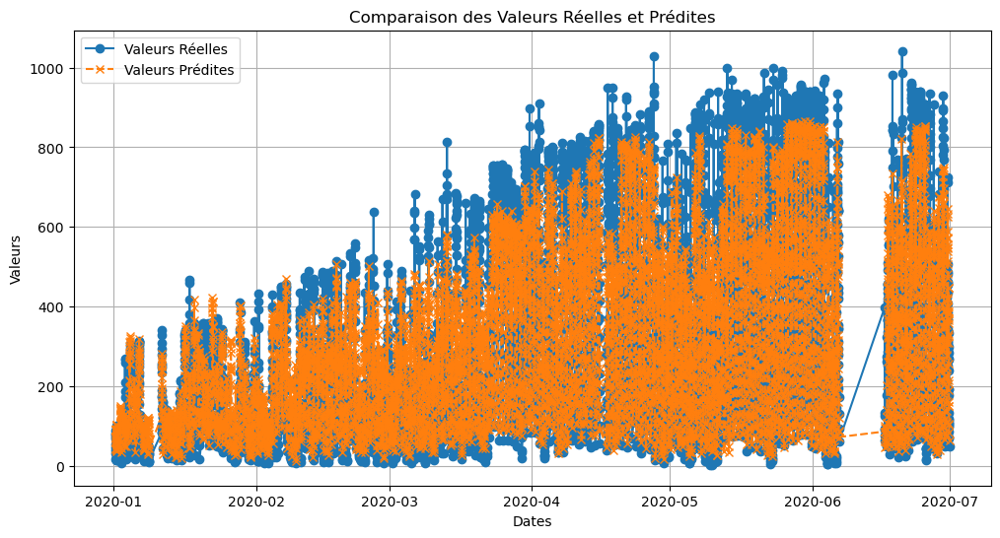

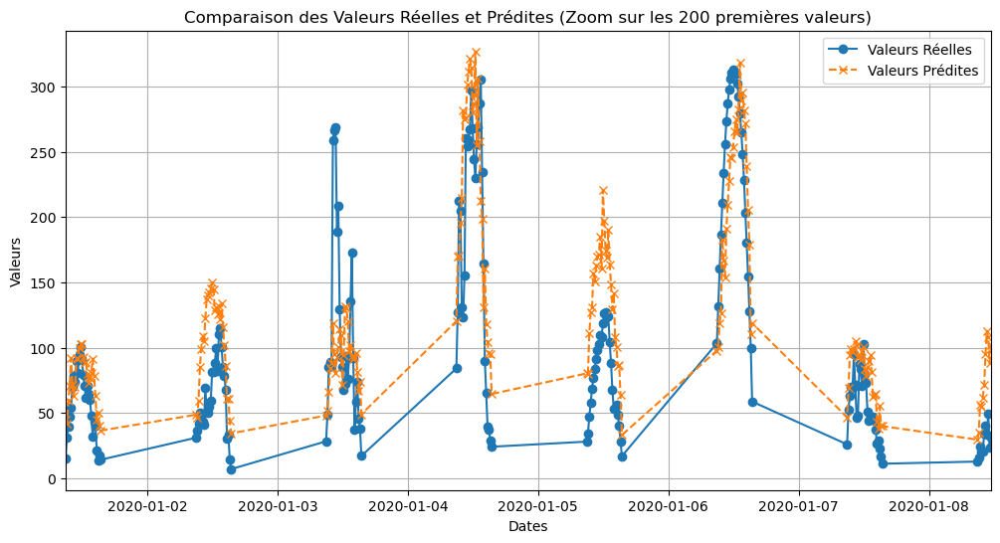

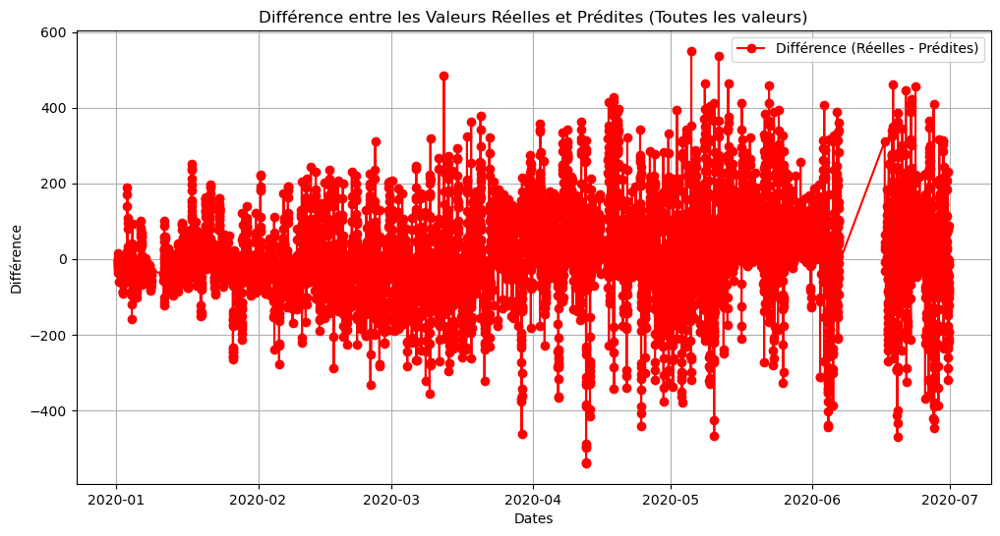

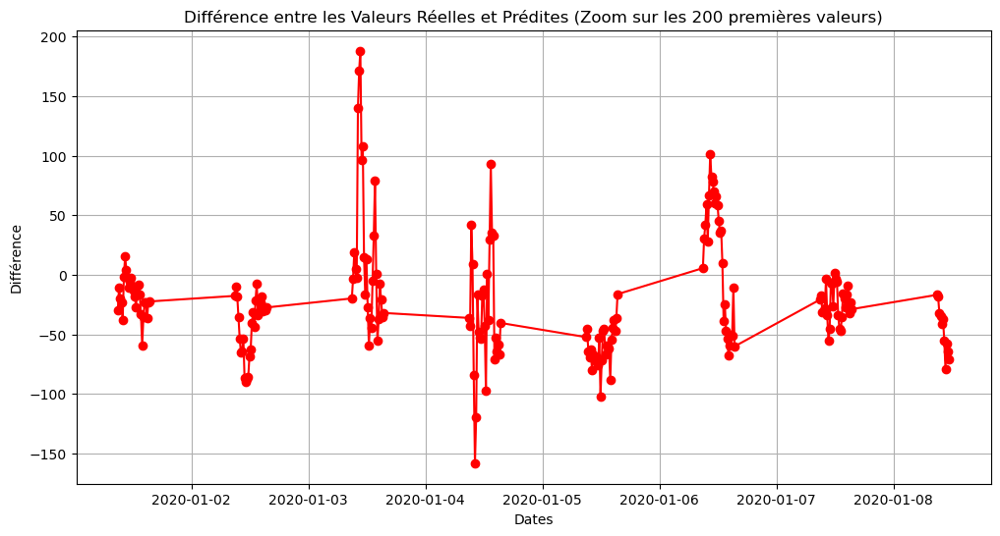

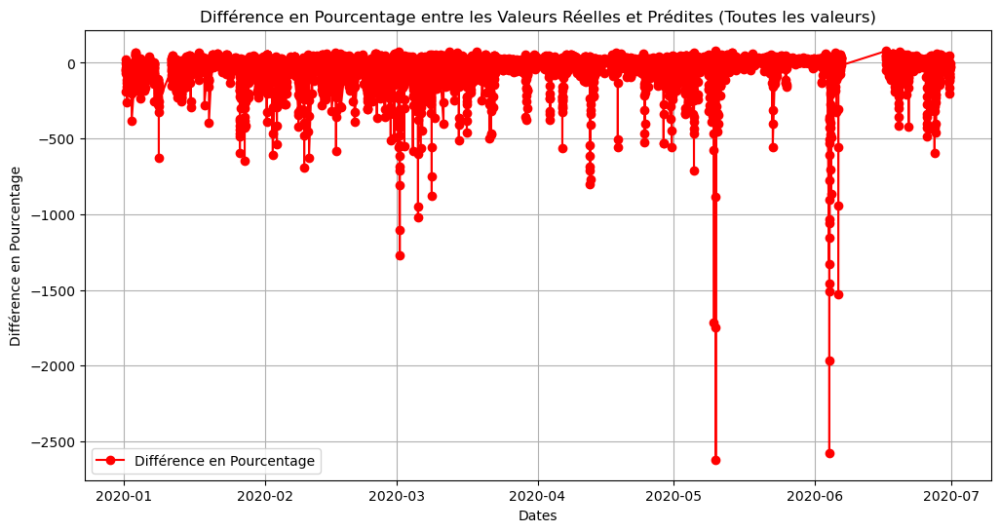

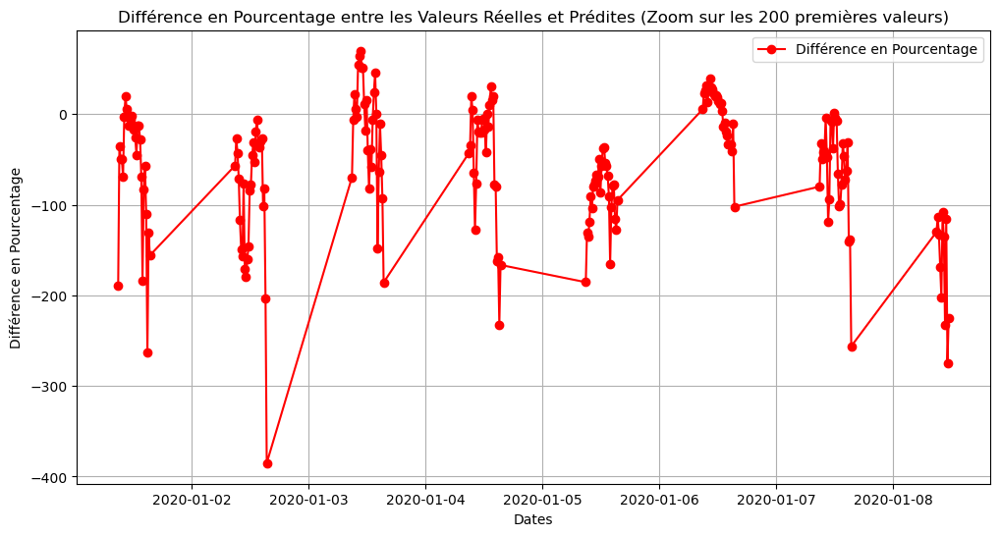

In [42]:
all_test_pred_graph(data_rfm[3],data_rfm[4])

## Monthly and Seasonly std of Sirta

In [43]:
df=add_columns_stats(df,['Sirta_GHI'],['std'])

In [39]:
df.columns

Index(['Sirta_GHI', 'Sat_GHI_T0+0', 'Clearsky_GHI', 'Arpege_GHI', 'SZA',
       'Kc_Sat_mean', 'Kc_Sat_std', 'Kc_obs', 'Sat_GHI_T0+15', 'Sat_GHI_T0+30',
       'Sat_GHI_T0+45', 'Sat_GHI_T0+60', 'Sat_GHI_T0+75', 'Sat_GHI_T0+90',
       'Sat_GHI_T0+105', 'Sat_GHI_T0+120', 'Sat_GHI_T0+135', 'Sat_GHI_T0+150',
       'Sat_GHI_T0+165', 'Sat_GHI_T0+180', 'Sat_GHI_T0+195', 'Sat_GHI_T0+210',
       'Sat_GHI_T0+225', 'Sat_GHI_T0+240', 'Sat_GHI_T0+255', 'Sat_GHI_T0+270',
       'Sat_GHI_T0+285', 'Sat_GHI_T0+300', 'Sat_GHI_T0+315', 'Sat_GHI_T0+330',
       'Sat_GHI_T0+345', 'Sat_GHI_T0+360', 'Wreg_1.0', 'Wreg_2.0', 'Wreg_3.0',
       'Wreg_4.0', 'Sirta_GHI_T0-1j', 'Month', 'Hour', 'Minute',
       'Monthly_std_Sirta_GHI', 'Seasonly_std_Sirta_GHI'],
      dtype='object')

In [ ]:
df_train_mean = df.loc[df.index<'01-01-2020'][columns_selection([360],date_means=True,std_Sirta=True)]
df_test_mean = df.loc[df.index >= '01-01-2020'][columns_selection([360],date_means=True,std_Sirta=True)]
fig, ax = plt.subplots(figsize=(15, 5))
df_train_mean['Sirta_GHI'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
df_test_mean['Sirta_GHI'].plot(ax=ax, label='Test Set')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

RandomForestRegressor()
MSE: 15996.47905304801
MAE: 94.58802247699748
R-squared: 0.770755907404066
Distance DTW: 543813.6225637867


C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

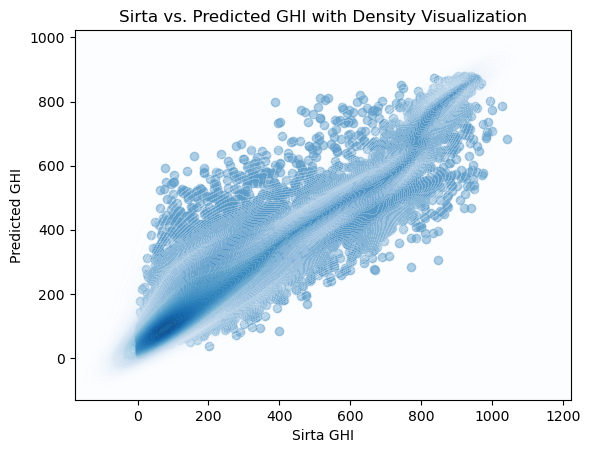

In [192]:
rfm=RandomForestRegressor()
data_rfm=model_fit_prediction(df_train_mean,df_test_mean,rfm)
evaluate_algo(rfm,data_rfm[3],data_rfm[4])
scatter_test_pred_density(data_rfm[3],data_rfm[4])

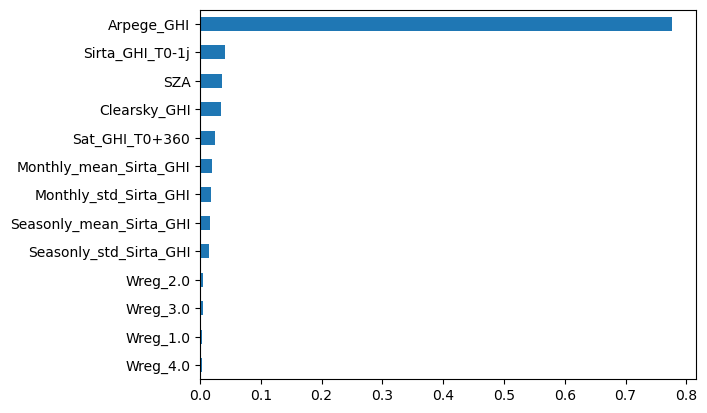

In [193]:
features_importance(data_rfm[5], data_rfm[0])

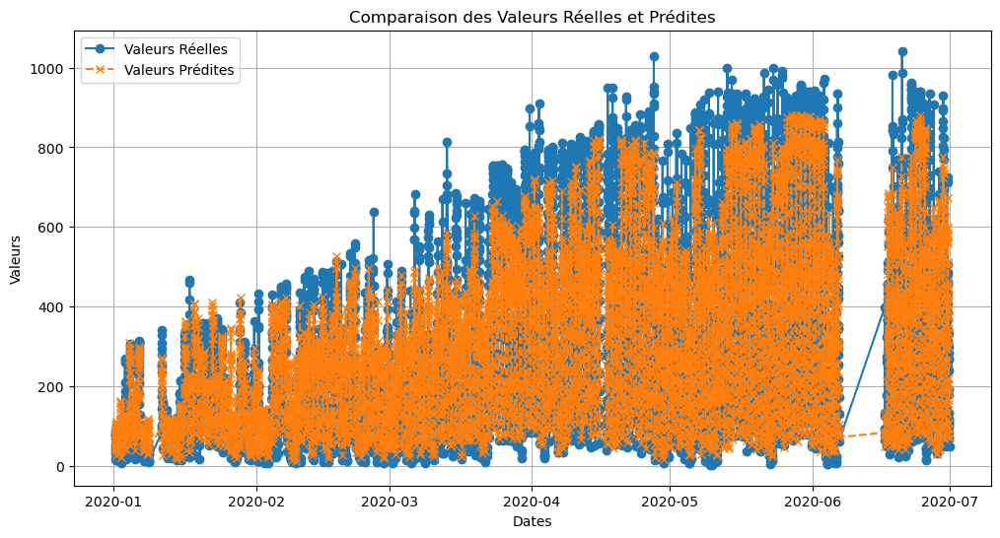

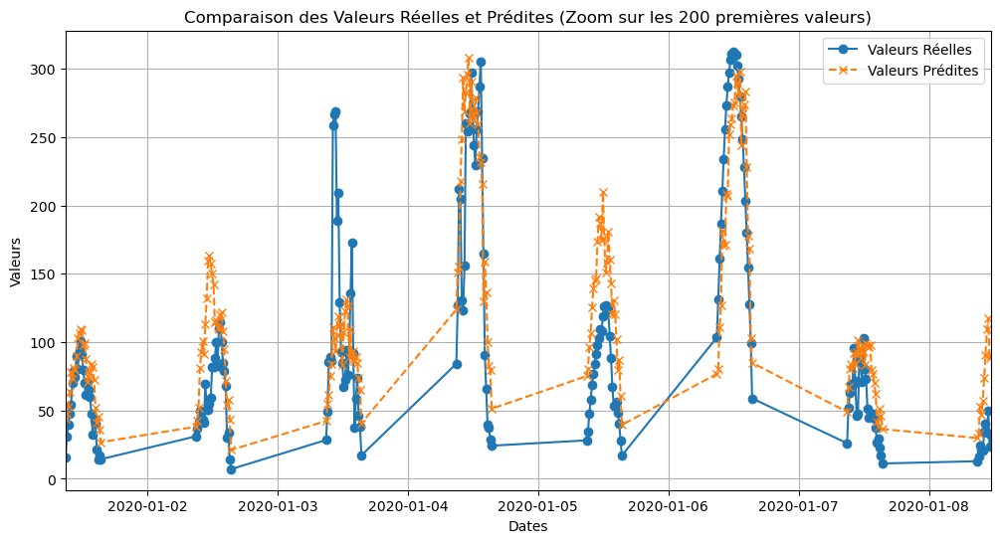

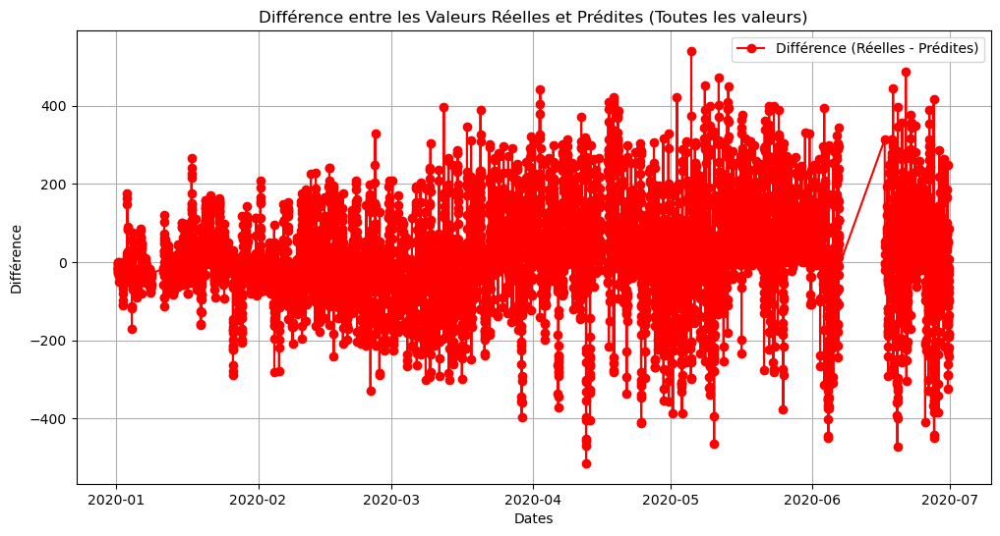

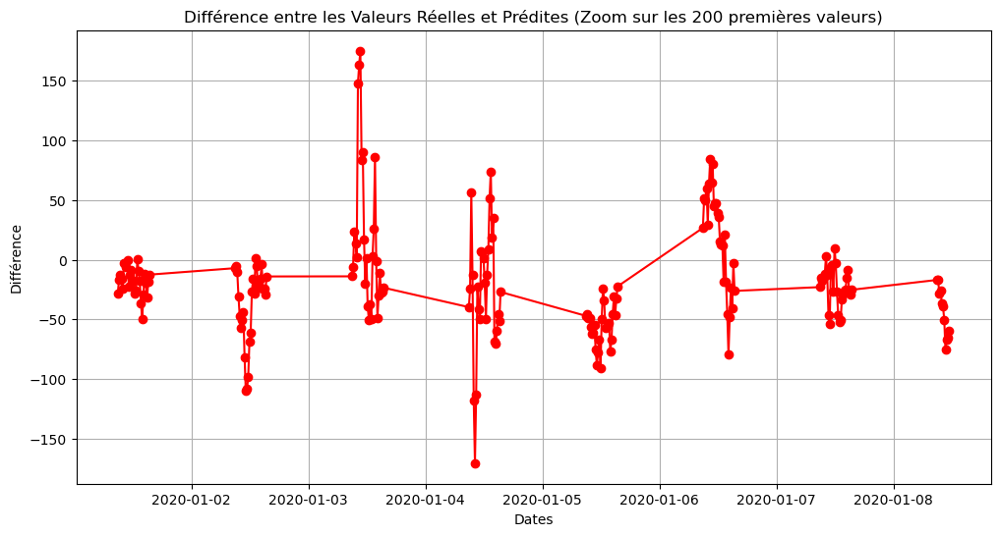

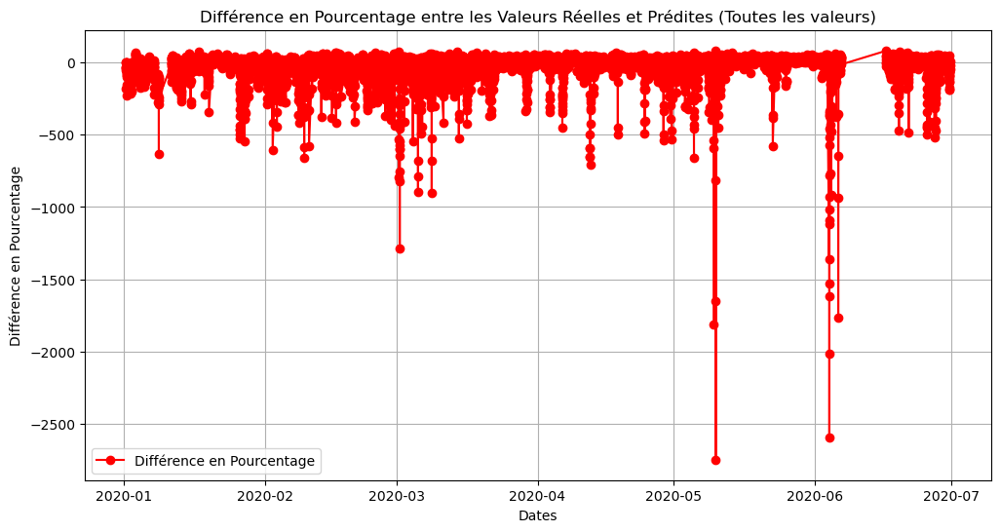

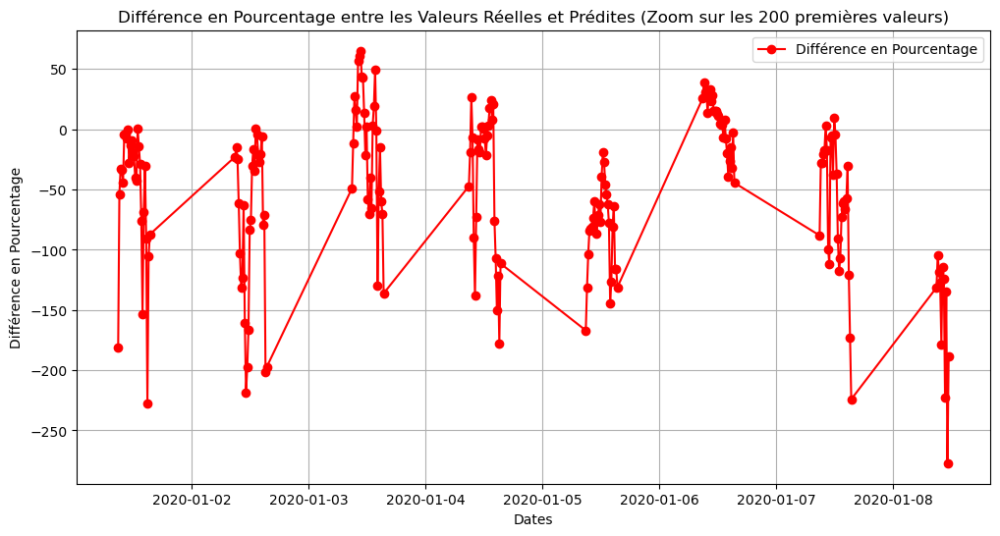

In [194]:
all_test_pred_graph(data_rfm[3],data_rfm[4])

### Without means

In [ ]:
df_train_mean = df.loc[df.index<'01-01-2020'][columns_selection([360],std_Sirta=True)]
df_test_mean = df.loc[df.index >= '01-01-2020'][columns_selection([360],std_Sirta=True)]
fig, ax = plt.subplots(figsize=(15, 5))
df_train_mean['Sirta_GHI'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
df_test_mean['Sirta_GHI'].plot(ax=ax, label='Test Set')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

RandomForestRegressor()
MSE: 16024.277745590332
MAE: 91.96473918426567
R-squared: 0.770357526858817
Distance DTW: 453470.2831790344


C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

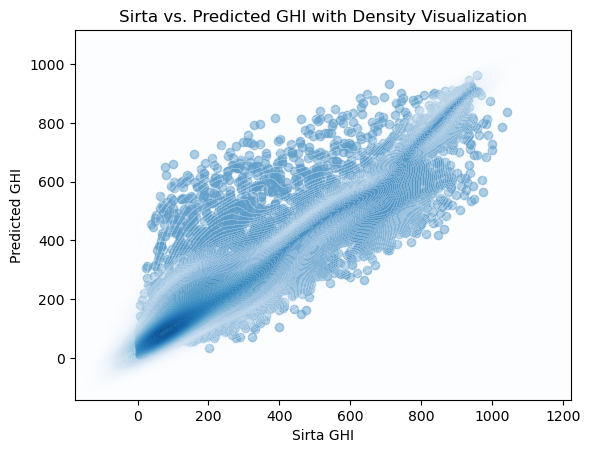

In [41]:
rfm=RandomForestRegressor()
data_rfm=model_fit_prediction(df_train_mean,df_test_mean,rfm)
evaluate_algo(rfm,data_rfm[3],data_rfm[4])
scatter_test_pred_density(data_rfm[3],data_rfm[4])

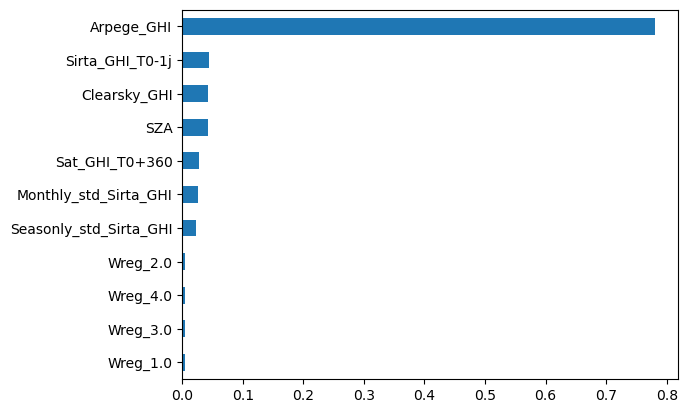

In [42]:
features_importance(data_rfm[5], data_rfm[0])

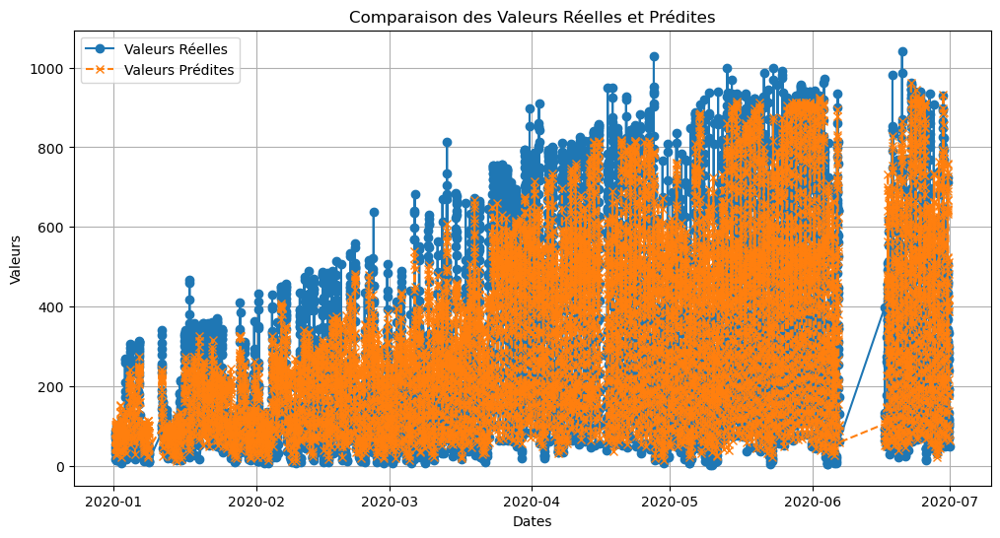

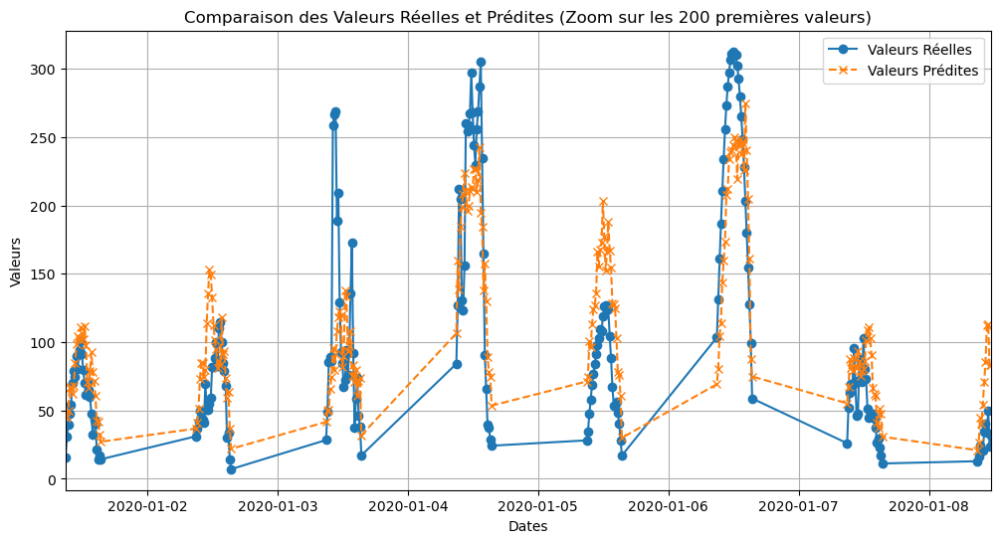

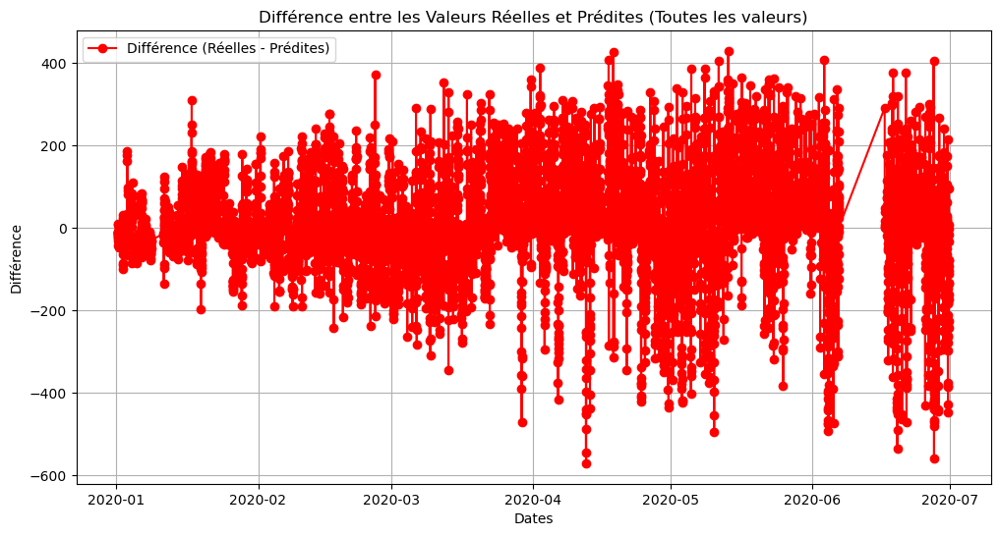

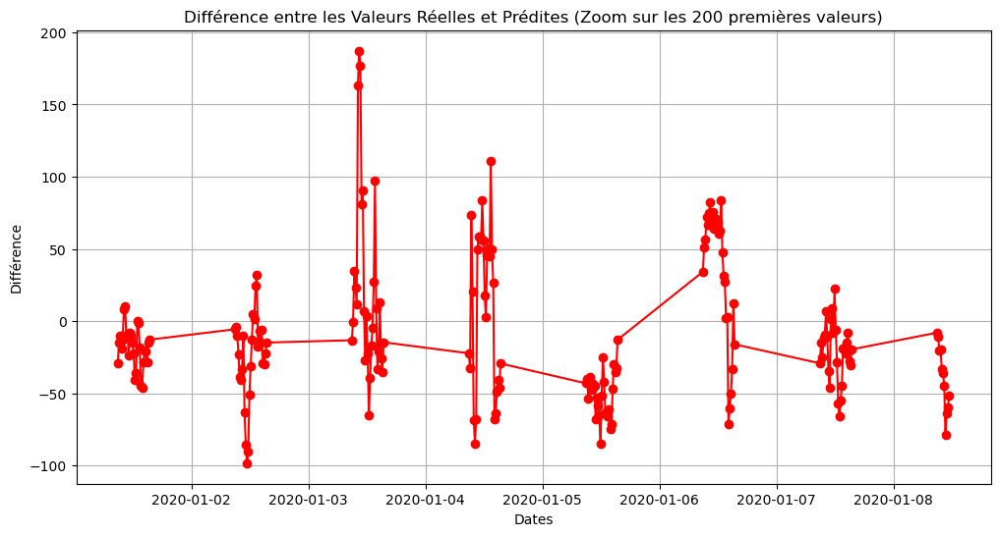

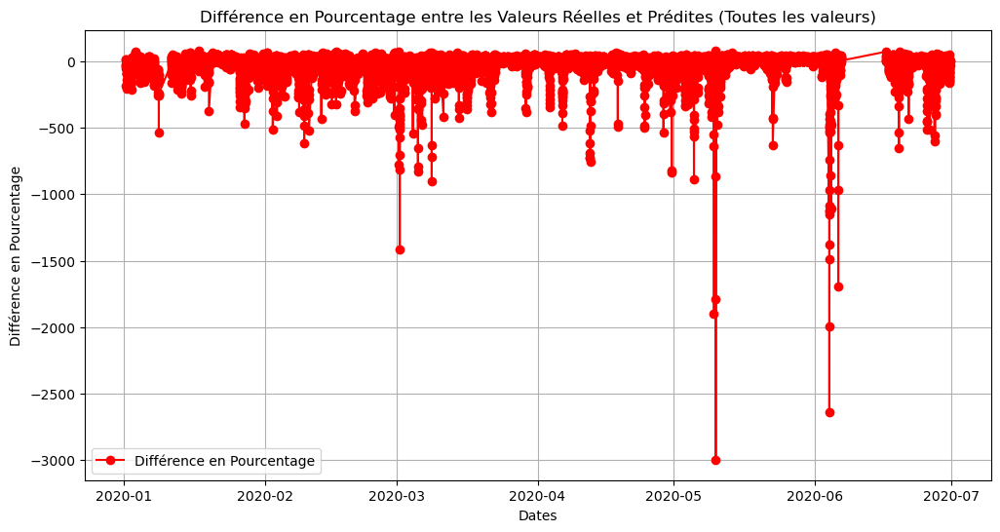

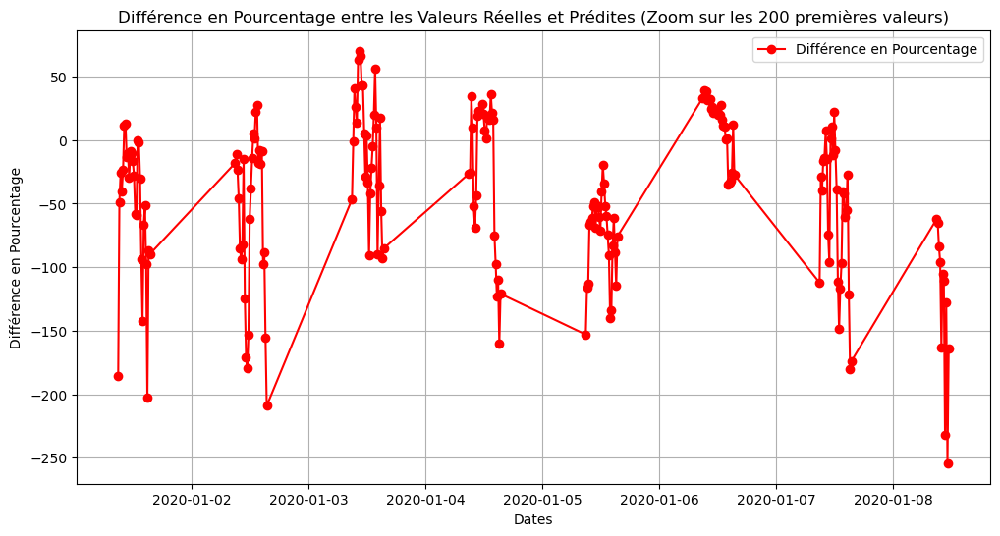

In [43]:
all_test_pred_graph(data_rfm[3],data_rfm[4])

## Monthly and Seasonly stats of Sirta

In [44]:
df=add_columns_stats(df,['Arpege_GHI'],['mean','std'])

In [47]:
df.columns

Index(['Sirta_GHI', 'Sat_GHI_T0+0', 'Clearsky_GHI', 'Arpege_GHI', 'SZA',
       'Kc_Sat_mean', 'Kc_Sat_std', 'Kc_obs', 'Sat_GHI_T0+15', 'Sat_GHI_T0+30',
       'Sat_GHI_T0+45', 'Sat_GHI_T0+60', 'Sat_GHI_T0+75', 'Sat_GHI_T0+90',
       'Sat_GHI_T0+105', 'Sat_GHI_T0+120', 'Sat_GHI_T0+135', 'Sat_GHI_T0+150',
       'Sat_GHI_T0+165', 'Sat_GHI_T0+180', 'Sat_GHI_T0+195', 'Sat_GHI_T0+210',
       'Sat_GHI_T0+225', 'Sat_GHI_T0+240', 'Sat_GHI_T0+255', 'Sat_GHI_T0+270',
       'Sat_GHI_T0+285', 'Sat_GHI_T0+300', 'Sat_GHI_T0+315', 'Sat_GHI_T0+330',
       'Sat_GHI_T0+345', 'Sat_GHI_T0+360', 'Wreg_1.0', 'Wreg_2.0', 'Wreg_3.0',
       'Wreg_4.0', 'Sirta_GHI_T0-1j', 'Month', 'Hour', 'Minute',
       'Monthly_std_Sirta_GHI', 'Seasonly_std_Sirta_GHI',
       'Monthly_mean_Sirta_GHI', 'Seasonly_mean_Sirta_GHI',
       'Monthly_mean_Arpege_GHI', 'Seasonly_mean_Arpege_GHI',
       'Monthly_std_Arpege_GHI', 'Seasonly_std_Arpege_GHI'],
      dtype='object')

In [ ]:
df_train_mean = df.loc[df.index<'01-01-2020'][columns_selection([360],date_means=True, std_Sirta=True, stat_Arpege=True)]
df_test_mean = df.loc[df.index >= '01-01-2020'][columns_selection([360],date_means=True, std_Sirta=True, stat_Arpege=True)]
fig, ax = plt.subplots(figsize=(15, 5))
df_train_mean['Sirta_GHI'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
df_test_mean['Sirta_GHI'].plot(ax=ax, label='Test Set')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

In [59]:
df_train_mean.columns

Index(['Sirta_GHI', 'Clearsky_GHI', 'Arpege_GHI', 'SZA', 'Wreg_1.0',
       'Wreg_2.0', 'Wreg_3.0', 'Wreg_4.0', 'Sirta_GHI_T0-1j',
       'Monthly_mean_Sirta_GHI', 'Seasonly_mean_Sirta_GHI',
       'Monthly_std_Sirta_GHI', 'Seasonly_std_Sirta_GHI',
       'Monthly_std_Arpege_GHI', 'Seasonly_std_Arpege_GHI',
       'Monthly_mean_Arpege_GHI', 'Seasonly_mean_Arpege_GHI',
       'Sat_GHI_T0+360'],
      dtype='object')

RandomForestRegressor()
MSE: 16825.779422462336
MAE: 97.91376441602762
R-squared: 0.7588712789151714
Distance DTW: 556747.0609941862


C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

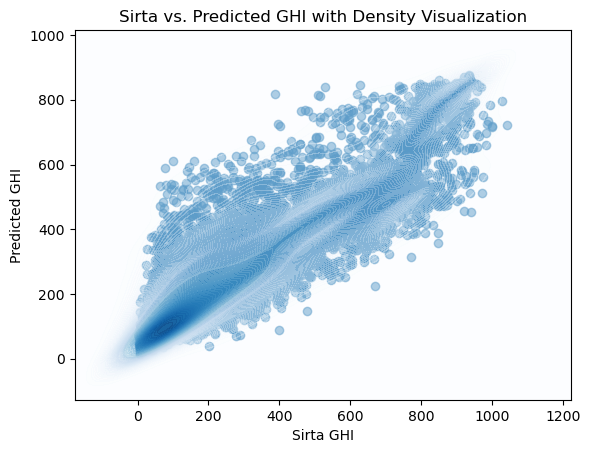

In [56]:
rfm=RandomForestRegressor()
data_rfm=model_fit_prediction(df_train_mean,df_test_mean,rfm)
evaluate_algo(rfm,data_rfm[3],data_rfm[4])
scatter_test_pred_density(data_rfm[3],data_rfm[4])

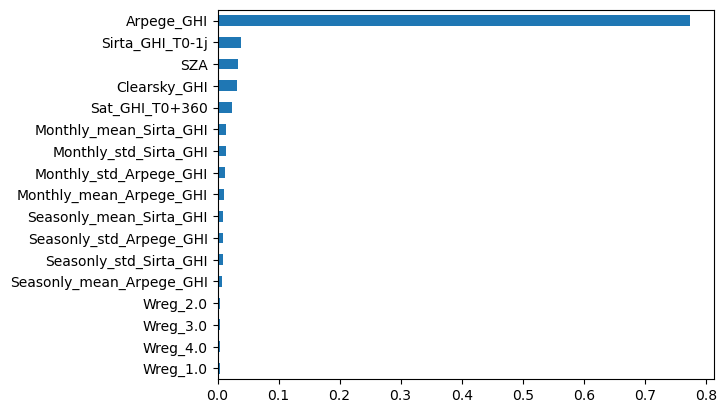

In [57]:
features_importance(data_rfm[5], data_rfm[0])

In [ ]:
all_test_pred_graph(data_rfm[3],data_rfm[4])

In [ ]:
df_train_mean = df.loc[df.index<'01-01-2020'][columns_selection([360],stat_Arpege=True)]
df_test_mean = df.loc[df.index >= '01-01-2020'][columns_selection([360],stat_Arpege=True)]
fig, ax = plt.subplots(figsize=(15, 5))
df_train_mean['Sirta_GHI'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
df_test_mean['Sirta_GHI'].plot(ax=ax, label='Test Set')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

### Without Sirta stats

RandomForestRegressor()
MSE: 14883.107538127573
MAE: 90.46348244434644
R-squared: 0.7867115337524444
Distance DTW: 486774.2061513434


C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

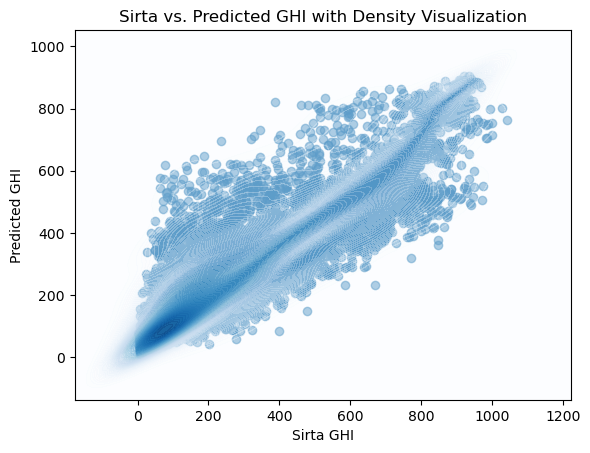

In [61]:
rfm=RandomForestRegressor()
data_rfm=model_fit_prediction(df_train_mean,df_test_mean,rfm)
evaluate_algo(rfm,data_rfm[3],data_rfm[4])
scatter_test_pred_density(data_rfm[3],data_rfm[4])

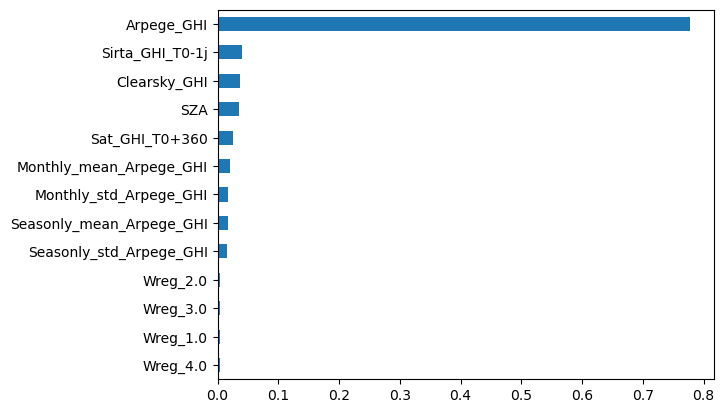

In [62]:
features_importance(data_rfm[5], data_rfm[0])

In [ ]:
all_test_pred_graph(data_rfm[3],data_rfm[4])

## Monthly and Seasonly stats of Sat+360

In [45]:
df=add_columns_stats(df,['Sat_GHI_T0+360'],['mean','std'])

In [68]:
df.columns

Index(['Sirta_GHI', 'Sat_GHI_T0+0', 'Clearsky_GHI', 'Arpege_GHI', 'SZA',
       'Kc_Sat_mean', 'Kc_Sat_std', 'Kc_obs', 'Sat_GHI_T0+15', 'Sat_GHI_T0+30',
       'Sat_GHI_T0+45', 'Sat_GHI_T0+60', 'Sat_GHI_T0+75', 'Sat_GHI_T0+90',
       'Sat_GHI_T0+105', 'Sat_GHI_T0+120', 'Sat_GHI_T0+135', 'Sat_GHI_T0+150',
       'Sat_GHI_T0+165', 'Sat_GHI_T0+180', 'Sat_GHI_T0+195', 'Sat_GHI_T0+210',
       'Sat_GHI_T0+225', 'Sat_GHI_T0+240', 'Sat_GHI_T0+255', 'Sat_GHI_T0+270',
       'Sat_GHI_T0+285', 'Sat_GHI_T0+300', 'Sat_GHI_T0+315', 'Sat_GHI_T0+330',
       'Sat_GHI_T0+345', 'Sat_GHI_T0+360', 'Wreg_1.0', 'Wreg_2.0', 'Wreg_3.0',
       'Wreg_4.0', 'Sirta_GHI_T0-1j', 'Month', 'Hour', 'Minute',
       'Monthly_std_Sirta_GHI', 'Seasonly_std_Sirta_GHI',
       'Monthly_mean_Sirta_GHI', 'Seasonly_mean_Sirta_GHI',
       'Monthly_mean_Arpege_GHI', 'Seasonly_mean_Arpege_GHI',
       'Monthly_std_Arpege_GHI', 'Seasonly_std_Arpege_GHI',
       'Monthly_mean_Sat_GHI_T0+360', 'Seasonly_mean_Sat_GHI_T0+360',
  

In [ ]:
df_train_mean = df.loc[df.index<'01-01-2020'][columns_selection([360],date_means=True, std_Sirta=True, stat_Sat=True)]
df_test_mean = df.loc[df.index >= '01-01-2020'][columns_selection([360],date_means=True, std_Sirta=True, stat_Sat=True)]
fig, ax = plt.subplots(figsize=(15, 5))
df_train_mean['Sirta_GHI'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
df_test_mean['Sirta_GHI'].plot(ax=ax, label='Test Set')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

In [70]:
df_train_mean.columns

Index(['Sirta_GHI', 'Clearsky_GHI', 'Arpege_GHI', 'SZA', 'Wreg_1.0',
       'Wreg_2.0', 'Wreg_3.0', 'Wreg_4.0', 'Sirta_GHI_T0-1j',
       'Monthly_mean_Sirta_GHI', 'Seasonly_mean_Sirta_GHI',
       'Monthly_std_Sirta_GHI', 'Seasonly_std_Sirta_GHI', 'Sat_GHI_T0+360',
       'Monthly_std_Sat_GHI_T0+360', 'Seasonly_std_Sat_GHI_T0+360',
       'Monthly_mean_Sat_GHI_T0+360', 'Seasonly_mean_Sat_GHI_T0+360'],
      dtype='object')

RandomForestRegressor()
MSE: 16590.981937432378
MAE: 96.84619162826345
R-squared: 0.7622361404088164
Distance DTW: 593040.0618780237


C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

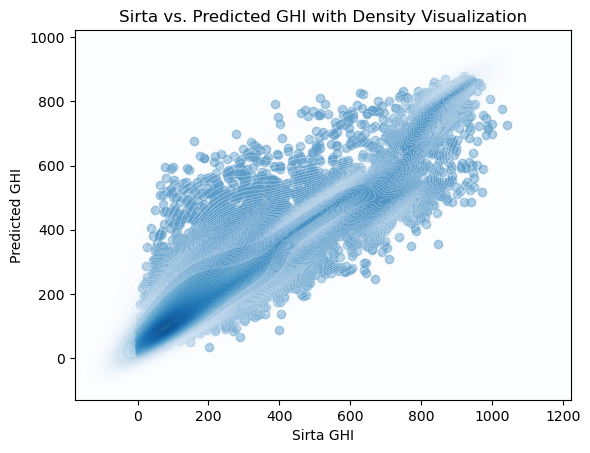

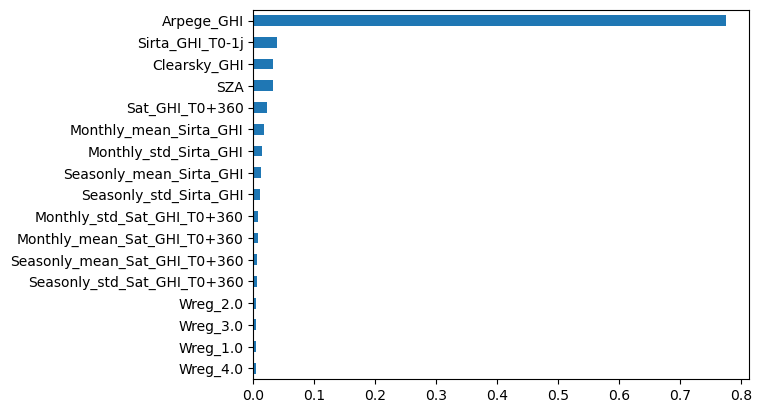

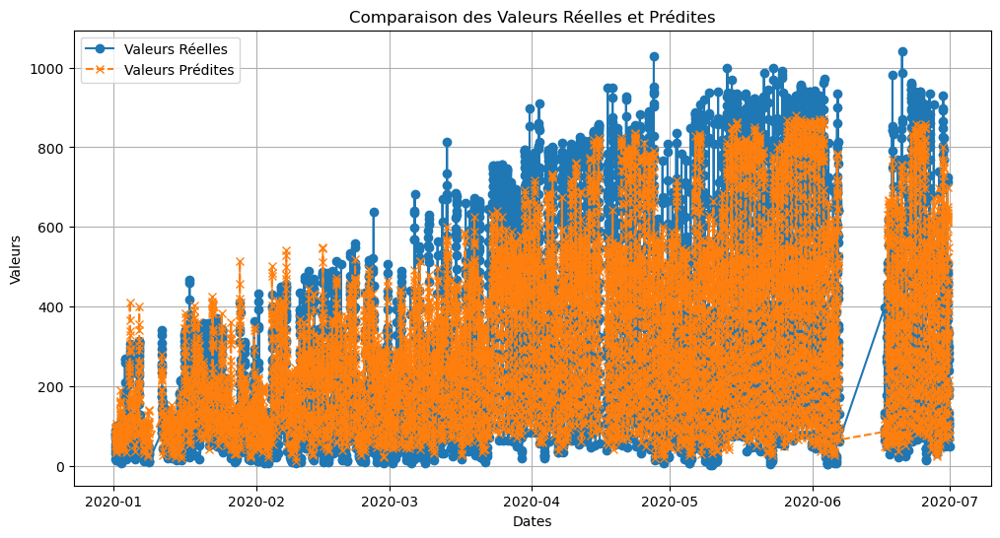

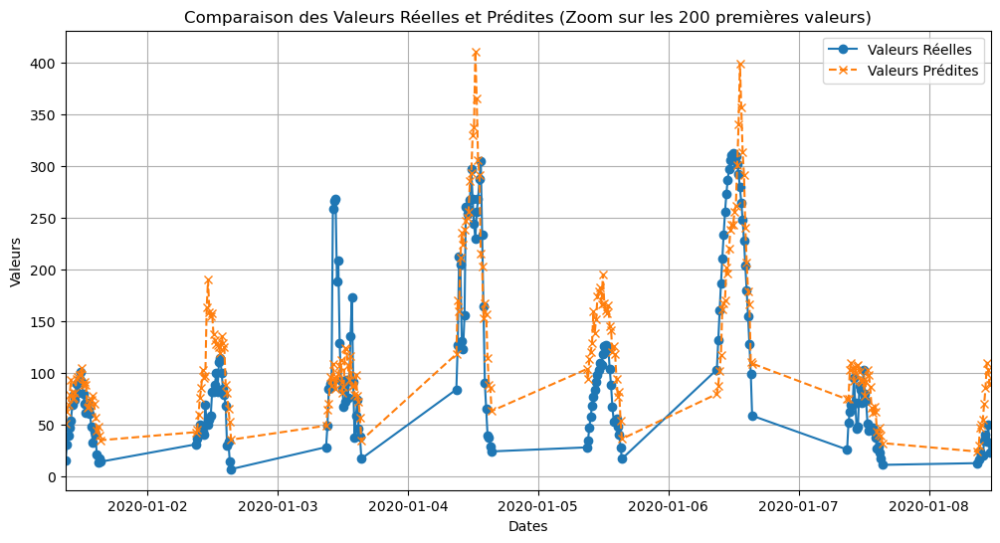

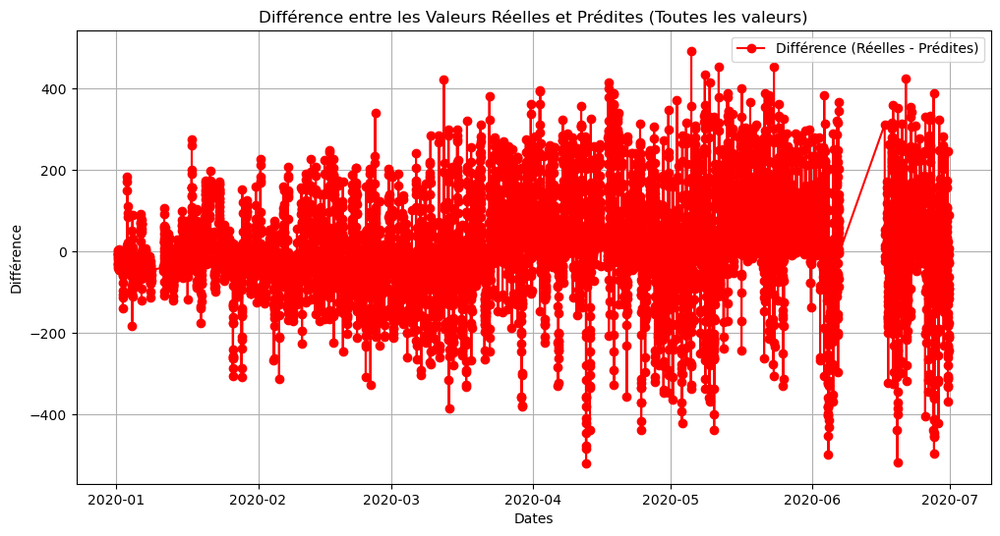

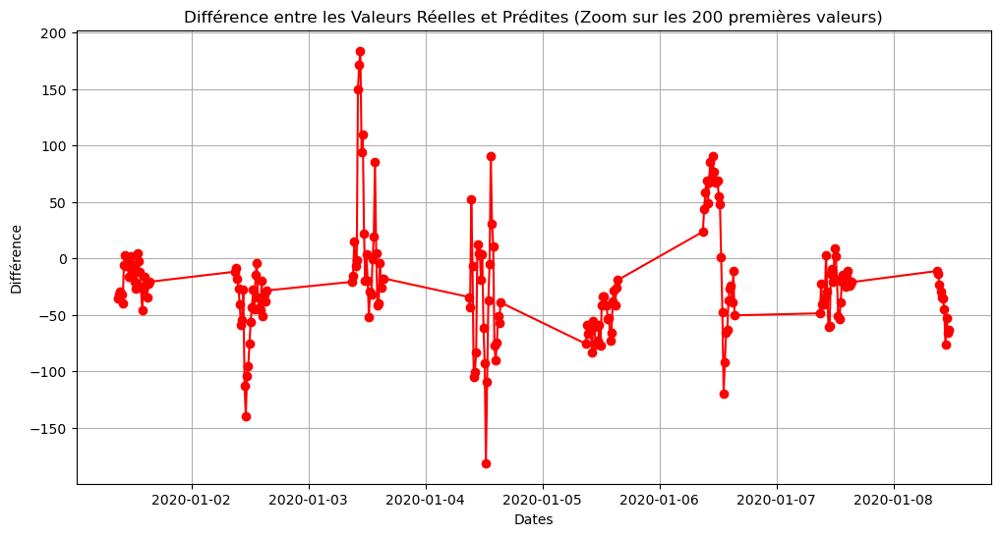

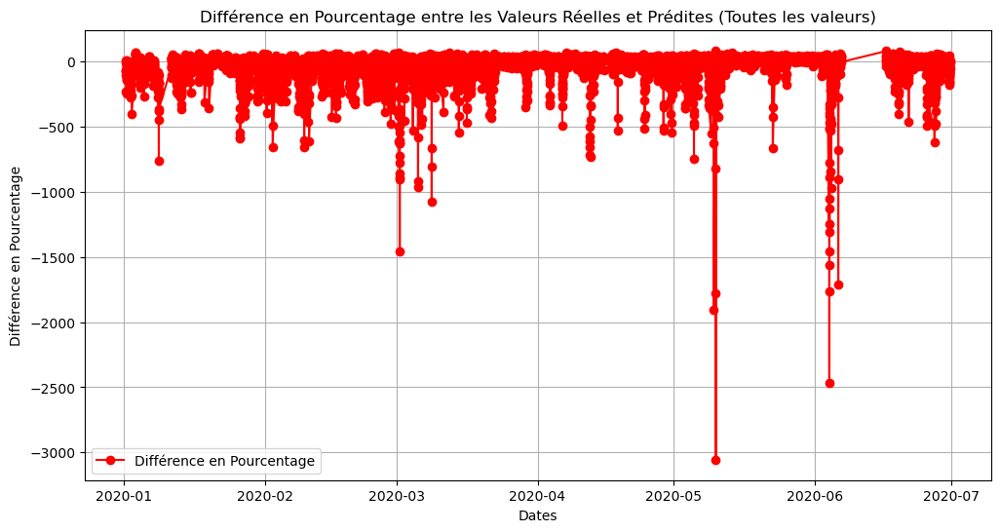

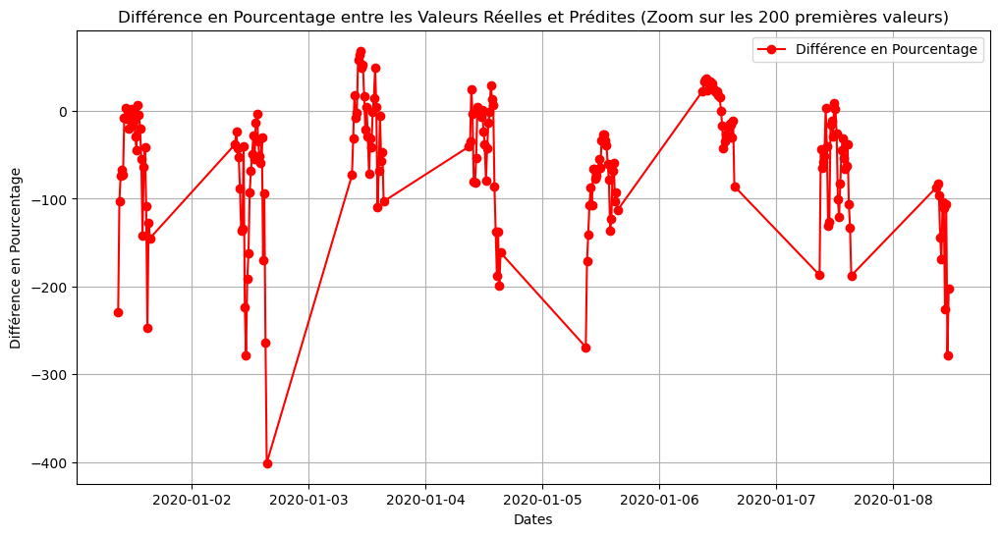

In [71]:
rfm=RandomForestRegressor()
data_rfm=model_fit_prediction(df_train_mean,df_test_mean,rfm)
evaluate_algo(rfm,data_rfm[3],data_rfm[4])
scatter_test_pred_density(data_rfm[3],data_rfm[4])
features_importance(data_rfm[5], data_rfm[0])
all_test_pred_graph(data_rfm[3],data_rfm[4])

### Without Sirta stats

In [ ]:
df_train_mean = df.loc[df.index<'01-01-2020'][columns_selection([360],stat_Sat=True)]
df_test_mean = df.loc[df.index >= '01-01-2020'][columns_selection([360],stat_Sat=True)]
fig, ax = plt.subplots(figsize=(15, 5))
df_train_mean['Sirta_GHI'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
df_test_mean['Sirta_GHI'].plot(ax=ax, label='Test Set')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

RandomForestRegressor()
MSE: 14129.704081855847
MAE: 82.65292006789942
R-squared: 0.7975084904526591
Distance DTW: 374086.46299161983


C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

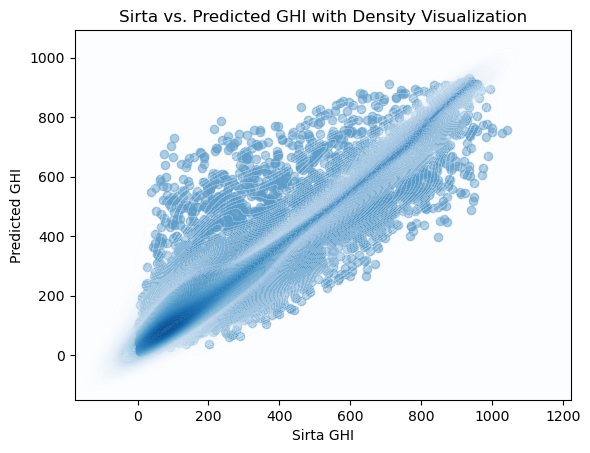

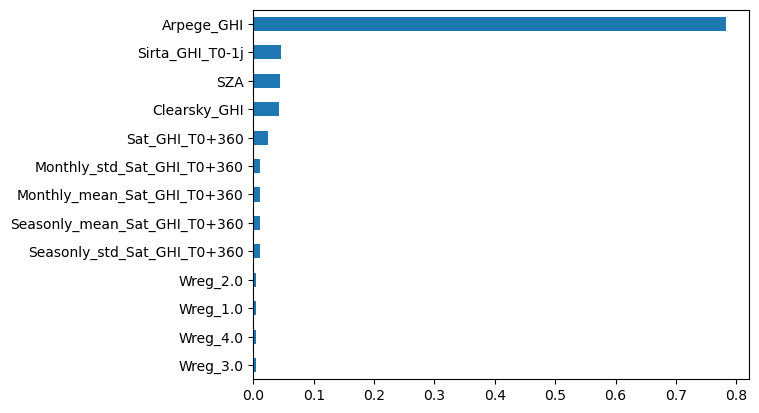

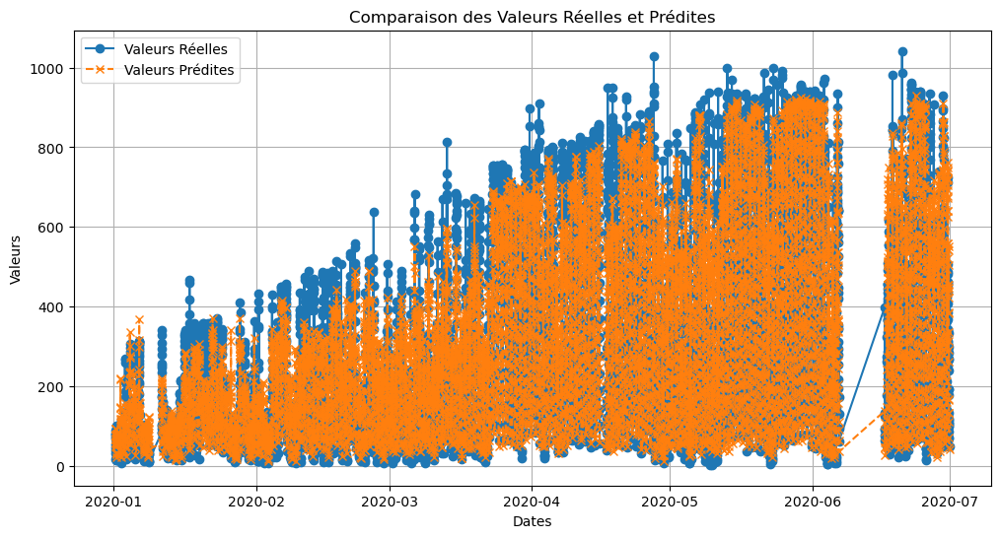

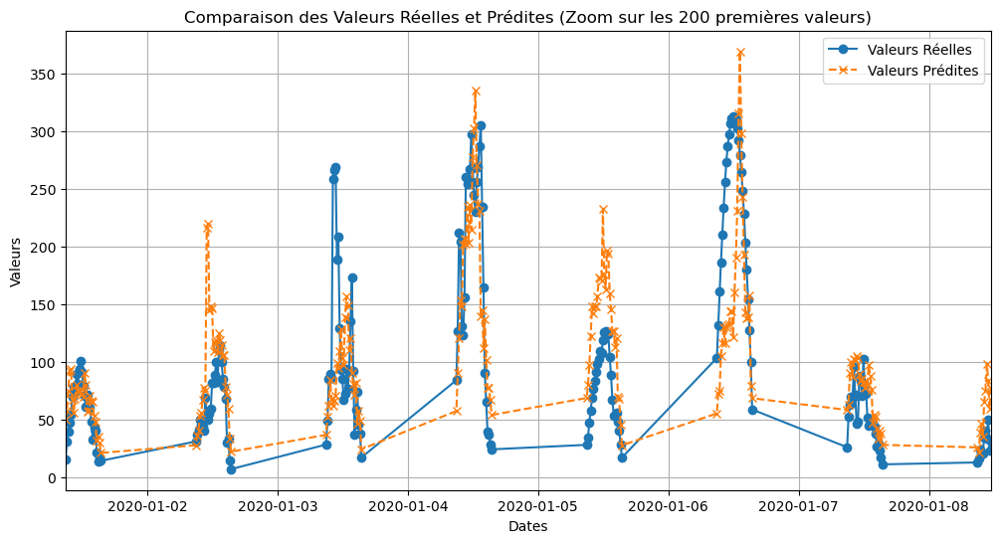

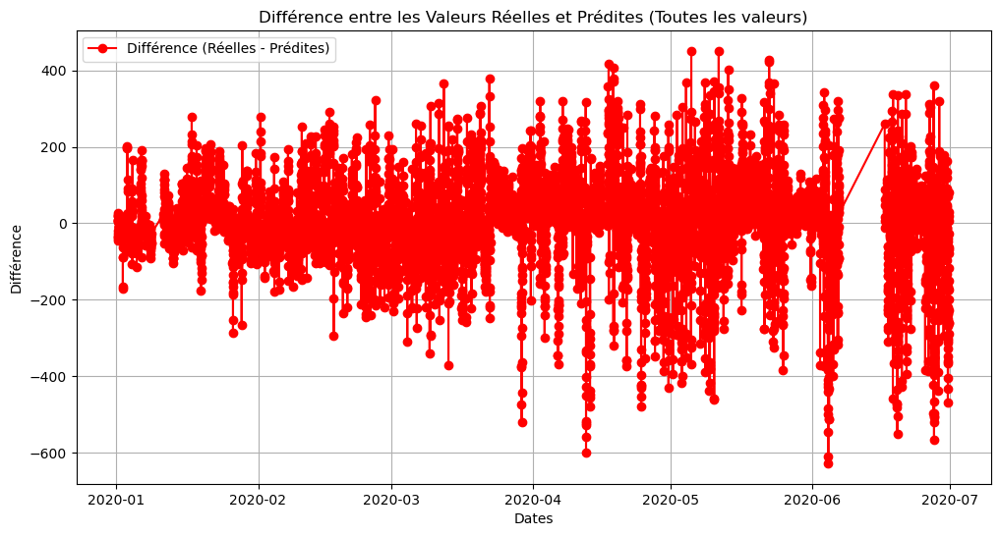

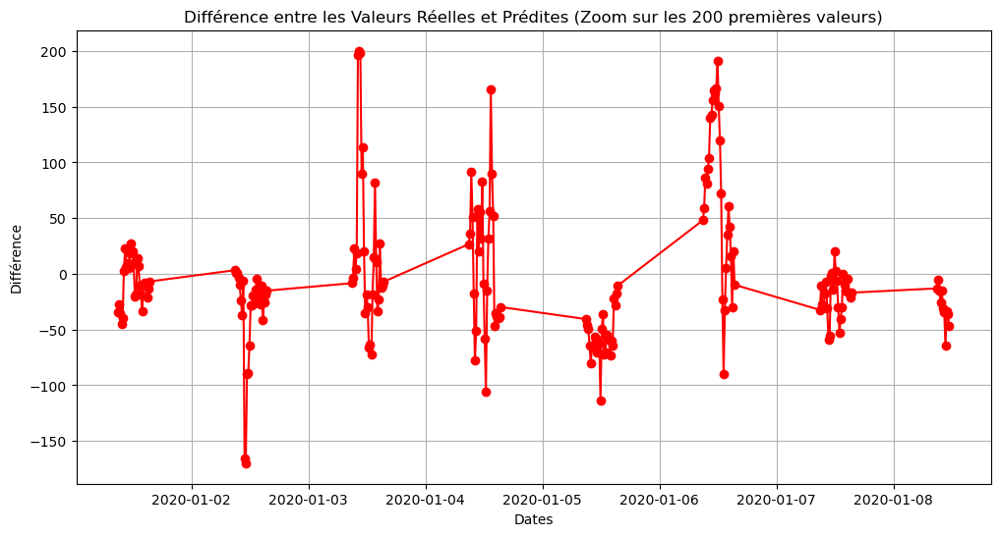

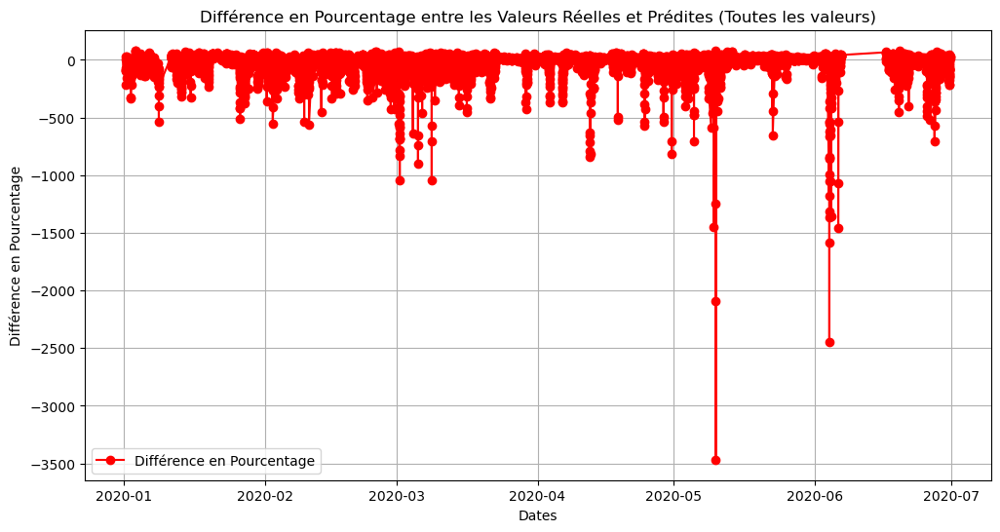

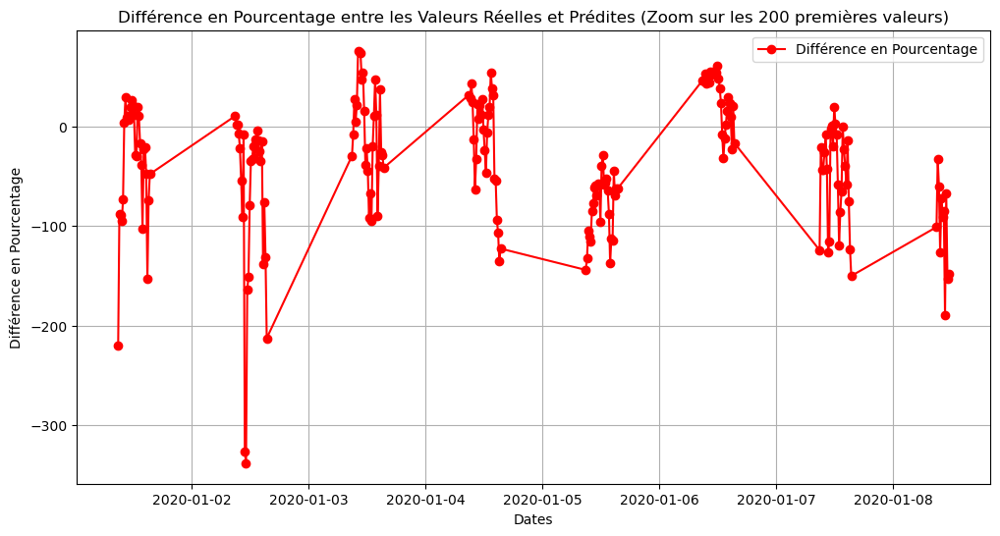

In [73]:
rfm=RandomForestRegressor()
data_rfm=model_fit_prediction(df_train_mean,df_test_mean,rfm)
evaluate_algo(rfm,data_rfm[3],data_rfm[4])
scatter_test_pred_density(data_rfm[3],data_rfm[4])
features_importance(data_rfm[5], data_rfm[0])
all_test_pred_graph(data_rfm[3],data_rfm[4])

## Monthly and Seasonly stats of Arpege and Sat+360

In [ ]:
df_train_mean = df.loc[df.index<'01-01-2020'][columns_selection([360],stat_Sat=True,stat_Arpege=True)]
df_test_mean = df.loc[df.index >= '01-01-2020'][columns_selection([360],stat_Sat=True,stat_Arpege=True)]
fig, ax = plt.subplots(figsize=(15, 5))
df_train_mean['Sirta_GHI'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
df_test_mean['Sirta_GHI'].plot(ax=ax, label='Test Set')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

In [78]:
df.columns

Index(['Sirta_GHI', 'Sat_GHI_T0+0', 'Clearsky_GHI', 'Arpege_GHI', 'SZA',
       'Kc_Sat_mean', 'Kc_Sat_std', 'Kc_obs', 'Sat_GHI_T0+15', 'Sat_GHI_T0+30',
       'Sat_GHI_T0+45', 'Sat_GHI_T0+60', 'Sat_GHI_T0+75', 'Sat_GHI_T0+90',
       'Sat_GHI_T0+105', 'Sat_GHI_T0+120', 'Sat_GHI_T0+135', 'Sat_GHI_T0+150',
       'Sat_GHI_T0+165', 'Sat_GHI_T0+180', 'Sat_GHI_T0+195', 'Sat_GHI_T0+210',
       'Sat_GHI_T0+225', 'Sat_GHI_T0+240', 'Sat_GHI_T0+255', 'Sat_GHI_T0+270',
       'Sat_GHI_T0+285', 'Sat_GHI_T0+300', 'Sat_GHI_T0+315', 'Sat_GHI_T0+330',
       'Sat_GHI_T0+345', 'Sat_GHI_T0+360', 'Wreg_1.0', 'Wreg_2.0', 'Wreg_3.0',
       'Wreg_4.0', 'Sirta_GHI_T0-1j', 'Month', 'Hour', 'Minute',
       'Monthly_std_Sirta_GHI', 'Seasonly_std_Sirta_GHI',
       'Monthly_mean_Sirta_GHI', 'Seasonly_mean_Sirta_GHI',
       'Monthly_mean_Arpege_GHI', 'Seasonly_mean_Arpege_GHI',
       'Monthly_std_Arpege_GHI', 'Seasonly_std_Arpege_GHI',
       'Monthly_mean_Sat_GHI_T0+360', 'Seasonly_mean_Sat_GHI_T0+360',
  

RandomForestRegressor()
MSE: 14462.409717596489
MAE: 89.306315809231
R-squared: 0.7927405161181831
Distance DTW: 464567.9991737712


C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

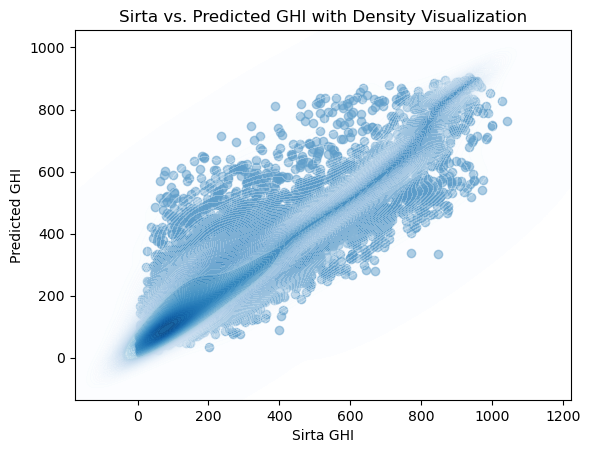

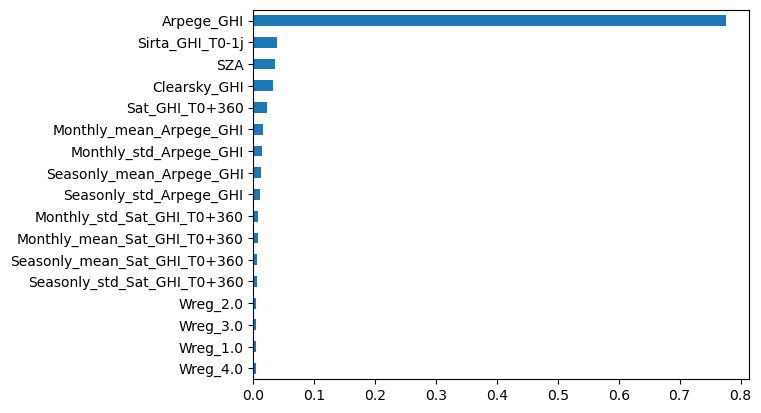

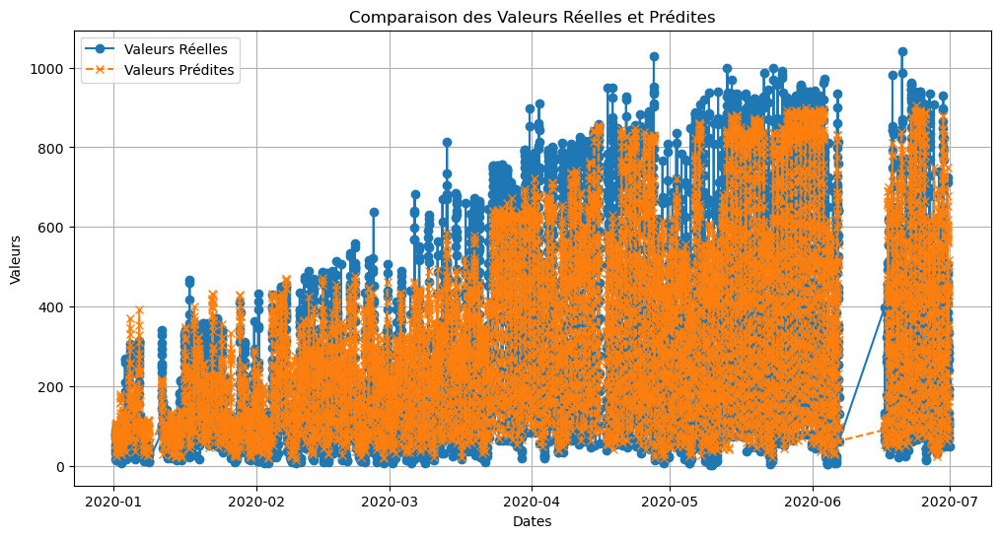

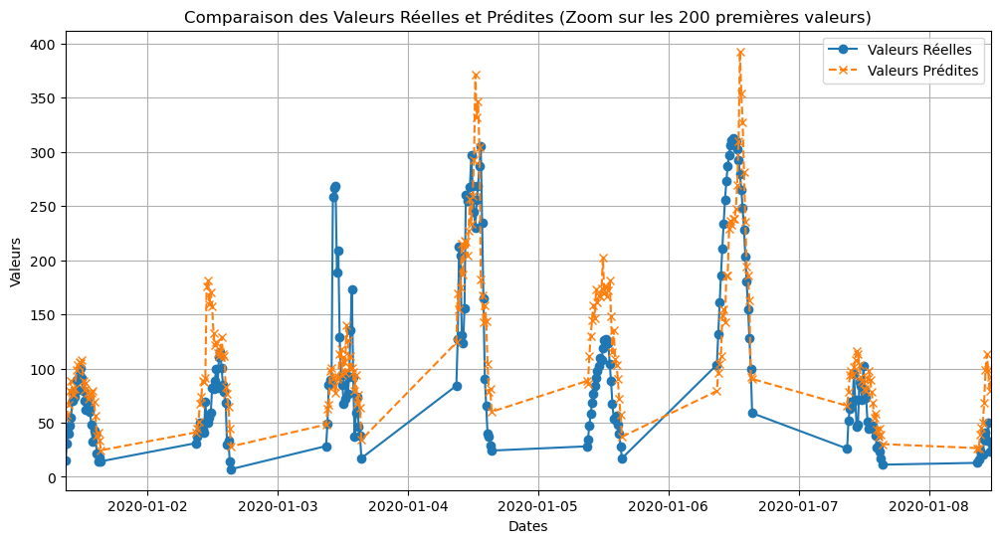

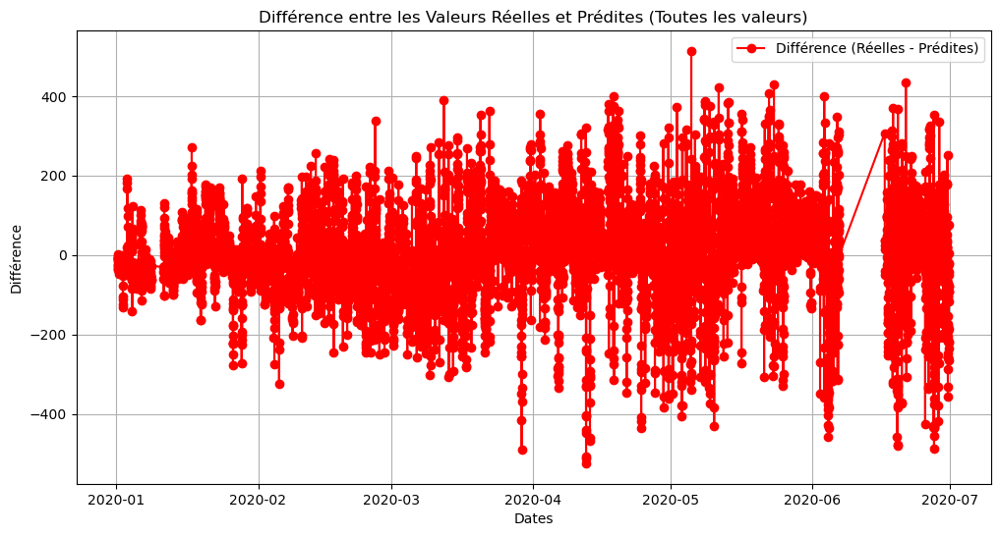

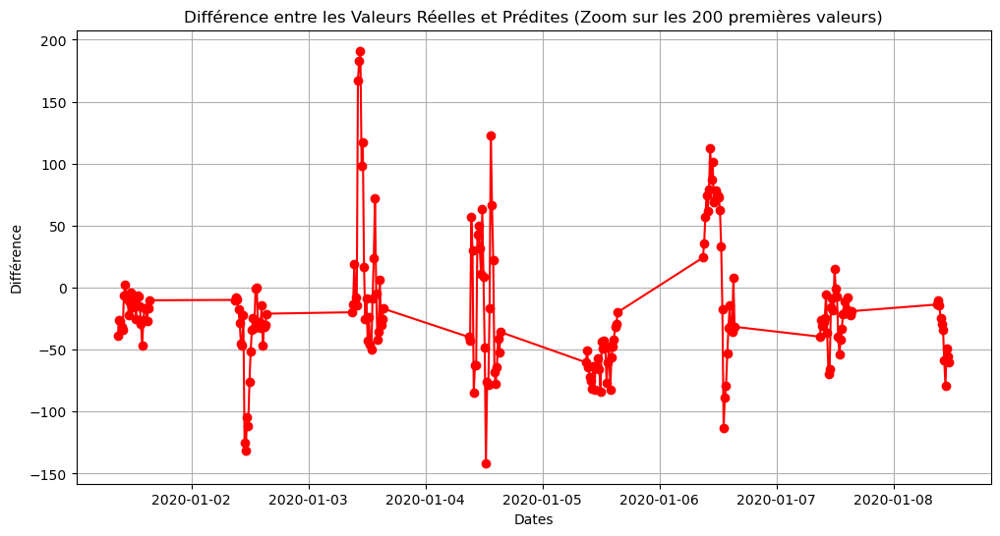

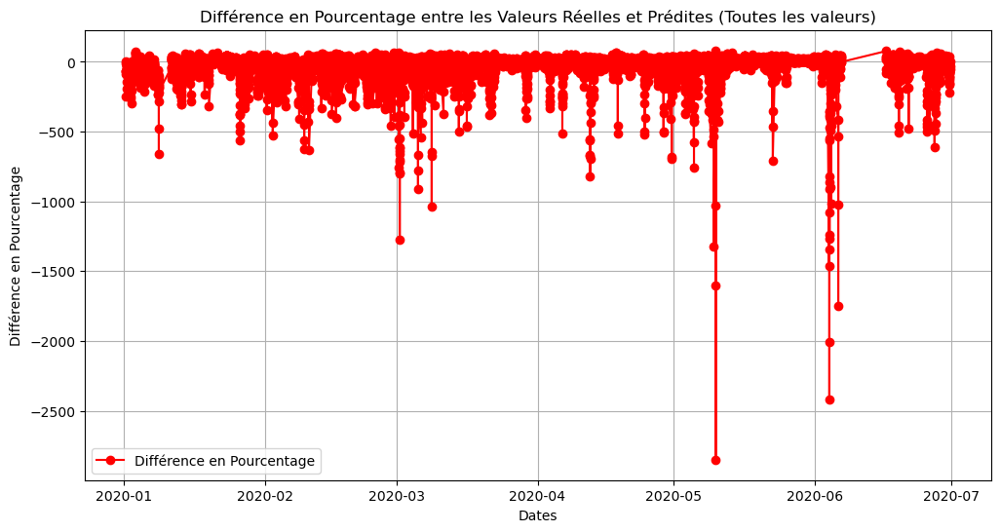

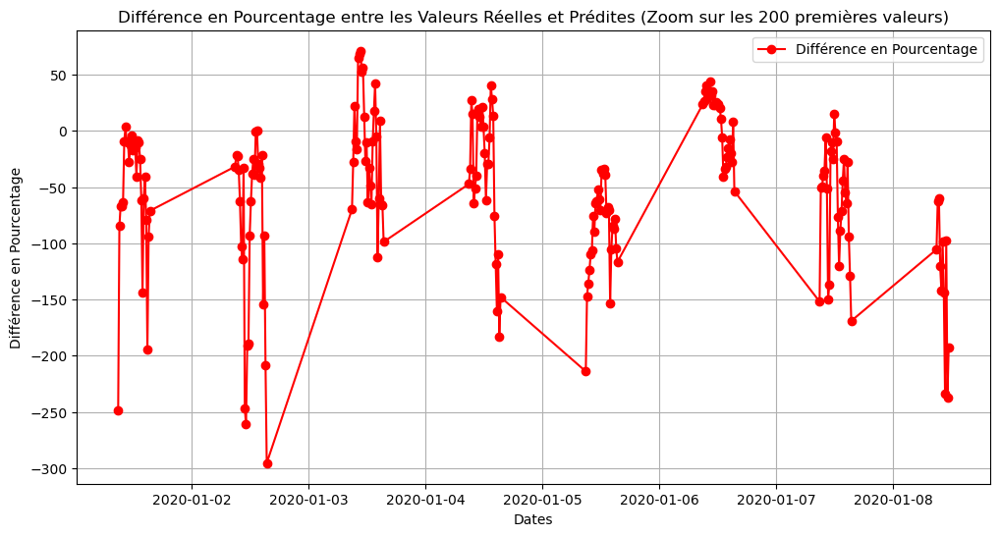

In [79]:
rfm=RandomForestRegressor()
data_rfm=model_fit_prediction(df_train_mean,df_test_mean,rfm)
evaluate_algo(rfm,data_rfm[3],data_rfm[4])
scatter_test_pred_density(data_rfm[3],data_rfm[4])
features_importance(data_rfm[5], data_rfm[0])
all_test_pred_graph(data_rfm[3],data_rfm[4])

### Without Wreg

In [ ]:
df_train_mean = df.loc[df.index<'01-01-2020'][columns_selection([360],stat_Sat=True,stat_Arpege=True)]
df_test_mean = df.loc[df.index >= '01-01-2020'][columns_selection([360],stat_Sat=True,stat_Arpege=True)]
columns_to_drop = ['Wreg_1.0', 'Wreg_2.0', 'Wreg_3.0', 'Wreg_4.0']
df_train_mean=df_train_mean.drop(columns=columns_to_drop)
df_test_mean=df_test_mean.drop(columns=columns_to_drop)
fig, ax = plt.subplots(figsize=(15, 5))
df_train_mean['Sirta_GHI'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
df_test_mean['Sirta_GHI'].plot(ax=ax, label='Test Set')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

RandomForestRegressor()
MSE: 14649.966898396835
MAE: 89.77340398924757
R-squared: 0.7900526511461576
Distance DTW: 478511.0814275036


C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

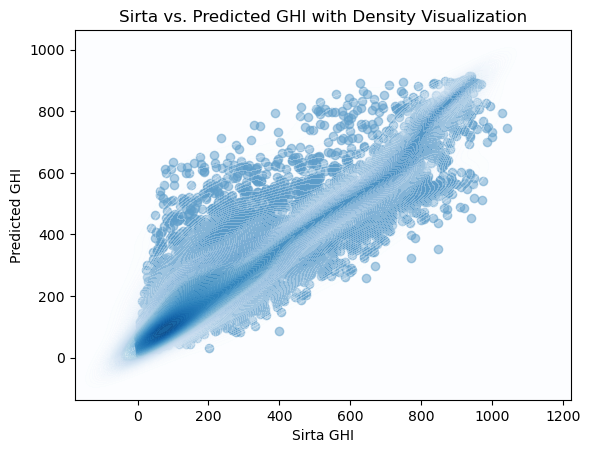

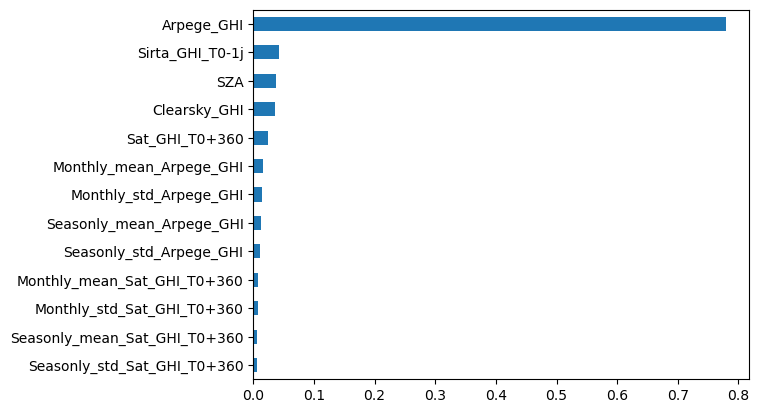

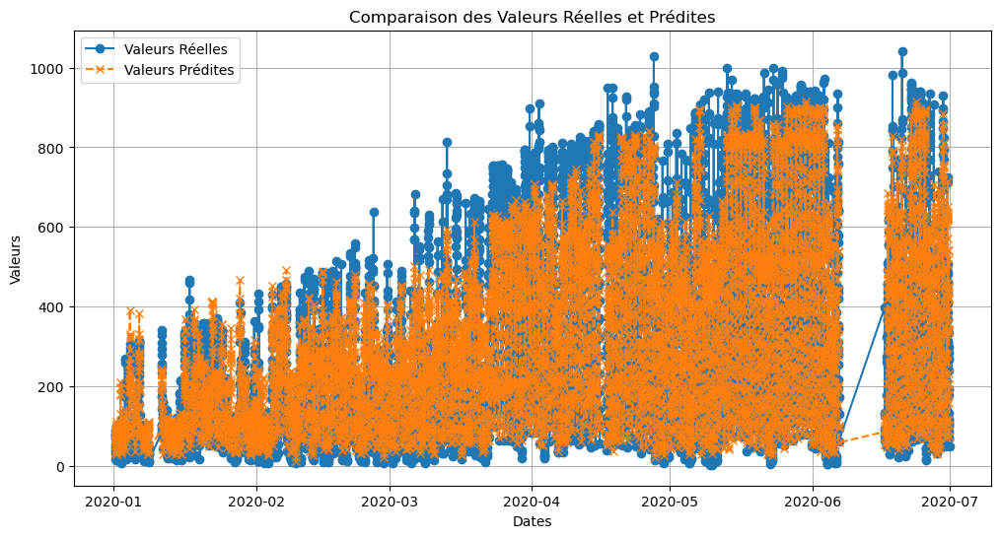

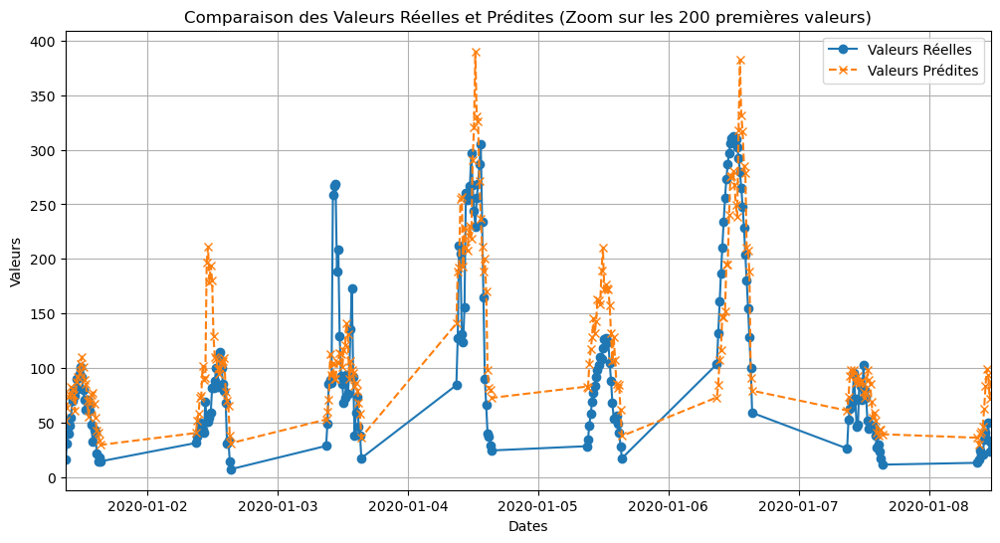

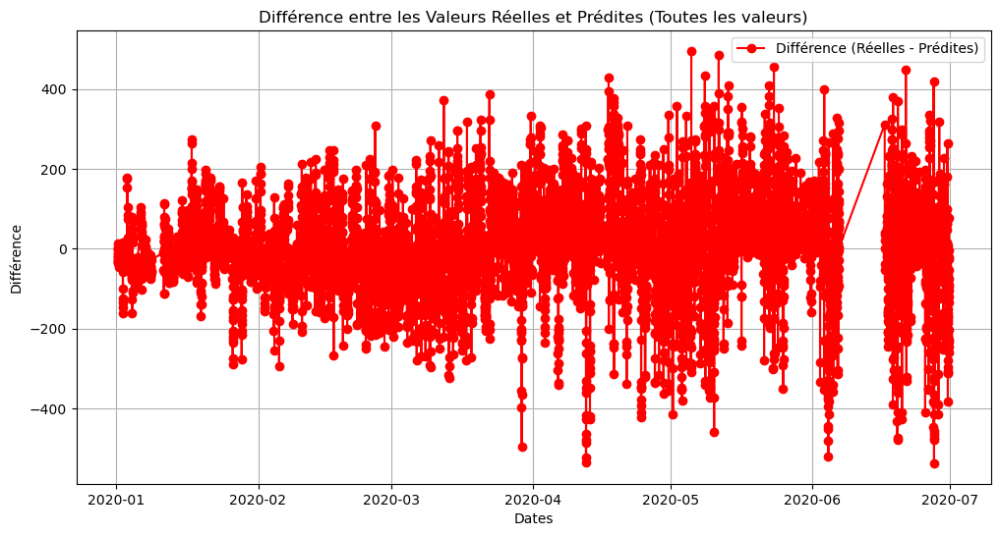

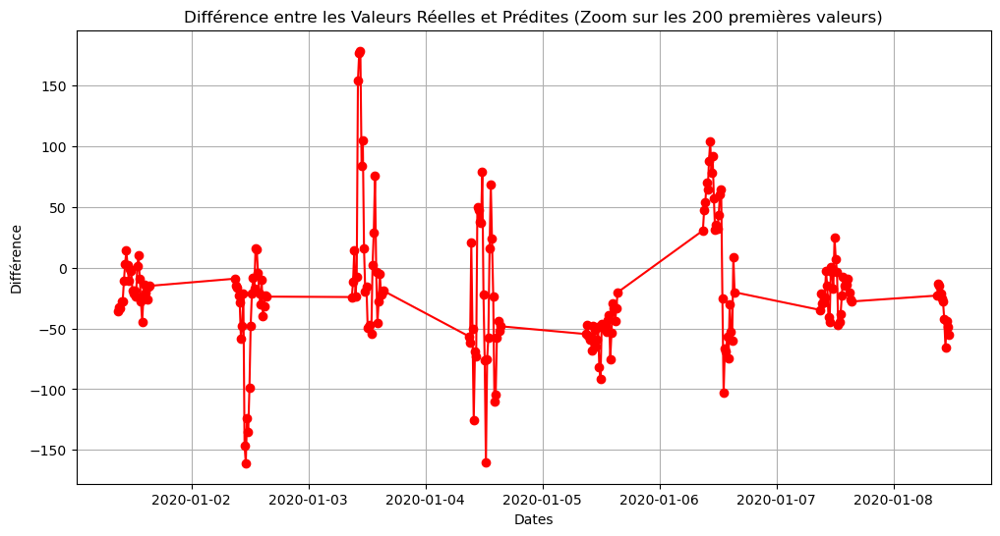

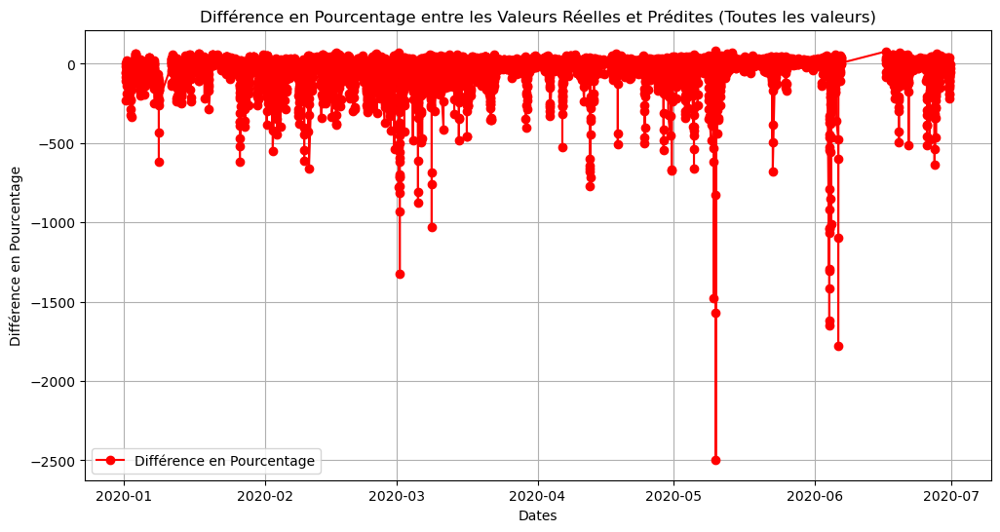

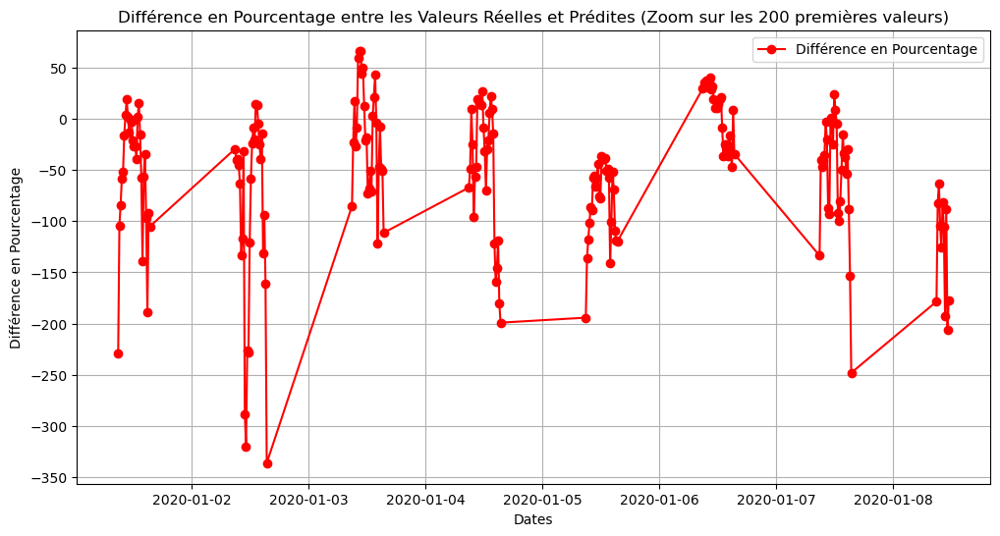

In [81]:
rfm=RandomForestRegressor()
data_rfm=model_fit_prediction(df_train_mean,df_test_mean,rfm)
evaluate_algo(rfm,data_rfm[3],data_rfm[4])
scatter_test_pred_density(data_rfm[3],data_rfm[4])
features_importance(data_rfm[5], data_rfm[0])
all_test_pred_graph(data_rfm[3],data_rfm[4])

## Skewness 
Skewness measures the degree and direction of asymmetry of a distribution relative to its mean. A positive skewness indicates a longer tail of the distribution on the high side of values, while a negative skewness indicates a longer tail on the low side of values.

In [76]:
from utiles4 import *

In [63]:
df['Sirta_GHI'].skew()

0.7393988881524263

In [64]:
df=add_columns_stats(df,['Arpege_GHI'],['skew'])
df=add_columns_stats(df,['Sat_GHI_T0+360'],['skew'])

In [69]:
df.columns

Index(['Sirta_GHI', 'Sat_GHI_T0+0', 'Clearsky_GHI', 'Arpege_GHI', 'SZA',
       'Kc_Sat_mean', 'Kc_Sat_std', 'Kc_obs', 'Sat_GHI_T0+15', 'Sat_GHI_T0+30',
       'Sat_GHI_T0+45', 'Sat_GHI_T0+60', 'Sat_GHI_T0+75', 'Sat_GHI_T0+90',
       'Sat_GHI_T0+105', 'Sat_GHI_T0+120', 'Sat_GHI_T0+135', 'Sat_GHI_T0+150',
       'Sat_GHI_T0+165', 'Sat_GHI_T0+180', 'Sat_GHI_T0+195', 'Sat_GHI_T0+210',
       'Sat_GHI_T0+225', 'Sat_GHI_T0+240', 'Sat_GHI_T0+255', 'Sat_GHI_T0+270',
       'Sat_GHI_T0+285', 'Sat_GHI_T0+300', 'Sat_GHI_T0+315', 'Sat_GHI_T0+330',
       'Sat_GHI_T0+345', 'Sat_GHI_T0+360', 'Wreg_1.0', 'Wreg_2.0', 'Wreg_3.0',
       'Wreg_4.0', 'Sirta_GHI_T0-1j', 'Month', 'Hour', 'Minute',
       'Monthly_mean_Sirta_GHI', 'Seasonly_mean_Sirta_GHI',
       'Monthly_std_Sirta_GHI', 'Seasonly_std_Sirta_GHI',
       'Monthly_mean_Arpege_GHI', 'Seasonly_mean_Arpege_GHI',
       'Monthly_std_Arpege_GHI', 'Seasonly_std_Arpege_GHI',
       'Monthly_mean_Sat_GHI_T0+360', 'Seasonly_mean_Sat_GHI_T0+360',
  

In [ ]:
df_train_mean = df.loc[df.index<'01-01-2020'][columns_selection([360],skewness=True)]
df_test_mean = df.loc[df.index >= '01-01-2020'][columns_selection([360],skewness=True)]
columns_to_drop = ['Wreg_1.0', 'Wreg_2.0', 'Wreg_3.0', 'Wreg_4.0']
df_train_mean=df_train_mean.drop(columns=columns_to_drop)
df_test_mean=df_test_mean.drop(columns=columns_to_drop)
fig, ax = plt.subplots(figsize=(15, 5))
df_train_mean['Sirta_GHI'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
df_test_mean['Sirta_GHI'].plot(ax=ax, label='Test Set')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

In [74]:
df_train_mean.columns

Index(['Sirta_GHI', 'Clearsky_GHI', 'Arpege_GHI', 'SZA', 'Sirta_GHI_T0-1j',
       'Monthly_skew_Arpege_GHI', 'Seasonly_skew_Arpege_GHI', 'Sat_GHI_T0+360',
       'Monthly_skew_Sat_GHI_T0+360', 'Seasonly_skew_Sat_GHI_T0+360'],
      dtype='object')

RandomForestRegressor()
MSE: 14296.388509378081
MAE: 86.54212238316052
R-squared: 0.7951197510175316
Distance DTW: 409956.8946369415


C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

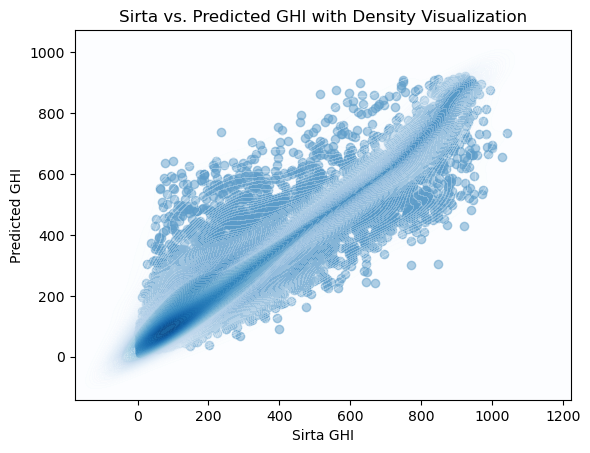

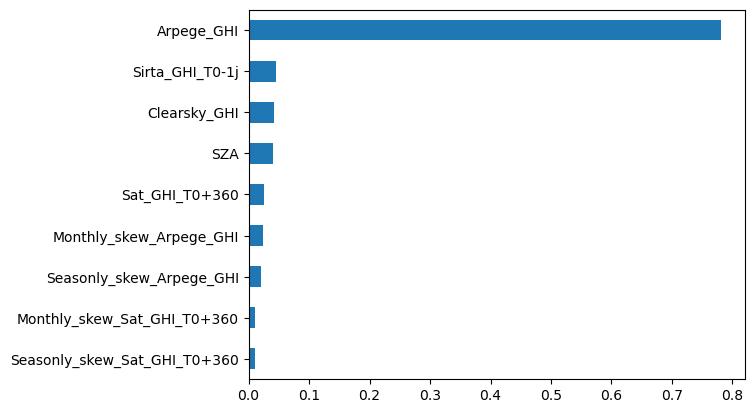

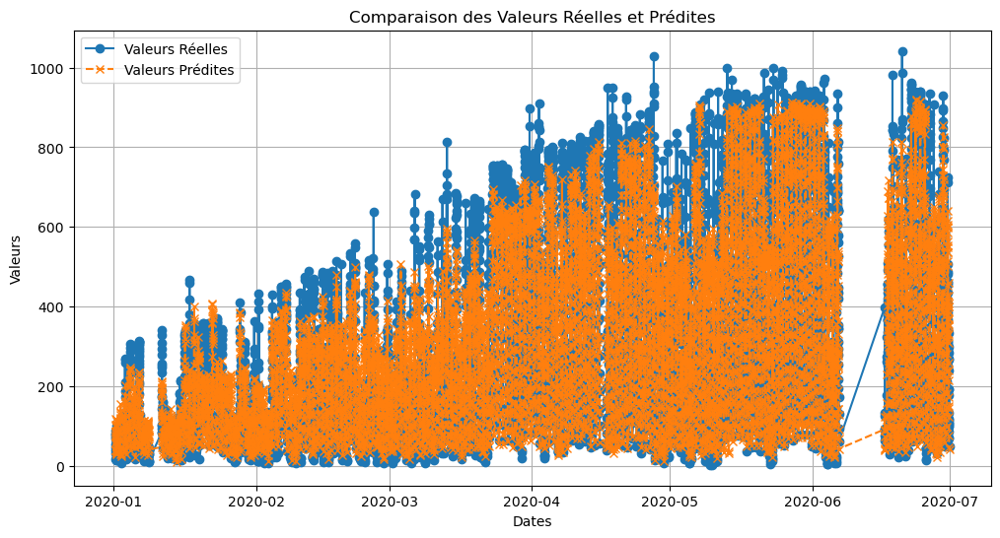

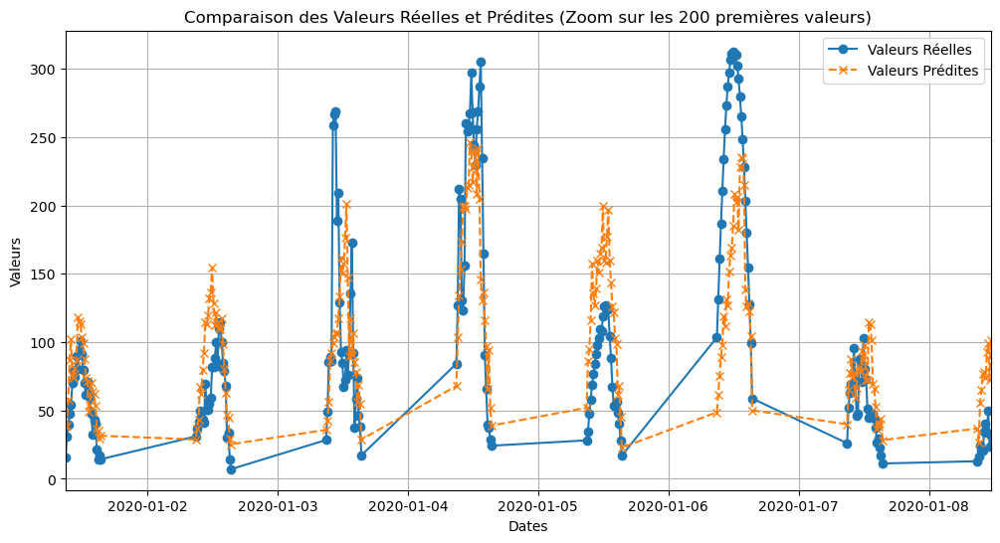

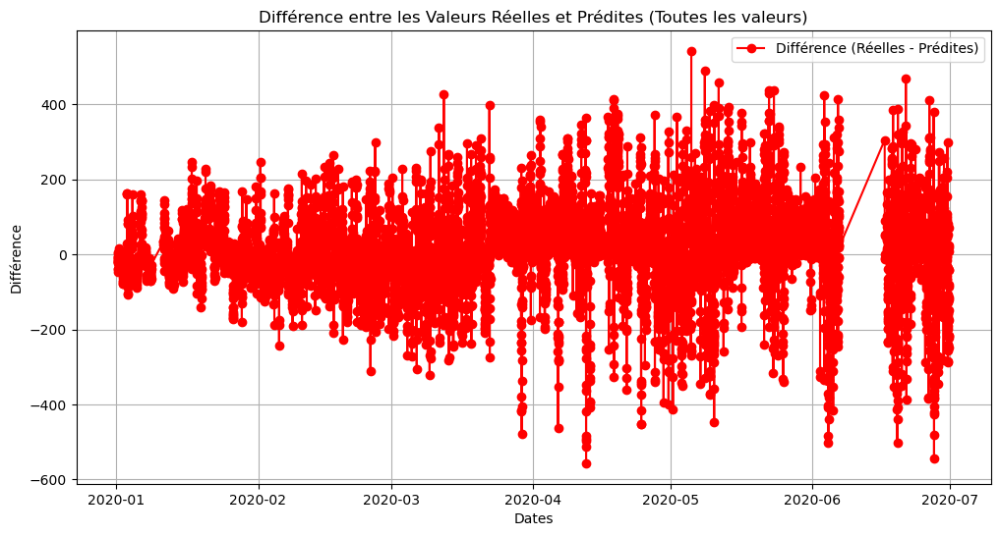

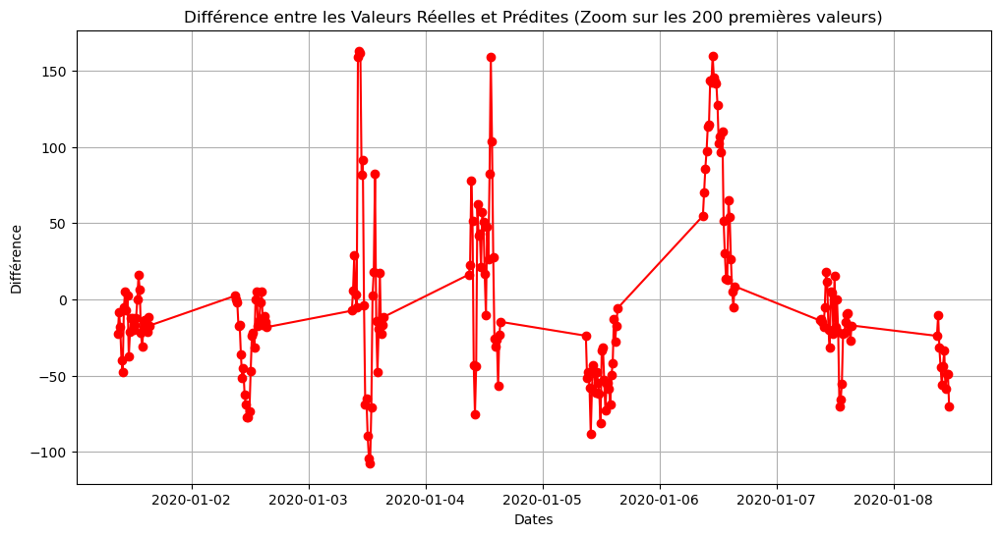

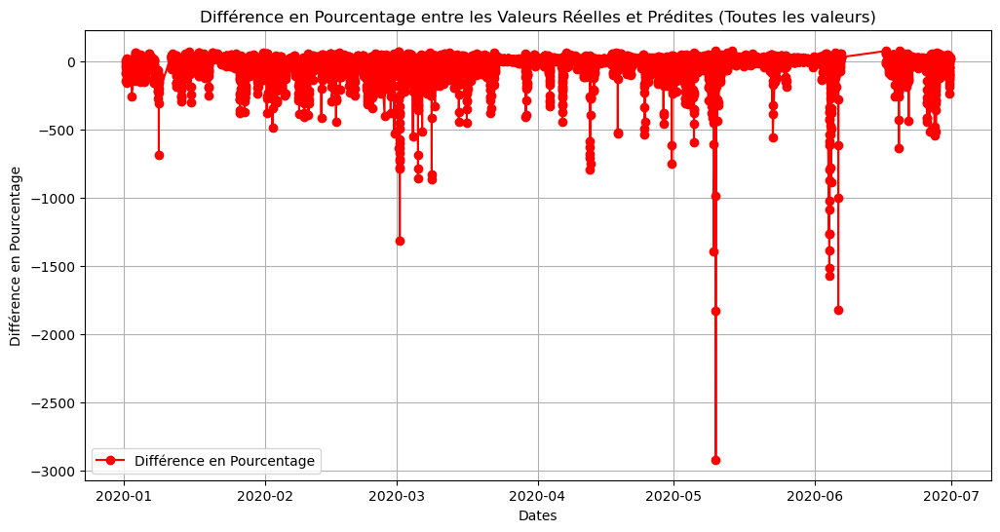

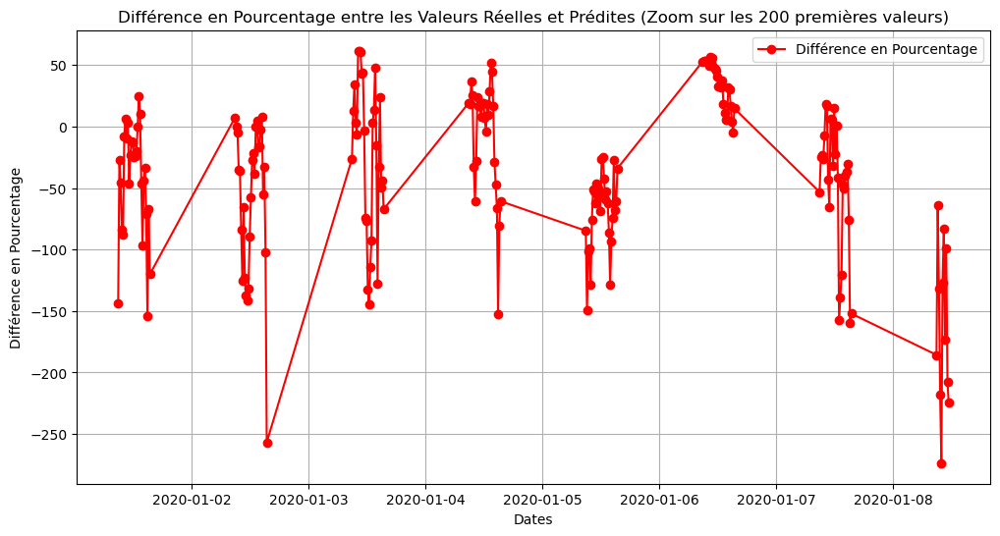

In [75]:
rfm=RandomForestRegressor()
data_rfm=model_fit_prediction(df_train_mean,df_test_mean,rfm)
evaluate_algo(rfm,data_rfm[3],data_rfm[4])
scatter_test_pred_density(data_rfm[3],data_rfm[4])
features_importance(data_rfm[5], data_rfm[0])
all_test_pred_graph(data_rfm[3],data_rfm[4])

### With skew, mean and std

In [ ]:
df_train_mean = df.loc[df.index<'01-01-2020'][columns_selection([360],skewness=True,stat_Sat=True,stat_Arpege=True)]
df_test_mean = df.loc[df.index >= '01-01-2020'][columns_selection([360],skewness=True,stat_Sat=True,stat_Arpege=True)]
columns_to_drop = ['Wreg_1.0', 'Wreg_2.0', 'Wreg_3.0', 'Wreg_4.0',"Arpege_GHI"]
df_train_mean=df_train_mean.drop(columns=columns_to_drop)
df_test_mean=df_test_mean.drop(columns=columns_to_drop)
fig, ax = plt.subplots(figsize=(15, 5))
df_train_mean['Sirta_GHI'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
df_test_mean['Sirta_GHI'].plot(ax=ax, label='Test Set')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

RandomForestRegressor()
MSE: 27659.66784681239
MAE: 133.04783218939804
R-squared: 0.6036118050716139
Distance DTW: 732233.8079930616


C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

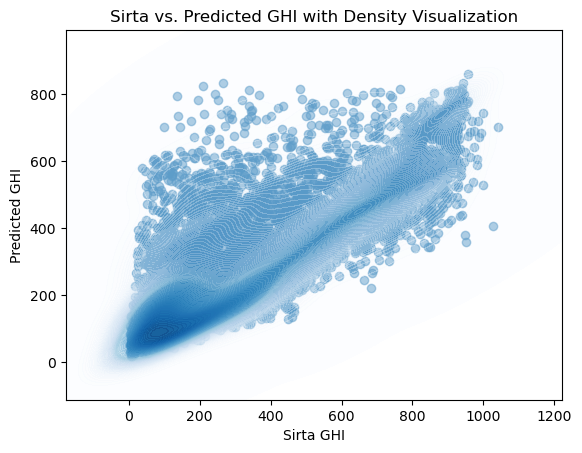

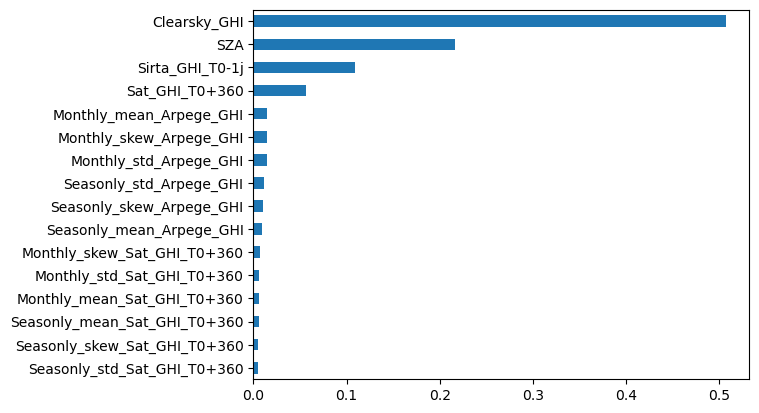

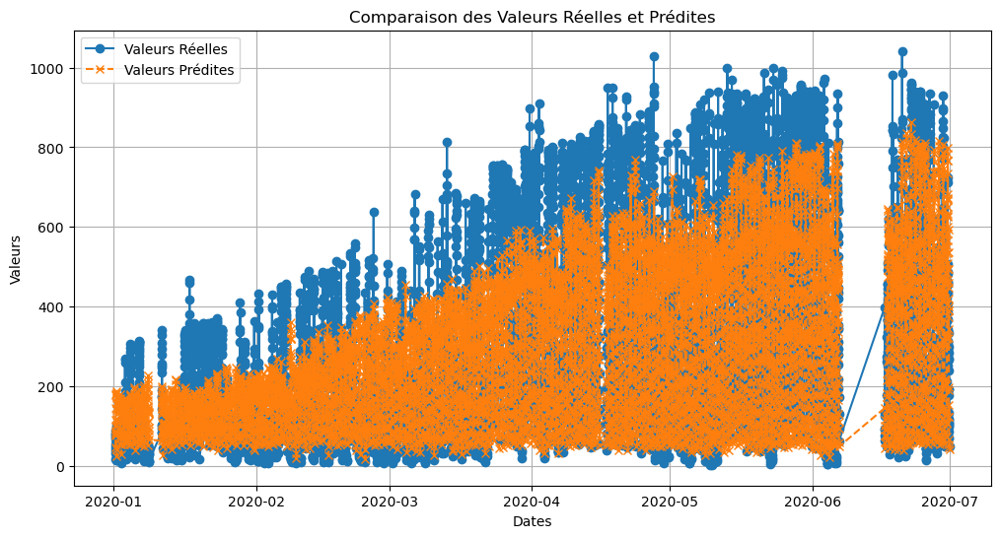

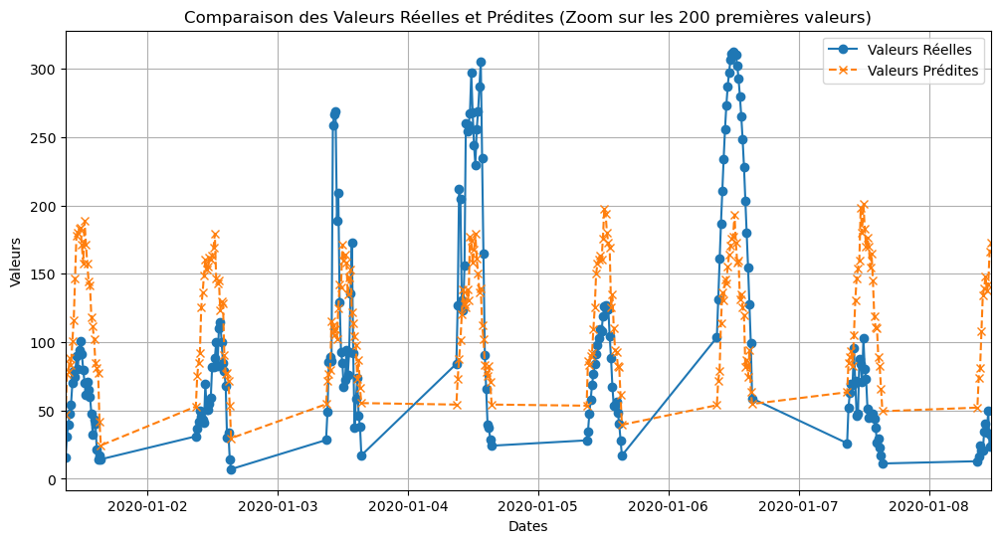

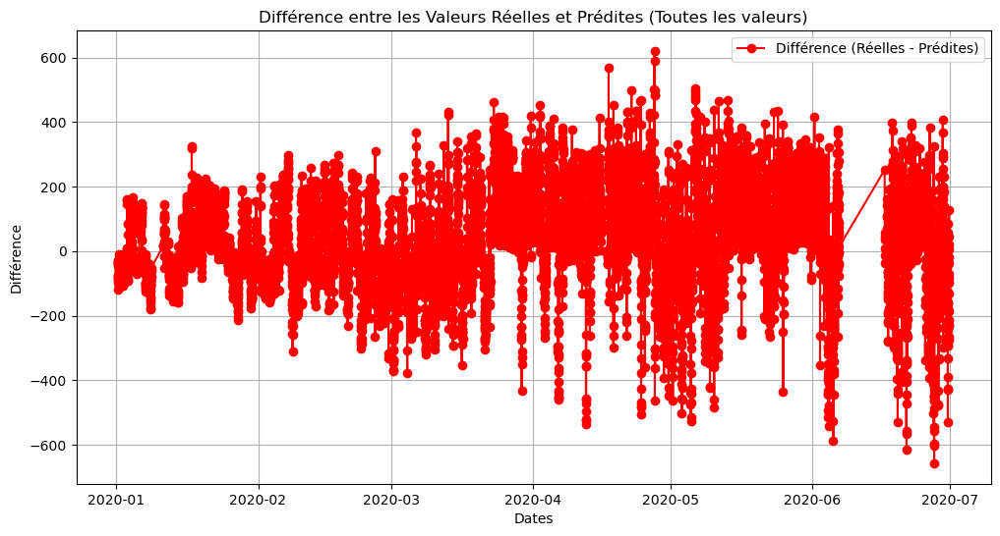

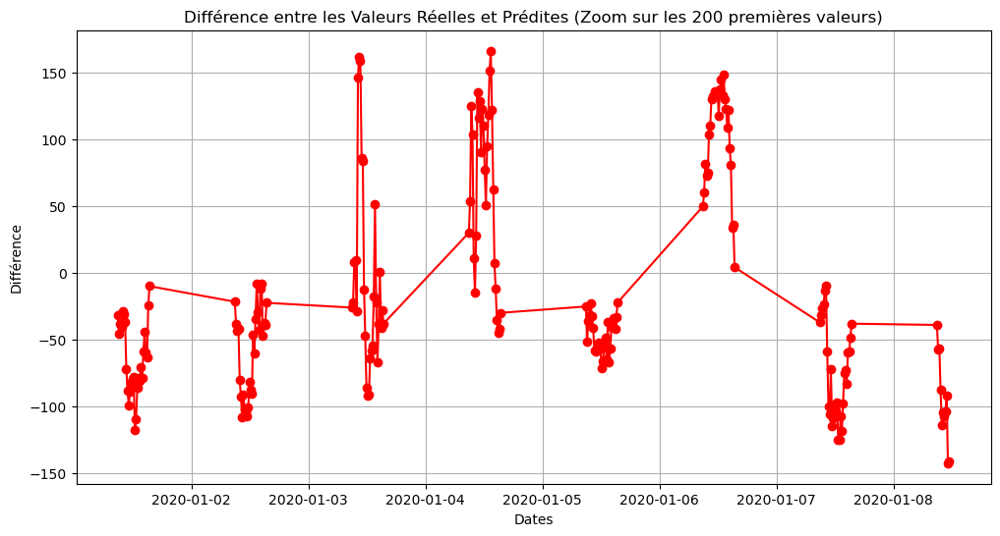

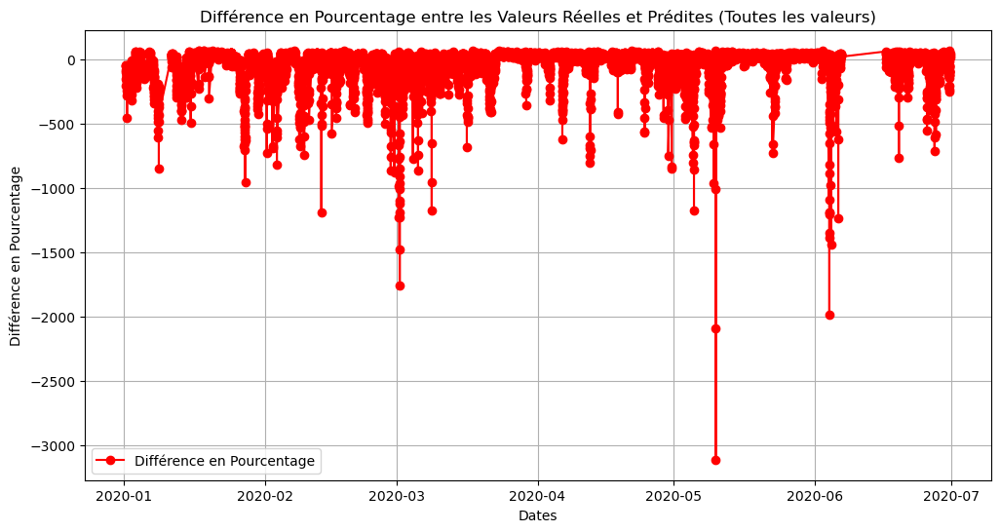

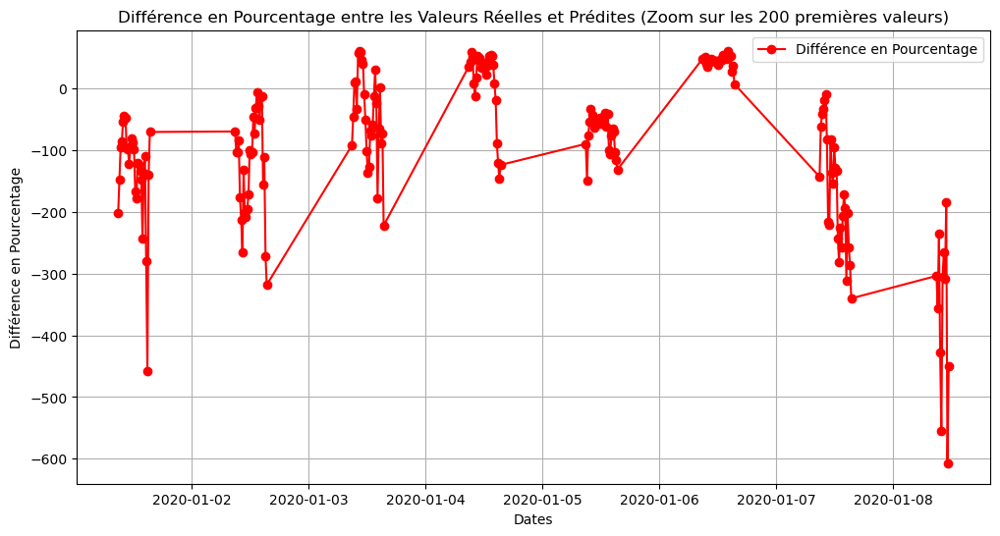

In [119]:
rfm=RandomForestRegressor()
data_rfm=model_fit_prediction(df_train_mean,df_test_mean,rfm)
evaluate_algo(rfm,data_rfm[3],data_rfm[4])
scatter_test_pred_density(data_rfm[3],data_rfm[4])
features_importance(data_rfm[5], data_rfm[0])
all_test_pred_graph(data_rfm[3],data_rfm[4])

### With skew, mean and std Arpege

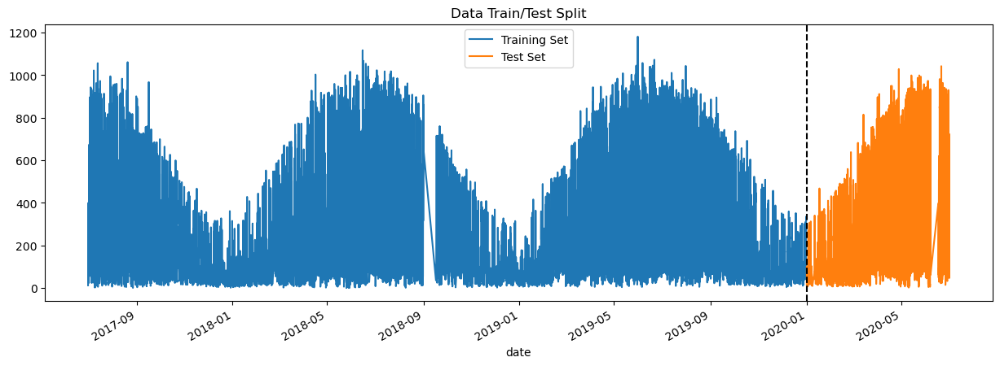

In [80]:
df_train_mean = df.loc[df.index<'01-01-2020'][columns_selection([],skewness=True,stat_Arpege=True)]
df_test_mean = df.loc[df.index >= '01-01-2020'][columns_selection([],skewness=True,stat_Arpege=True)]
columns_to_drop = ['Wreg_1.0', 'Wreg_2.0', 'Wreg_3.0', 'Wreg_4.0']
df_train_mean=df_train_mean.drop(columns=columns_to_drop)
df_test_mean=df_test_mean.drop(columns=columns_to_drop)
fig, ax = plt.subplots(figsize=(15, 5))
df_train_mean['Sirta_GHI'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
df_test_mean['Sirta_GHI'].plot(ax=ax, label='Test Set')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

In [82]:
df_train_mean.columns

Index(['Sirta_GHI', 'Clearsky_GHI', 'Arpege_GHI', 'SZA', 'Sirta_GHI_T0-1j',
       'Monthly_std_Arpege_GHI', 'Seasonly_std_Arpege_GHI',
       'Monthly_mean_Arpege_GHI', 'Seasonly_mean_Arpege_GHI',
       'Monthly_skew_Arpege_GHI', 'Seasonly_skew_Arpege_GHI'],
      dtype='object')

RandomForestRegressor()
MSE: 15335.507812003836
MAE: 92.7134040453196
R-squared: 0.7802282263989331
Distance DTW: 596200.301177722


C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

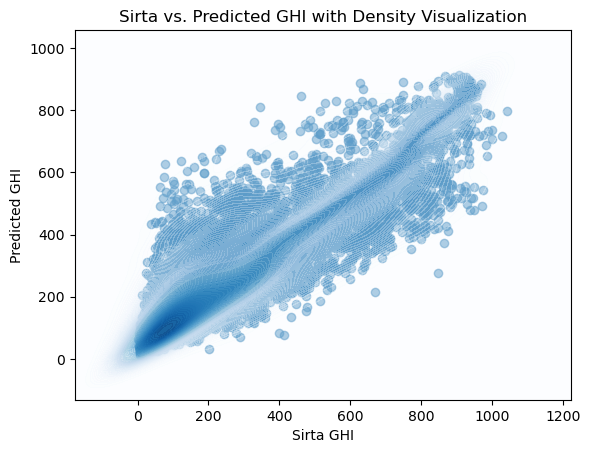

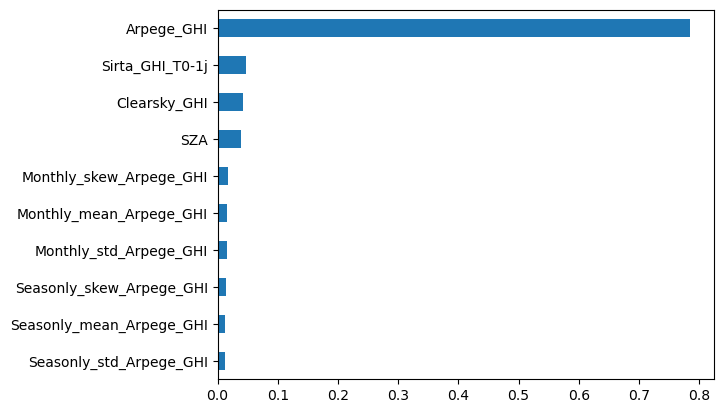

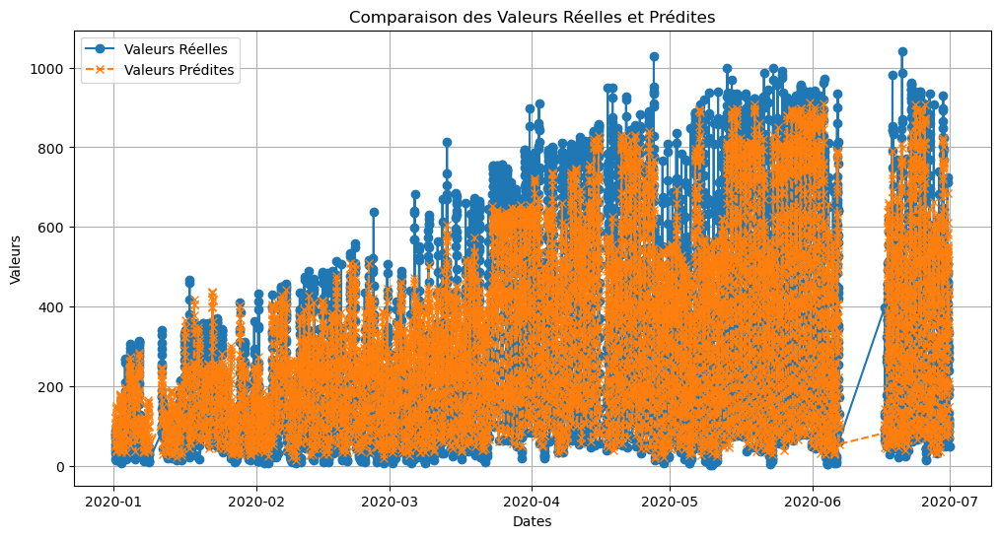

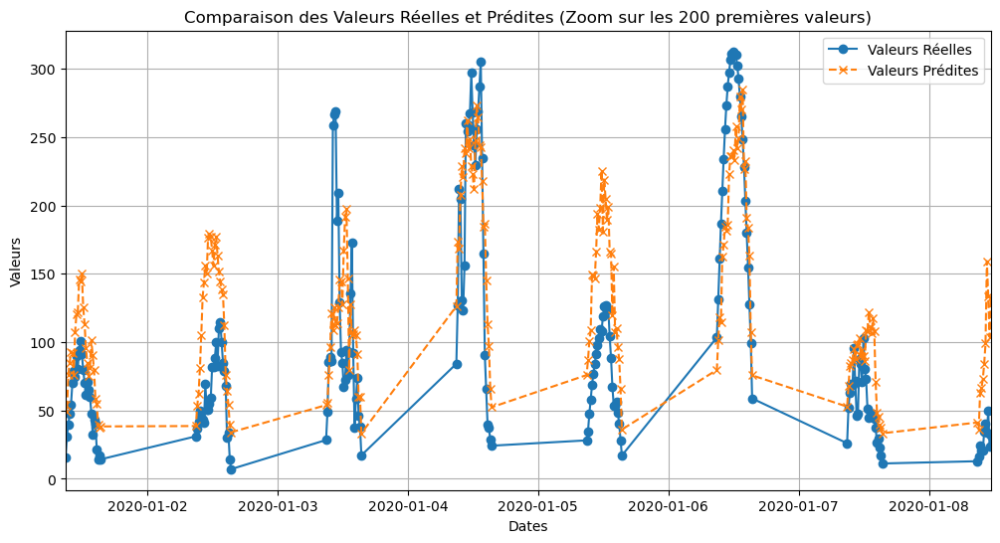

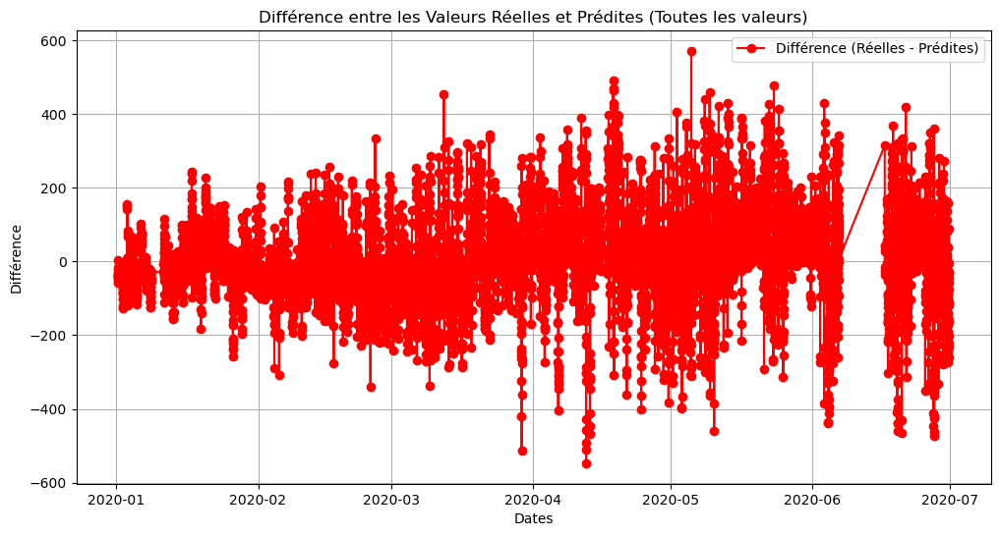

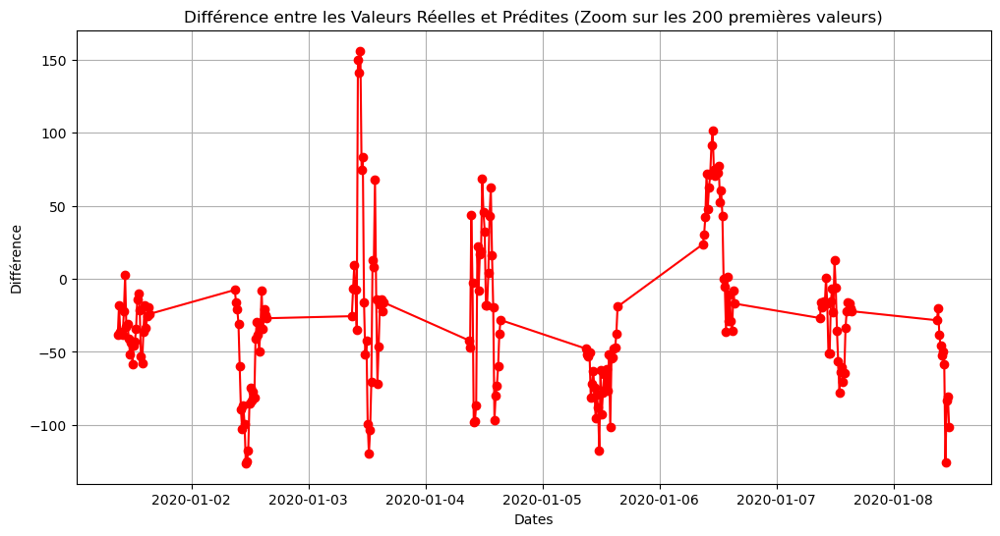

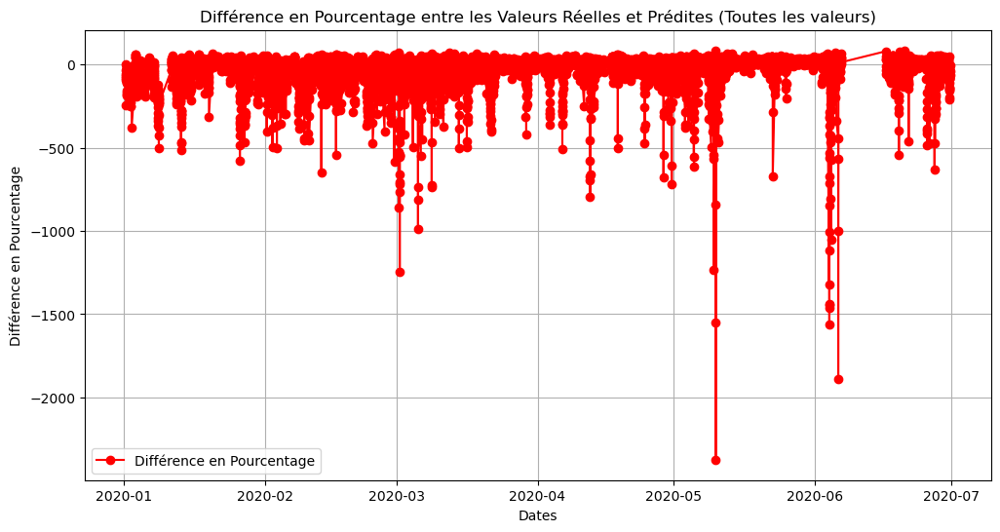

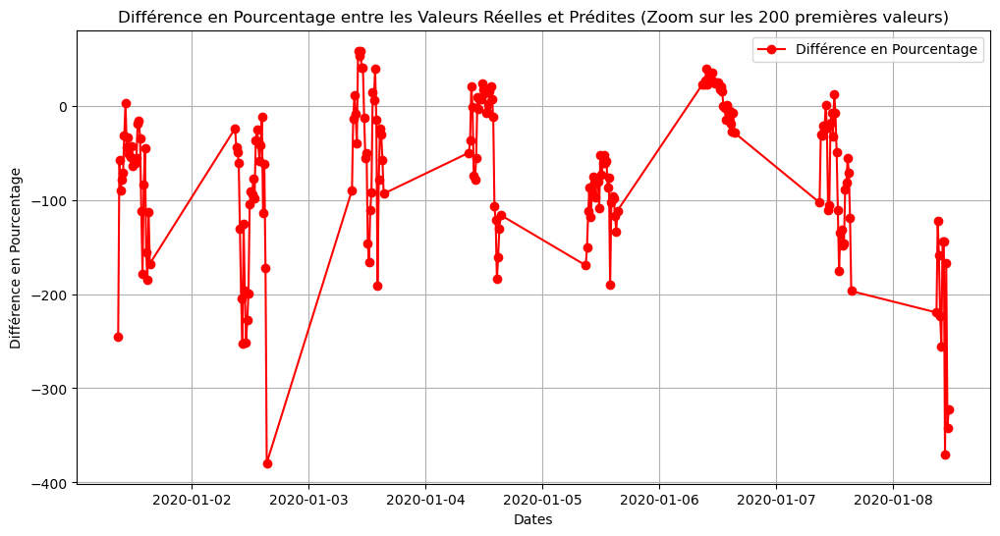

In [83]:
rfm=RandomForestRegressor()
data_rfm=model_fit_prediction(df_train_mean,df_test_mean,rfm)
evaluate_algo(rfm,data_rfm[3],data_rfm[4])
scatter_test_pred_density(data_rfm[3],data_rfm[4])
features_importance(data_rfm[5], data_rfm[0])
all_test_pred_graph(data_rfm[3],data_rfm[4])

## Kurtosis
Kurtosis is a statistical measure that describes the "tailedness" of the probability distribution of a real-valued random variable. It quantifies whether the tails of the distribution are heavier or lighter than those of a normal distribution.

In [95]:
df['kurtosis_Arpege_GHI']=df['Arpege_GHI'].kurtosis()

In [113]:
columns=columns_selection([],skewness=True,stat_Arpege=True)

In [114]:
columns.append('kurtosis_Arpege_GHI')

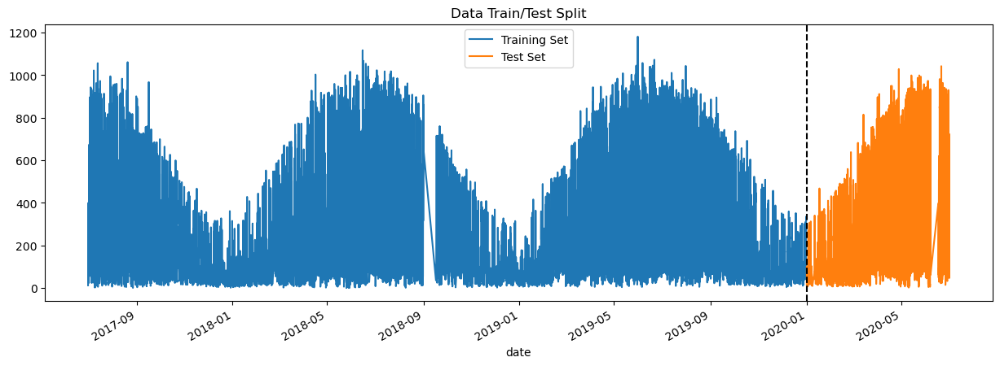

In [116]:
df_train_mean = df.loc[df.index<'01-01-2020'][columns]
df_test_mean = df.loc[df.index >= '01-01-2020'][columns]
columns_to_drop = ['Wreg_1.0', 'Wreg_2.0', 'Wreg_3.0', 'Wreg_4.0']
df_train_mean=df_train_mean.drop(columns=columns_to_drop)
df_test_mean=df_test_mean.drop(columns=columns_to_drop)
fig, ax = plt.subplots(figsize=(15, 5))
df_train_mean['Sirta_GHI'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
df_test_mean['Sirta_GHI'].plot(ax=ax, label='Test Set')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

RandomForestRegressor()
MSE: 15172.61610840472
MAE: 92.60179416704003
R-squared: 0.7825626126510046
Distance DTW: 544873.9527240396


C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.opti

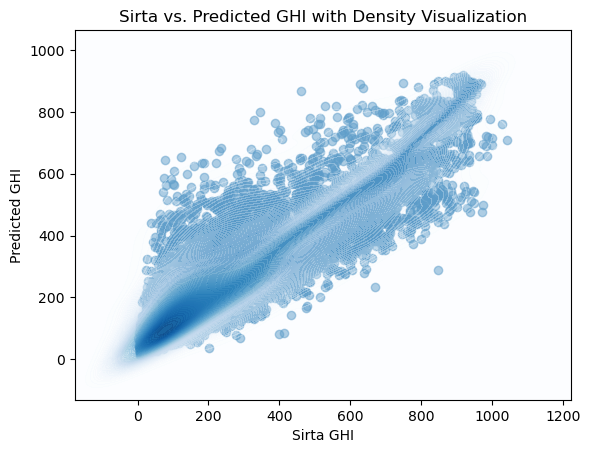

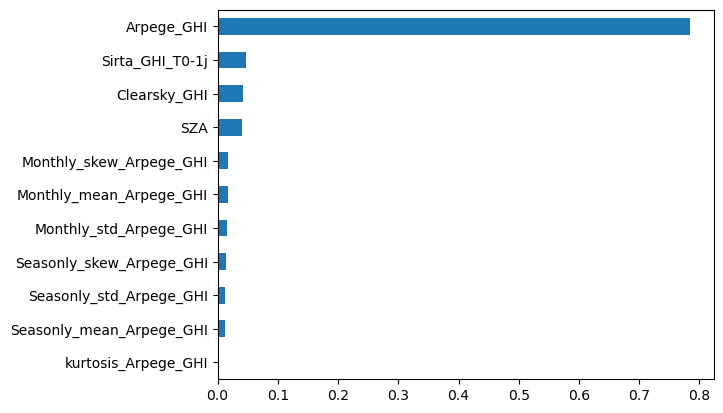

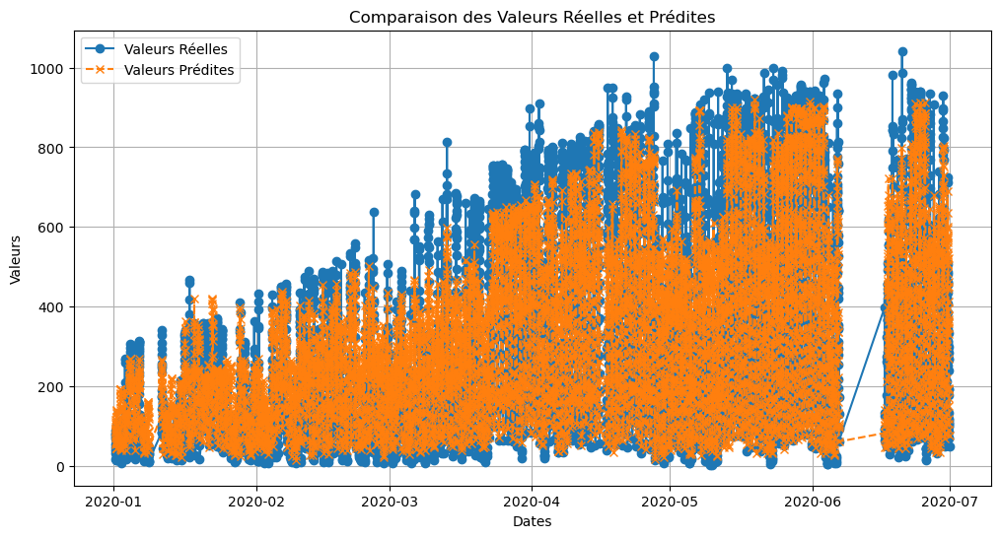

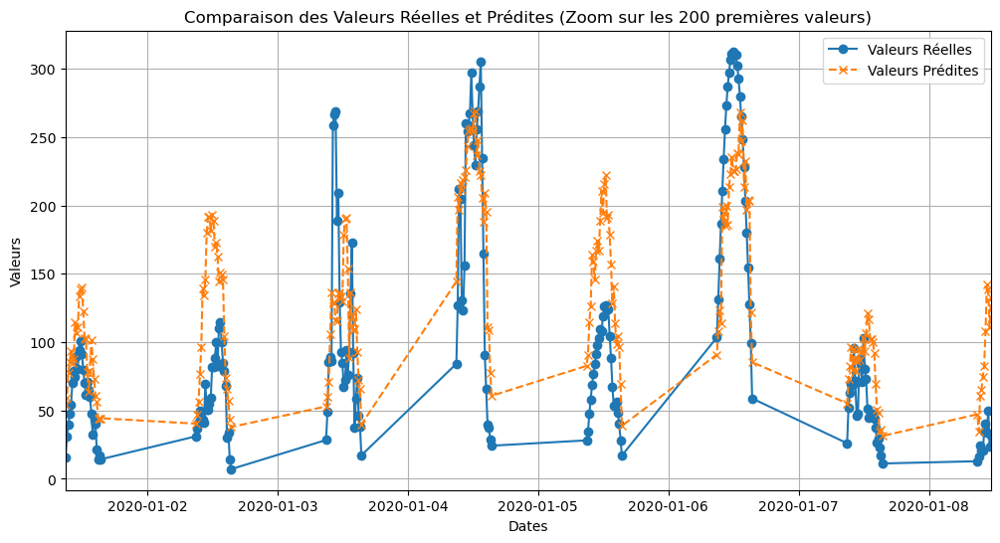

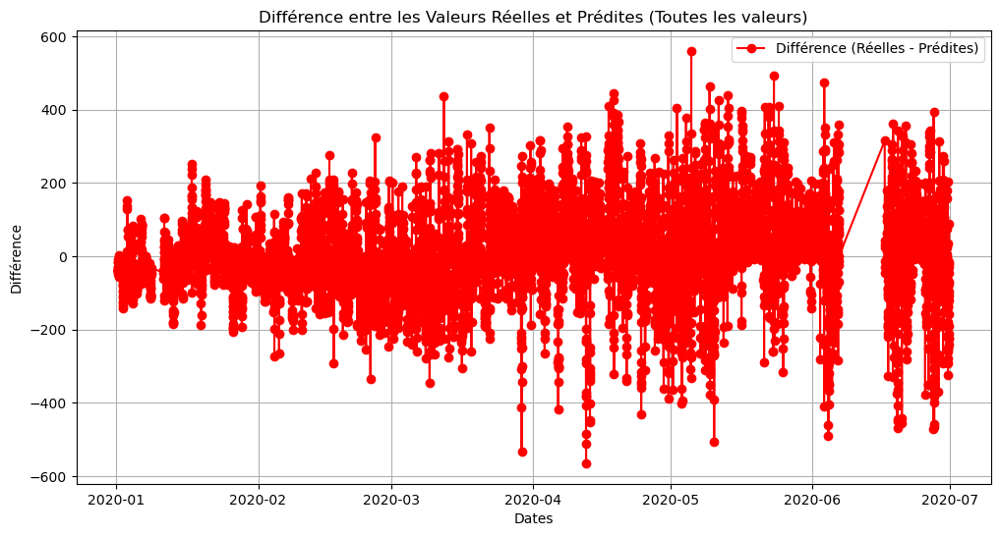

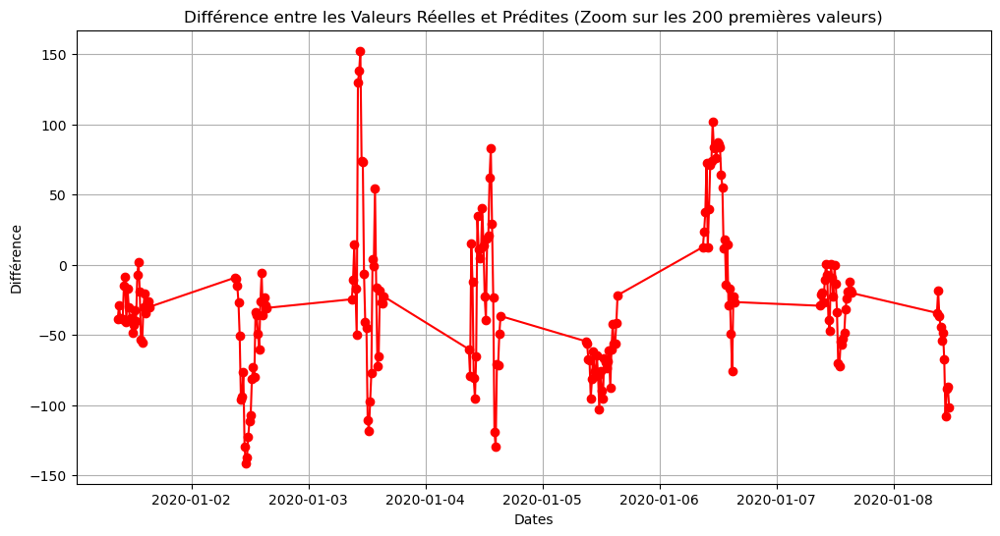

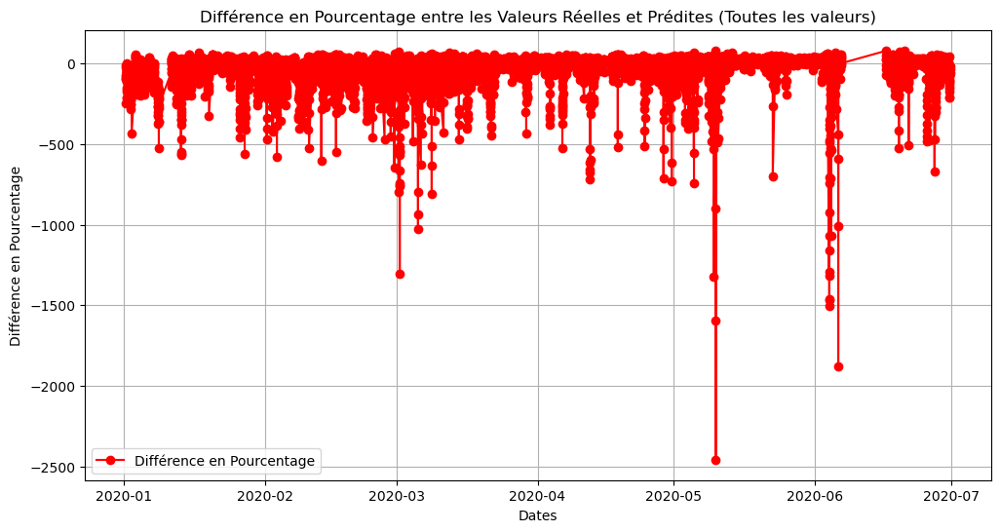

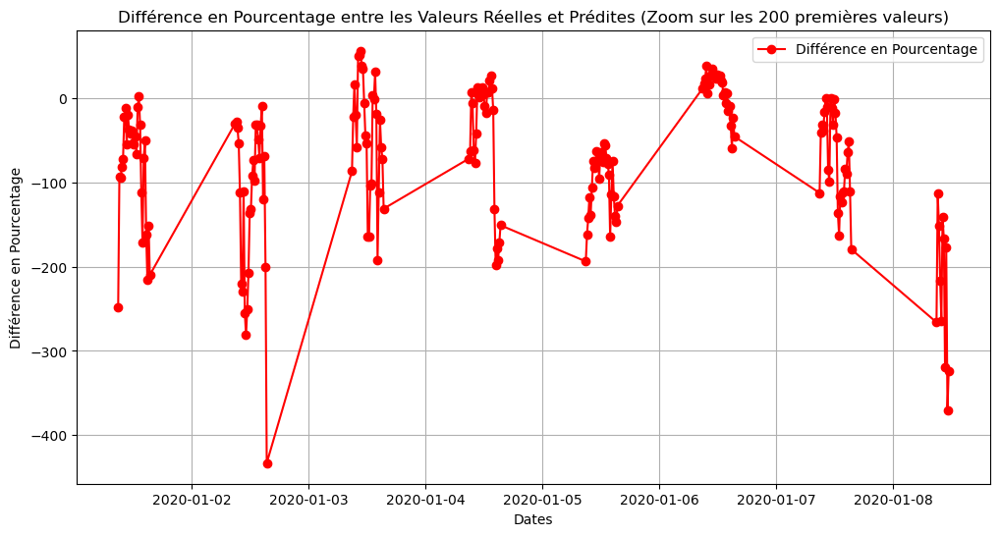

In [117]:
rfm=RandomForestRegressor()
data_rfm=model_fit_prediction(df_train_mean,df_test_mean,rfm)
evaluate_algo(rfm,data_rfm[3],data_rfm[4])
scatter_test_pred_density(data_rfm[3],data_rfm[4])
features_importance(data_rfm[5], data_rfm[0])
all_test_pred_graph(data_rfm[3],data_rfm[4])

As conclusion we can say that statistics variables did not significally improve our model. We could try statistical model made for time series prediction such as ARIMA. If it does not work we would be able to put aside the statistical approach for now.